In [1]:
from keras.models import Model
from keras.layers import Input
from keras.optimizers import *
from keras.datasets import mnist
from functools import partial

import matplotlib.pyplot as plt
%matplotlib inline

import numpy as np

# Local imports
from unet import unet_cell, LEAKY_RELU_ALPHA, BATCH_NORM_MOMENTUM
from builders import build_upscaler, build_upscaler_v2, build_discriminator
from utils import reduce_resolution

batch_size = 20
n_channels = 3
GRADIENT_PENALTY_WEIGHT = 10
import WGAN_utils
from WGAN_utils import wasserstein_loss, gradient_penalty_loss, RandomWeightedAverage
WGAN_utils.batch_size=batch_size
# WGAN_utils.n_channels=n_channels

Using TensorFlow backend.


In [4]:
# Define inputs
low_res_input = Input(shape=(None, None, n_channels))
# TODO: dimensions of low_res_input should probably be divisible 
# by 2**{num_layers}
high_res_input = Input(shape=(None, None, n_channels)) # This should really have dimensions twice that of low_res_input

# Build upscaler / discriminator
upscaler = build_upscaler_v2(
    low_res_input, 
#     num_filters_in_layer=[16, 32, 64, 128],
#     num_cells_in_layer=[3, 3, 3, 3],
#     n_channels_output=n_channels, 
    activation_string='tanh',
    output_size=(128, 128),
    resize_method='nearest_neighbor',
    align_corners=True,
#     num_filters_in_layer=[16, 32, 64, 32],
#     num_cells_in_layer=[3, 3, 3, 3],
    bottleneck_before_concat=True)
preliminary_discriminator = build_discriminator(low_res_input, high_res_input, 
                                                num_filters_in_layer=[16, 32, 64, 128],
                                                num_cells_in_layer=[3, 3, 3, 3],
                                                use_batch_norm=False, 
                                                activation_in_final_layer=False, 
                                                num_units_in_dense_layer=[1024]) # Use default parameters


# Define optimizers and compile models
upscaler_optimizer = Adam(0.0001, beta_1=0.5, beta_2=0.9)
upscaler.compile(loss='binary_crossentropy', 
                 optimizer=upscaler_optimizer)

# Defines the forward pass for the discriminator.  This will be used for the combined
# model when training the generator, but the gradient loss function still has to
# be defined so it can be used in training the discriminator.  This model will
# be used to calculate the gradient loss and so has to be compiled now.
discriminator_optimizer = Adam(0.0001, beta_1=0.5, beta_2=0.9)
preliminary_discriminator.compile(loss='binary_crossentropy', 
                      optimizer=discriminator_optimizer, 
                      metrics=['accuracy'])

# We will compile the discriminator model before the combined model for the generator
# so the generator's weights should be frozen.
preliminary_discriminator.trainable = True
upscaler.trainable = False

# We need sample images produced by the generator and so that we can take a weighted
# average of the generated images and the real images to stochastically determine the
# effective gradients by passing this weighted average through the discriminator. We
# also use the inputs and outputs defined here to define the full discriminator model.
generator_input = Input(shape=(None, None, n_channels))
generated_samples = upscaler(generator_input)
discriminator_output_from_generator = preliminary_discriminator([generator_input, generated_samples])

low_res_input_for_discriminator = Input(shape=(None, None, n_channels))
real_samples = Input(shape=(None, None, n_channels))
discriminator_output_from_real_samples = preliminary_discriminator([low_res_input_for_discriminator, real_samples])

# We also need to generate weighted-averages of real and generated samples, to use for the gradient norm penalty.
averaged_samples = RandomWeightedAverage()([real_samples, generated_samples])
# We then run these samples through the discriminator as well. Note that we never really use the discriminator
# output for these samples - we're only running them to get the gradient norm for the gradient penalty loss.
averaged_samples_out = preliminary_discriminator([generator_input, averaged_samples])

# The gradient penalty loss function requires the input averaged samples to get gradients. However,
# Keras loss functions can only have two arguments, y_true and y_pred. We get around this by making a partial()
# of the function with the averaged samples here.
partial_gp_loss = partial(gradient_penalty_loss,
                          averaged_samples=averaged_samples,
                          gradient_penalty_weight=GRADIENT_PENALTY_WEIGHT)
partial_gp_loss.__name__ = 'gradient_penalty'  # Functions need names or Keras will throw an error

# Define model and compile it
discriminator = Model(inputs=[generator_input, low_res_input_for_discriminator, real_samples],
                            outputs=[discriminator_output_from_generator,
                                     discriminator_output_from_real_samples,
                                     averaged_samples_out])

discriminator.compile(optimizer=discriminator_optimizer,
                            loss=[wasserstein_loss,
                                  wasserstein_loss,
                                  partial_gp_loss], 
                      metrics = None)

# Freeze the discriminator weights and allow the generator to train
preliminary_discriminator.trainable = False
upscaler.trainable = True

# Define the input and output of the combined model.
low_res_input_for_combined_model = Input(shape=(None, None, n_channels))
upscaled_imgs = upscaler(low_res_input_for_combined_model)
valid = preliminary_discriminator([low_res_input_for_combined_model, upscaled_imgs])

# The combined model  (stacked upscaler and discriminator) takes
# low-res image as input and returns an upsampled image from the 
# upscaler and a validity score given by the discriminator
combined = Model(low_res_input_for_combined_model, [valid, upscaled_imgs])
combined.compile(loss=[wasserstein_loss, 'mean_squared_error'], 
                 optimizer=upscaler_optimizer, 
                 metrics = None)
# Notice: the combined model was compiled *after* freezing the discriminator's weights

print('combined summary')
combined.summary()
print('discriminator summary')
discriminator.summary()
print('preliminary_discriminator summary')
preliminary_discriminator.summary()
print('upscaler summary')
upscaler.summary()
print(discriminator.metrics_names)
print(combined.metrics_names)

combined summary
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            (None, None, None, 3 0                                            
__________________________________________________________________________________________________
model_1 (Model)                 (None, 128, 128, 3)  116398      input_6[0][0]                    
__________________________________________________________________________________________________
model_2 (Model)                 (None, 1)            623153      input_6[0][0]                    
                                                                 model_1[2][0]                    
Total params: 739,551
Trainable params: 115,568
Non-trainable params: 623,983
__________________________________________________________________________________________________
discriminator 

C:\Users\Daniel\Anaconda3\lib\site-packages\keras\engine\training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


In [5]:
import os
import cv2
path = "./data/conditioned_faces_final/"

def extract_image_sizes(directories):
    sizes = []
    for directory in directories:
        sizes.append(int(directory.split('x')[0]))
    return sizes
dirs = os.listdir(path)
image_sizes = extract_image_sizes(dirs)
print(dirs)
print(image_sizes)
im_names = []
for d in dirs:
    im_names.append(os.listdir(path + d))

for i, d in enumerate(im_names):
    print("%s (index %d) length: %d" % (dirs[i], i, len(d)))
c = 0
def load_batch(path2, filenames, indices):
    batch = []
    c = 0
    for i in indices:
        img = cv2.imread(path2 + filenames[i])
        batch.append(img)
        """
        if(c == 0):
            c += 1
            print(path + filenames[i])
            print(img.shape)
            plt.imshow(img)
            plt.show()
        """
    batch = (np.array(batch) / 127.5) - 1.0
    A, B, C, D = batch.shape
    e = B % 4
    f = C % 4
    return batch[:, :B-e, :C-f, :]
    
d = im_names[6]
batch_indices = np.random.randint(0, len(d), size=[batch_size])

path1 = path + dirs[6] + "/"

x_batch = load_batch(path1, d, batch_indices)



['100x100', '128x128', '180x180', '256x256', '310x310', '360x360', '410x410', '480x480', '530x530', '55x55', '590x590', '650x650', '700x700', '70x70', '86x86']
[100, 128, 180, 256, 310, 360, 410, 480, 530, 55, 590, 650, 700, 70, 86]
100x100 (index 0) length: 7119
128x128 (index 1) length: 12614
180x180 (index 2) length: 9567
256x256 (index 3) length: 3706
310x310 (index 4) length: 2384
360x360 (index 5) length: 925
410x410 (index 6) length: 443
480x480 (index 7) length: 282
530x530 (index 8) length: 91
55x55 (index 9) length: 8052
590x590 (index 10) length: 17
650x650 (index 11) length: 11
700x700 (index 12) length: 2
70x70 (index 13) length: 7654
86x86 (index 14) length: 7821


In [10]:
# Define training parameters
train_steps = 10000
print_every_n_steps = 20
print_results = True
plot_results = True
repeat_discriminator_training_n_times = 1
# batch_size defined in first cell

# Create a dictionary for storing training metrics over time
training_metrics = {
    'step': [],
    'd_total_loss': [],
    'd_w_fake_loss': [],
    'd_w_real_loss': [],
    'd_grad_loss': [],
    'g_total_loss': [], 
    'g_w_loss': [], 
    'g_MSE_loss': []
}

# We make three label vectors for training. positive_y is the label vector for real samples, with value 1.
# negative_y is the label vector for generated samples, with value -1. The dummy_y vector is passed to the
# gradient_penalty loss function and is not used.
positive_y = np.ones((batch_size, 1), dtype=np.float32)
negative_y = -positive_y
dummy_y = np.zeros((batch_size, 1), dtype=np.float32)

C:\Users\Daniel\Anaconda3\lib\site-packages\keras\engine\training.py:490: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


Step 20:
    [D losses: Total=-0.078331, Wass_fake=-0.221947, Wass_real=0.137903, Wass_grad=0.005712]
    [G losses: Total=0.168779, Wass=0.163506, MSE=0.005273]


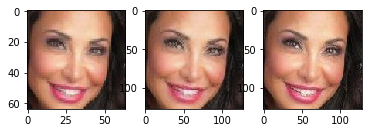

Step 40:
    [D losses: Total=-0.053951, Wass_fake=-0.189539, Wass_real=0.134584, Wass_grad=0.001004]
    [G losses: Total=0.195857, Wass=0.188918, MSE=0.006939]


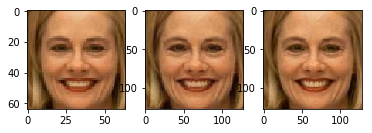

Step 60:
    [D losses: Total=-0.033501, Wass_fake=-0.155240, Wass_real=0.118990, Wass_grad=0.002749]
    [G losses: Total=0.172313, Wass=0.166271, MSE=0.006042]


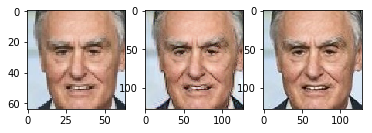

Step 80:
    [D losses: Total=-0.073574, Wass_fake=-0.199915, Wass_real=0.123545, Wass_grad=0.002796]
    [G losses: Total=0.204474, Wass=0.194561, MSE=0.009912]


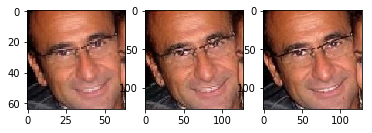

Step 100:
    [D losses: Total=-0.028443, Wass_fake=-0.160732, Wass_real=0.123786, Wass_grad=0.008504]
    [G losses: Total=0.190802, Wass=0.182987, MSE=0.007815]


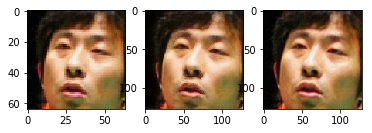

Step 120:
    [D losses: Total=-0.043797, Wass_fake=-0.176394, Wass_real=0.126167, Wass_grad=0.006430]
    [G losses: Total=0.190533, Wass=0.185032, MSE=0.005501]


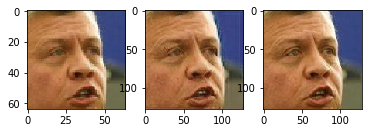

Step 140:
    [D losses: Total=-0.046129, Wass_fake=-0.183057, Wass_real=0.131251, Wass_grad=0.005677]
    [G losses: Total=0.185720, Wass=0.179004, MSE=0.006717]


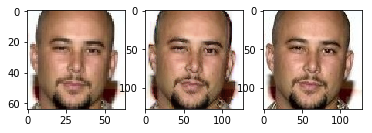

Step 160:
    [D losses: Total=-0.032215, Wass_fake=-0.171333, Wass_real=0.135714, Wass_grad=0.003405]
    [G losses: Total=0.185180, Wass=0.177435, MSE=0.007745]


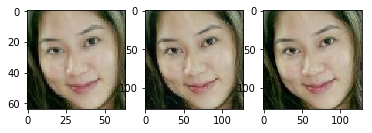

Step 180:
    [D losses: Total=-0.049451, Wass_fake=-0.171699, Wass_real=0.119611, Wass_grad=0.002636]
    [G losses: Total=0.170000, Wass=0.162831, MSE=0.007168]


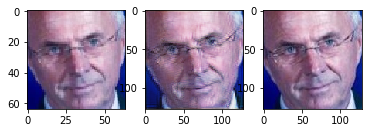

Step 200:
    [D losses: Total=-0.053453, Wass_fake=-0.195132, Wass_real=0.139267, Wass_grad=0.002411]
    [G losses: Total=0.225019, Wass=0.216476, MSE=0.008543]


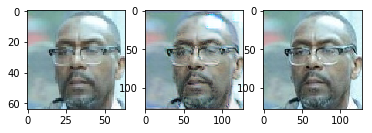

Step 220:
    [D losses: Total=-0.042861, Wass_fake=-0.169282, Wass_real=0.123207, Wass_grad=0.003215]
    [G losses: Total=0.180948, Wass=0.173677, MSE=0.007272]


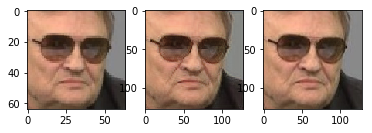

Step 240:
    [D losses: Total=-0.036092, Wass_fake=-0.158178, Wass_real=0.120943, Wass_grad=0.001143]
    [G losses: Total=0.172123, Wass=0.165171, MSE=0.006952]


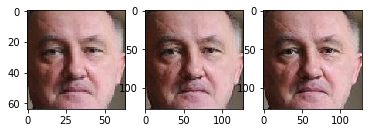

Step 260:
    [D losses: Total=-0.033058, Wass_fake=-0.154839, Wass_real=0.119377, Wass_grad=0.002404]
    [G losses: Total=0.179791, Wass=0.172815, MSE=0.006976]


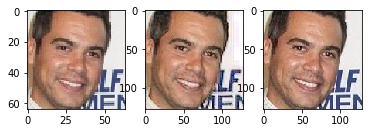

Step 280:
    [D losses: Total=-0.067442, Wass_fake=-0.201721, Wass_real=0.133786, Wass_grad=0.000493]
    [G losses: Total=0.182277, Wass=0.174438, MSE=0.007839]


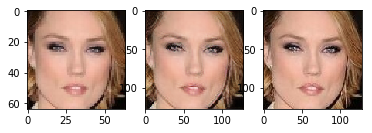

Step 300:
    [D losses: Total=-0.032930, Wass_fake=-0.167840, Wass_real=0.129962, Wass_grad=0.004948]
    [G losses: Total=0.182856, Wass=0.176460, MSE=0.006396]


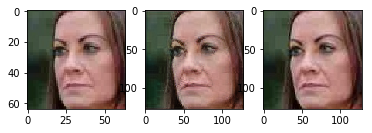

Step 320:
    [D losses: Total=-0.042031, Wass_fake=-0.164621, Wass_real=0.121845, Wass_grad=0.000745]
    [G losses: Total=0.175063, Wass=0.168702, MSE=0.006361]


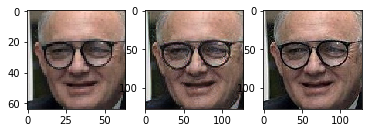

Step 340:
    [D losses: Total=-0.042191, Wass_fake=-0.170734, Wass_real=0.127388, Wass_grad=0.001155]
    [G losses: Total=0.181197, Wass=0.175376, MSE=0.005821]


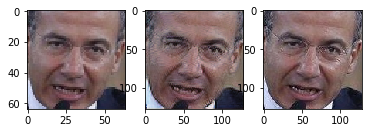

Step 360:
    [D losses: Total=-0.044469, Wass_fake=-0.170472, Wass_real=0.123072, Wass_grad=0.002930]
    [G losses: Total=0.184552, Wass=0.177457, MSE=0.007095]


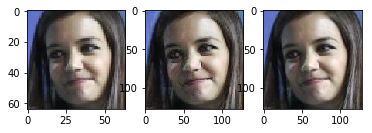

Step 380:
    [D losses: Total=-0.046381, Wass_fake=-0.173070, Wass_real=0.125539, Wass_grad=0.001150]
    [G losses: Total=0.169521, Wass=0.162281, MSE=0.007240]


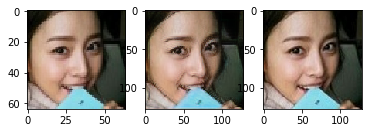

Step 400:
    [D losses: Total=-0.041455, Wass_fake=-0.166693, Wass_real=0.122093, Wass_grad=0.003145]
    [G losses: Total=0.179072, Wass=0.171915, MSE=0.007157]


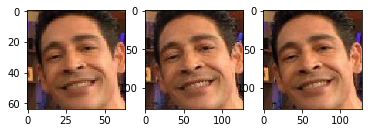

Step 420:
    [D losses: Total=-0.037098, Wass_fake=-0.172778, Wass_real=0.133001, Wass_grad=0.002678]
    [G losses: Total=0.181634, Wass=0.174951, MSE=0.006682]


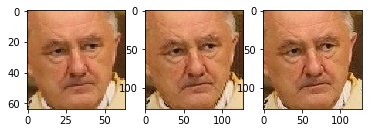

Step 440:
    [D losses: Total=-0.044345, Wass_fake=-0.171551, Wass_real=0.125941, Wass_grad=0.001264]
    [G losses: Total=0.166760, Wass=0.160318, MSE=0.006442]


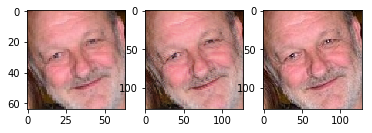

Step 460:
    [D losses: Total=-0.038628, Wass_fake=-0.178680, Wass_real=0.137383, Wass_grad=0.002669]
    [G losses: Total=0.174426, Wass=0.168755, MSE=0.005670]


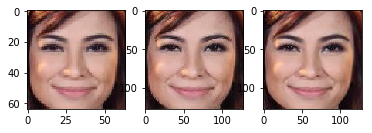

Step 480:
    [D losses: Total=-0.055843, Wass_fake=-0.178997, Wass_real=0.121230, Wass_grad=0.001924]
    [G losses: Total=0.168432, Wass=0.162430, MSE=0.006002]


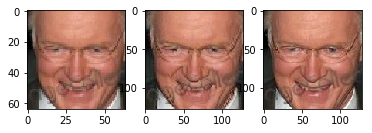

Step 500:
    [D losses: Total=-0.052366, Wass_fake=-0.189575, Wass_real=0.130910, Wass_grad=0.006299]
    [G losses: Total=0.183187, Wass=0.173949, MSE=0.009239]


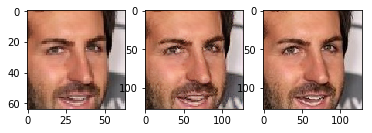

Step 520:
    [D losses: Total=-0.055507, Wass_fake=-0.204027, Wass_real=0.141809, Wass_grad=0.006710]
    [G losses: Total=0.172755, Wass=0.166486, MSE=0.006270]


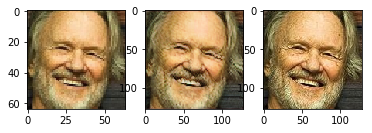

Step 540:
    [D losses: Total=-0.034011, Wass_fake=-0.180759, Wass_real=0.136928, Wass_grad=0.009820]
    [G losses: Total=0.175111, Wass=0.166984, MSE=0.008127]


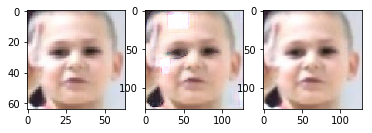

Step 560:
    [D losses: Total=-0.061387, Wass_fake=-0.192225, Wass_real=0.118525, Wass_grad=0.012312]
    [G losses: Total=0.185462, Wass=0.177428, MSE=0.008034]


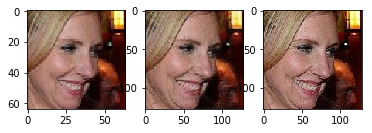

Step 580:
    [D losses: Total=-0.038839, Wass_fake=-0.166807, Wass_real=0.125564, Wass_grad=0.002404]
    [G losses: Total=0.183876, Wass=0.177048, MSE=0.006828]


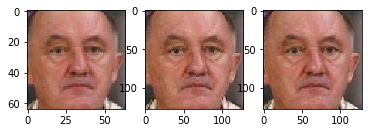

Step 600:
    [D losses: Total=-0.033726, Wass_fake=-0.176393, Wass_real=0.138900, Wass_grad=0.003767]
    [G losses: Total=0.173922, Wass=0.168054, MSE=0.005869]


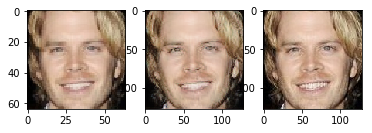

Step 620:
    [D losses: Total=-0.037181, Wass_fake=-0.169324, Wass_real=0.127751, Wass_grad=0.004392]
    [G losses: Total=0.179610, Wass=0.172005, MSE=0.007606]


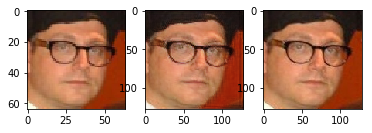

Step 640:
    [D losses: Total=-0.062566, Wass_fake=-0.198326, Wass_real=0.132850, Wass_grad=0.002909]
    [G losses: Total=0.222924, Wass=0.213039, MSE=0.009884]


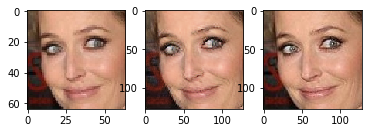

Step 660:
    [D losses: Total=-0.040973, Wass_fake=-0.169547, Wass_real=0.127881, Wass_grad=0.000693]
    [G losses: Total=0.191599, Wass=0.182213, MSE=0.009386]


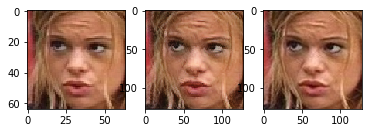

Step 680:
    [D losses: Total=-0.040942, Wass_fake=-0.171454, Wass_real=0.127753, Wass_grad=0.002759]
    [G losses: Total=0.170367, Wass=0.164858, MSE=0.005510]


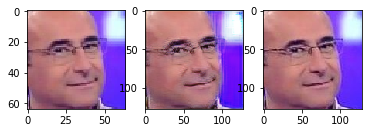

Step 700:
    [D losses: Total=-0.041289, Wass_fake=-0.166305, Wass_real=0.113637, Wass_grad=0.011378]
    [G losses: Total=0.175896, Wass=0.168677, MSE=0.007219]


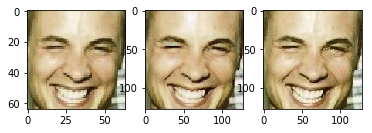

Step 720:
    [D losses: Total=-0.037075, Wass_fake=-0.177903, Wass_real=0.131054, Wass_grad=0.009774]
    [G losses: Total=0.171971, Wass=0.162934, MSE=0.009036]


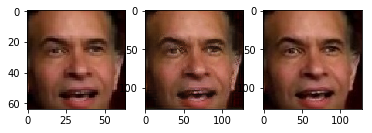

Step 740:
    [D losses: Total=-0.039425, Wass_fake=-0.174399, Wass_real=0.133928, Wass_grad=0.001046]
    [G losses: Total=0.179501, Wass=0.173678, MSE=0.005823]


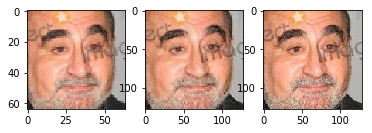

Step 760:
    [D losses: Total=-0.053246, Wass_fake=-0.190435, Wass_real=0.136575, Wass_grad=0.000613]
    [G losses: Total=0.178375, Wass=0.171372, MSE=0.007003]


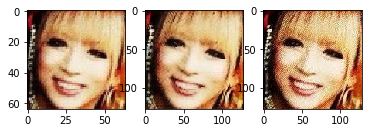

Step 780:
    [D losses: Total=-0.037977, Wass_fake=-0.153909, Wass_real=0.113240, Wass_grad=0.002692]
    [G losses: Total=0.151281, Wass=0.144634, MSE=0.006647]


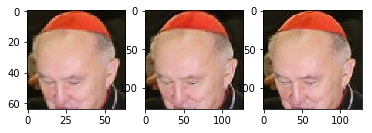

Step 800:
    [D losses: Total=-0.066635, Wass_fake=-0.189146, Wass_real=0.119054, Wass_grad=0.003457]
    [G losses: Total=0.165011, Wass=0.159947, MSE=0.005064]


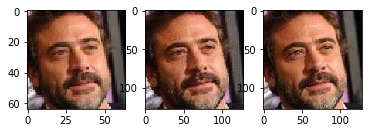

Step 820:
    [D losses: Total=-0.035556, Wass_fake=-0.157835, Wass_real=0.116668, Wass_grad=0.005611]
    [G losses: Total=0.184778, Wass=0.177420, MSE=0.007358]


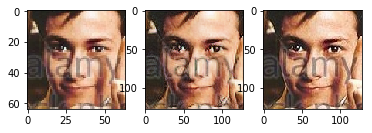

Step 840:
    [D losses: Total=-0.034153, Wass_fake=-0.170542, Wass_real=0.133180, Wass_grad=0.003208]
    [G losses: Total=0.200444, Wass=0.193691, MSE=0.006754]


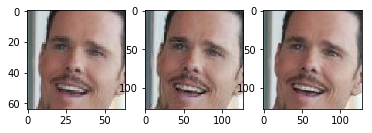

Step 860:
    [D losses: Total=-0.038032, Wass_fake=-0.161929, Wass_real=0.121434, Wass_grad=0.002462]
    [G losses: Total=0.174232, Wass=0.167258, MSE=0.006974]


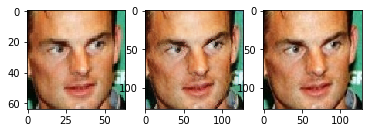

Step 880:
    [D losses: Total=-0.043157, Wass_fake=-0.183468, Wass_real=0.133975, Wass_grad=0.006336]
    [G losses: Total=0.186924, Wass=0.179904, MSE=0.007020]


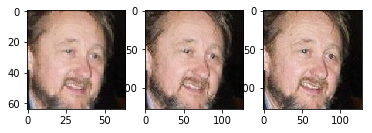

Step 900:
    [D losses: Total=-0.041245, Wass_fake=-0.176156, Wass_real=0.132904, Wass_grad=0.002006]
    [G losses: Total=0.186160, Wass=0.178247, MSE=0.007914]


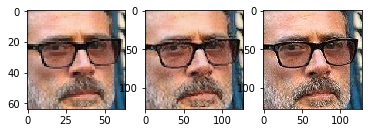

Step 920:
    [D losses: Total=-0.036211, Wass_fake=-0.153623, Wass_real=0.114304, Wass_grad=0.003107]
    [G losses: Total=0.191552, Wass=0.182225, MSE=0.009327]


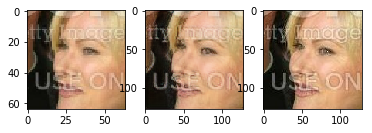

Step 940:
    [D losses: Total=-0.046396, Wass_fake=-0.177567, Wass_real=0.129582, Wass_grad=0.001589]
    [G losses: Total=0.207233, Wass=0.198463, MSE=0.008770]


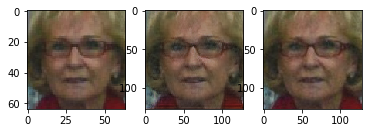

Step 960:
    [D losses: Total=-0.045652, Wass_fake=-0.189200, Wass_real=0.142268, Wass_grad=0.001280]
    [G losses: Total=0.199776, Wass=0.191307, MSE=0.008469]


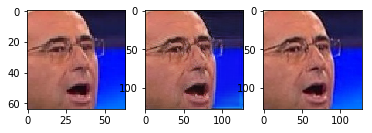

Step 980:
    [D losses: Total=-0.048729, Wass_fake=-0.176580, Wass_real=0.125935, Wass_grad=0.001915]
    [G losses: Total=0.176389, Wass=0.167802, MSE=0.008587]


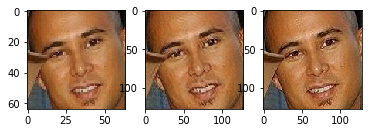

Step 1000:
    [D losses: Total=-0.047480, Wass_fake=-0.185243, Wass_real=0.133780, Wass_grad=0.003983]
    [G losses: Total=0.204473, Wass=0.196019, MSE=0.008454]


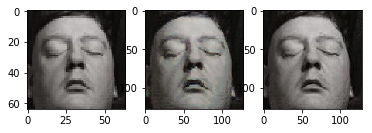

Step 1020:
    [D losses: Total=-0.046158, Wass_fake=-0.173901, Wass_real=0.124501, Wass_grad=0.003242]
    [G losses: Total=0.173630, Wass=0.167015, MSE=0.006615]


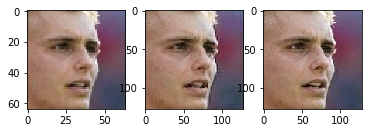

Step 1040:
    [D losses: Total=-0.058903, Wass_fake=-0.189042, Wass_real=0.127870, Wass_grad=0.002269]
    [G losses: Total=0.183136, Wass=0.175991, MSE=0.007145]


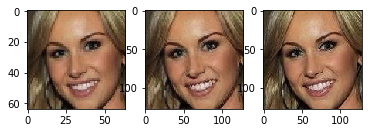

Step 1060:
    [D losses: Total=-0.034013, Wass_fake=-0.162129, Wass_real=0.124604, Wass_grad=0.003512]
    [G losses: Total=0.167692, Wass=0.161278, MSE=0.006413]


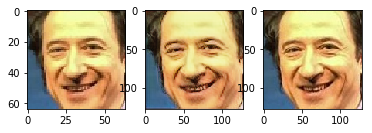

Step 1080:
    [D losses: Total=-0.042913, Wass_fake=-0.188571, Wass_real=0.141567, Wass_grad=0.004092]
    [G losses: Total=0.186688, Wass=0.179929, MSE=0.006759]


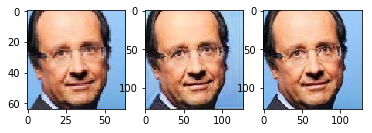

Step 1100:
    [D losses: Total=-0.035806, Wass_fake=-0.162144, Wass_real=0.122402, Wass_grad=0.003936]
    [G losses: Total=0.183921, Wass=0.177975, MSE=0.005946]


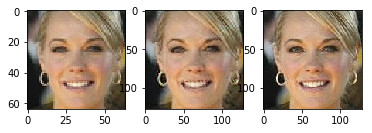

Step 1120:
    [D losses: Total=-0.039406, Wass_fake=-0.166993, Wass_real=0.123803, Wass_grad=0.003784]
    [G losses: Total=0.182943, Wass=0.175858, MSE=0.007085]


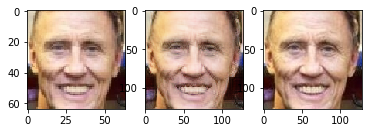

Step 1140:
    [D losses: Total=-0.031948, Wass_fake=-0.159958, Wass_real=0.126448, Wass_grad=0.001562]
    [G losses: Total=0.184114, Wass=0.176702, MSE=0.007412]


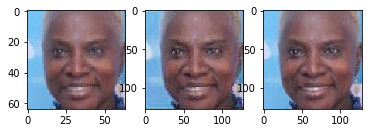

Step 1160:
    [D losses: Total=-0.042730, Wass_fake=-0.177292, Wass_real=0.132274, Wass_grad=0.002288]
    [G losses: Total=0.187811, Wass=0.182324, MSE=0.005487]


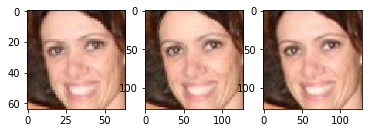

Step 1180:
    [D losses: Total=-0.038220, Wass_fake=-0.168905, Wass_real=0.128541, Wass_grad=0.002144]
    [G losses: Total=0.164896, Wass=0.157021, MSE=0.007875]


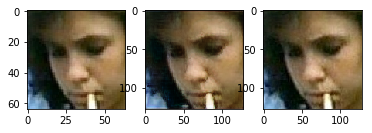

Step 1200:
    [D losses: Total=-0.034938, Wass_fake=-0.171077, Wass_real=0.131670, Wass_grad=0.004469]
    [G losses: Total=0.180208, Wass=0.172761, MSE=0.007446]


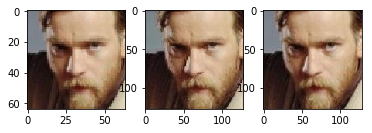

Step 1220:
    [D losses: Total=-0.059552, Wass_fake=-0.192153, Wass_real=0.130981, Wass_grad=0.001619]
    [G losses: Total=0.209959, Wass=0.200646, MSE=0.009313]


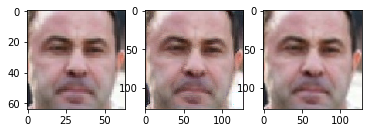

Step 1240:
    [D losses: Total=-0.042547, Wass_fake=-0.170442, Wass_real=0.126803, Wass_grad=0.001092]
    [G losses: Total=0.172165, Wass=0.166243, MSE=0.005922]


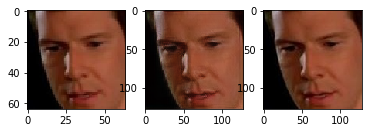

Step 1260:
    [D losses: Total=-0.037652, Wass_fake=-0.167746, Wass_real=0.128641, Wass_grad=0.001454]
    [G losses: Total=0.179275, Wass=0.171612, MSE=0.007664]


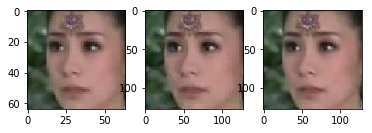

Step 1280:
    [D losses: Total=-0.057059, Wass_fake=-0.190282, Wass_real=0.132265, Wass_grad=0.000958]
    [G losses: Total=0.201337, Wass=0.194225, MSE=0.007113]


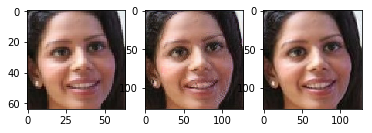

Step 1300:
    [D losses: Total=-0.034501, Wass_fake=-0.158963, Wass_real=0.114469, Wass_grad=0.009994]
    [G losses: Total=0.175242, Wass=0.167440, MSE=0.007803]


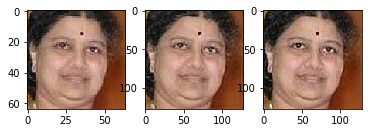

Step 1320:
    [D losses: Total=-0.037974, Wass_fake=-0.171532, Wass_real=0.131546, Wass_grad=0.002012]
    [G losses: Total=0.193077, Wass=0.186354, MSE=0.006723]


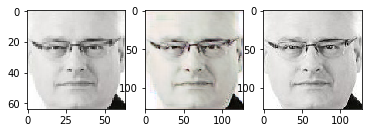

Step 1340:
    [D losses: Total=-0.051278, Wass_fake=-0.184589, Wass_real=0.132345, Wass_grad=0.000965]
    [G losses: Total=0.182187, Wass=0.175268, MSE=0.006919]


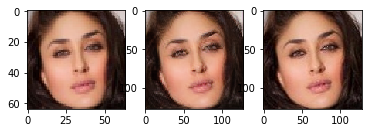

Step 1360:
    [D losses: Total=-0.039964, Wass_fake=-0.159927, Wass_real=0.117171, Wass_grad=0.002791]
    [G losses: Total=0.164213, Wass=0.157216, MSE=0.006997]


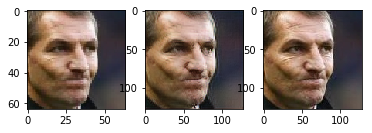

Step 1380:
    [D losses: Total=-0.044415, Wass_fake=-0.176928, Wass_real=0.128315, Wass_grad=0.004198]
    [G losses: Total=0.185889, Wass=0.178557, MSE=0.007332]


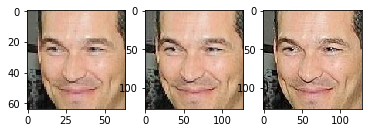

Step 1400:
    [D losses: Total=-0.054636, Wass_fake=-0.193379, Wass_real=0.132542, Wass_grad=0.006200]
    [G losses: Total=0.196033, Wass=0.188962, MSE=0.007071]


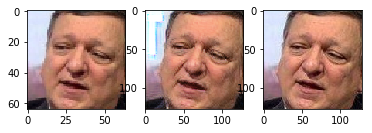

Step 1420:
    [D losses: Total=-0.039224, Wass_fake=-0.163494, Wass_real=0.122292, Wass_grad=0.001978]
    [G losses: Total=0.168680, Wass=0.162834, MSE=0.005846]


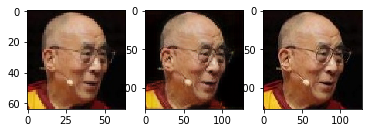

Step 1440:
    [D losses: Total=-0.034271, Wass_fake=-0.154173, Wass_real=0.117696, Wass_grad=0.002206]
    [G losses: Total=0.172154, Wass=0.163186, MSE=0.008968]


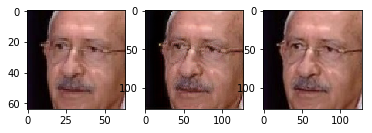

Step 1460:
    [D losses: Total=-0.044770, Wass_fake=-0.173696, Wass_real=0.117886, Wass_grad=0.011039]
    [G losses: Total=0.171880, Wass=0.165273, MSE=0.006607]


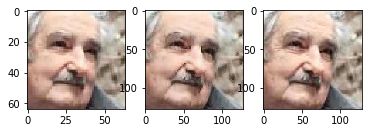

Step 1480:
    [D losses: Total=-0.037483, Wass_fake=-0.163050, Wass_real=0.123568, Wass_grad=0.001999]
    [G losses: Total=0.182754, Wass=0.176599, MSE=0.006155]


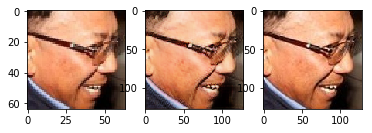

Step 1500:
    [D losses: Total=-0.039113, Wass_fake=-0.170157, Wass_real=0.126675, Wass_grad=0.004369]
    [G losses: Total=0.165390, Wass=0.158211, MSE=0.007178]


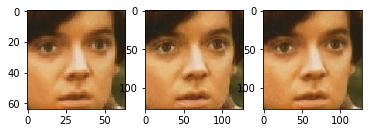

Step 1520:
    [D losses: Total=-0.062121, Wass_fake=-0.201561, Wass_real=0.135269, Wass_grad=0.004170]
    [G losses: Total=0.170015, Wass=0.163675, MSE=0.006340]


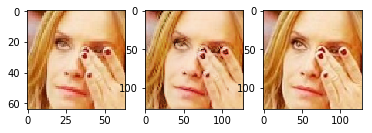

Step 1540:
    [D losses: Total=-0.042315, Wass_fake=-0.171625, Wass_real=0.125388, Wass_grad=0.003922]
    [G losses: Total=0.174965, Wass=0.167116, MSE=0.007849]


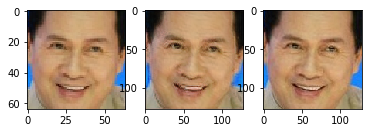

Step 1560:
    [D losses: Total=-0.042932, Wass_fake=-0.172892, Wass_real=0.127880, Wass_grad=0.002080]
    [G losses: Total=0.198965, Wass=0.191637, MSE=0.007328]


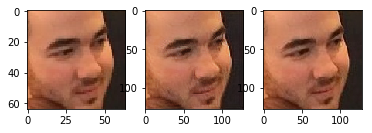

Step 1580:
    [D losses: Total=-0.048522, Wass_fake=-0.173600, Wass_real=0.123033, Wass_grad=0.002045]
    [G losses: Total=0.173880, Wass=0.168126, MSE=0.005754]


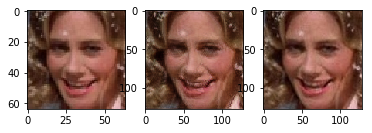

Step 1600:
    [D losses: Total=-0.045373, Wass_fake=-0.175664, Wass_real=0.120787, Wass_grad=0.009504]
    [G losses: Total=0.162712, Wass=0.156928, MSE=0.005783]


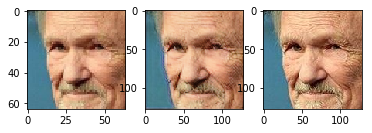

Step 1620:
    [D losses: Total=-0.041126, Wass_fake=-0.177153, Wass_real=0.133218, Wass_grad=0.002809]
    [G losses: Total=0.188485, Wass=0.182328, MSE=0.006157]


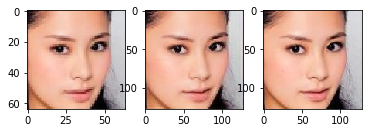

Step 1640:
    [D losses: Total=-0.034999, Wass_fake=-0.180052, Wass_real=0.143575, Wass_grad=0.001478]
    [G losses: Total=0.179266, Wass=0.172039, MSE=0.007228]


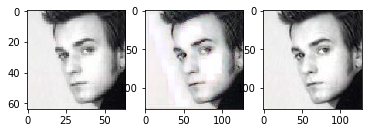

Step 1660:
    [D losses: Total=-0.045079, Wass_fake=-0.174425, Wass_real=0.121649, Wass_grad=0.007697]
    [G losses: Total=0.219775, Wass=0.209959, MSE=0.009816]


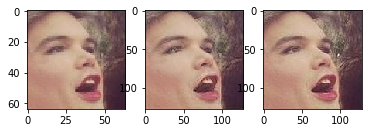

Step 1680:
    [D losses: Total=-0.037694, Wass_fake=-0.175243, Wass_real=0.135254, Wass_grad=0.002294]
    [G losses: Total=0.186145, Wass=0.179996, MSE=0.006149]


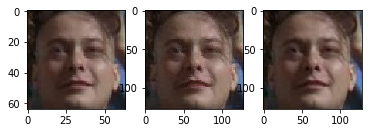

Step 1700:
    [D losses: Total=-0.050286, Wass_fake=-0.179778, Wass_real=0.126663, Wass_grad=0.002829]
    [G losses: Total=0.171483, Wass=0.166875, MSE=0.004609]


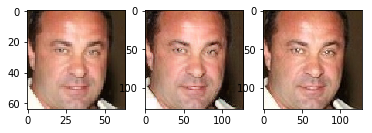

Step 1720:
    [D losses: Total=-0.030149, Wass_fake=-0.171572, Wass_real=0.130098, Wass_grad=0.011325]
    [G losses: Total=0.205427, Wass=0.197072, MSE=0.008354]


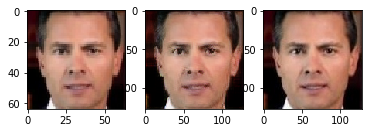

Step 1740:
    [D losses: Total=-0.041781, Wass_fake=-0.171185, Wass_real=0.121194, Wass_grad=0.008209]
    [G losses: Total=0.157001, Wass=0.148816, MSE=0.008185]


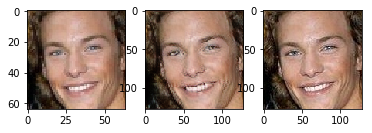

Step 1760:
    [D losses: Total=-0.047441, Wass_fake=-0.175949, Wass_real=0.127034, Wass_grad=0.001473]
    [G losses: Total=0.175482, Wass=0.168963, MSE=0.006519]


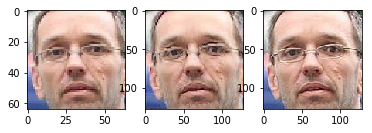

Step 1780:
    [D losses: Total=-0.043227, Wass_fake=-0.185632, Wass_real=0.138034, Wass_grad=0.004371]
    [G losses: Total=0.163772, Wass=0.158151, MSE=0.005621]


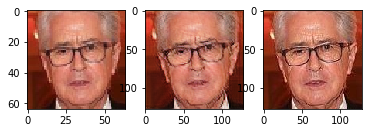

Step 1800:
    [D losses: Total=-0.039884, Wass_fake=-0.179778, Wass_real=0.128011, Wass_grad=0.011883]
    [G losses: Total=0.163903, Wass=0.158582, MSE=0.005321]


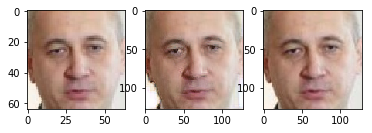

Step 1820:
    [D losses: Total=-0.045470, Wass_fake=-0.167598, Wass_real=0.117033, Wass_grad=0.005095]
    [G losses: Total=0.181566, Wass=0.175383, MSE=0.006183]


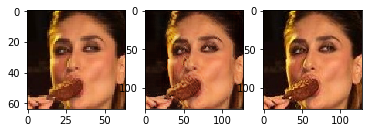

Step 1840:
    [D losses: Total=-0.048916, Wass_fake=-0.175887, Wass_real=0.125899, Wass_grad=0.001073]
    [G losses: Total=0.161515, Wass=0.156007, MSE=0.005508]


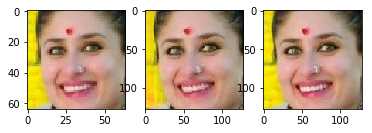

Step 1860:
    [D losses: Total=-0.051336, Wass_fake=-0.172286, Wass_real=0.118383, Wass_grad=0.002567]
    [G losses: Total=0.169618, Wass=0.163891, MSE=0.005728]


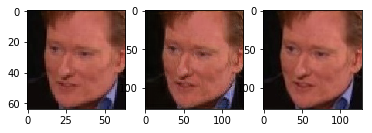

Step 1880:
    [D losses: Total=-0.057670, Wass_fake=-0.191307, Wass_real=0.130313, Wass_grad=0.003324]
    [G losses: Total=0.170757, Wass=0.164816, MSE=0.005941]


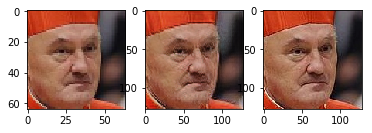

Step 1900:
    [D losses: Total=-0.041195, Wass_fake=-0.176368, Wass_real=0.133347, Wass_grad=0.001826]
    [G losses: Total=0.186972, Wass=0.179040, MSE=0.007932]


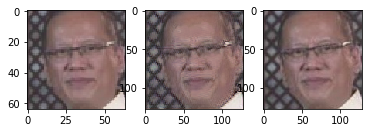

Step 1920:
    [D losses: Total=-0.030512, Wass_fake=-0.146510, Wass_real=0.112763, Wass_grad=0.003236]
    [G losses: Total=0.161493, Wass=0.155124, MSE=0.006368]


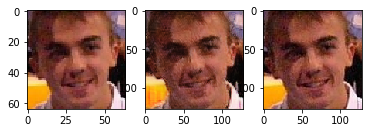

Step 1940:
    [D losses: Total=-0.073112, Wass_fake=-0.210131, Wass_real=0.127224, Wass_grad=0.009795]
    [G losses: Total=0.215442, Wass=0.205570, MSE=0.009871]


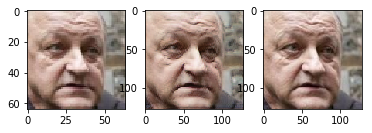

Step 1960:
    [D losses: Total=-0.052018, Wass_fake=-0.175947, Wass_real=0.118826, Wass_grad=0.005104]
    [G losses: Total=0.166466, Wass=0.160954, MSE=0.005511]


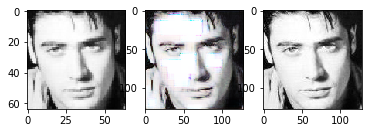

Step 1980:
    [D losses: Total=-0.043167, Wass_fake=-0.159415, Wass_real=0.113866, Wass_grad=0.002381]
    [G losses: Total=0.164268, Wass=0.157690, MSE=0.006577]


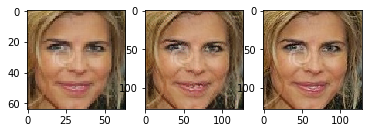

Step 2000:
    [D losses: Total=-0.034132, Wass_fake=-0.168639, Wass_real=0.129626, Wass_grad=0.004881]
    [G losses: Total=0.168490, Wass=0.161855, MSE=0.006635]


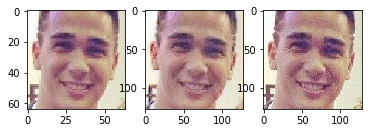

Step 2020:
    [D losses: Total=-0.028265, Wass_fake=-0.152966, Wass_real=0.120281, Wass_grad=0.004420]
    [G losses: Total=0.217873, Wass=0.207826, MSE=0.010047]


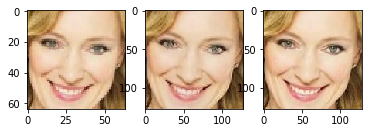

Step 2040:
    [D losses: Total=-0.050207, Wass_fake=-0.176892, Wass_real=0.125096, Wass_grad=0.001589]
    [G losses: Total=0.185247, Wass=0.176950, MSE=0.008297]


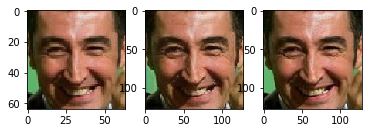

Step 2060:
    [D losses: Total=-0.036421, Wass_fake=-0.158889, Wass_real=0.118937, Wass_grad=0.003531]
    [G losses: Total=0.176051, Wass=0.169246, MSE=0.006805]


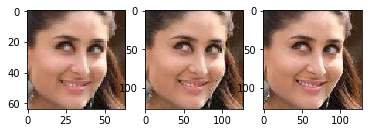

Step 2080:
    [D losses: Total=-0.050439, Wass_fake=-0.169887, Wass_real=0.113732, Wass_grad=0.005716]
    [G losses: Total=0.181468, Wass=0.174843, MSE=0.006625]


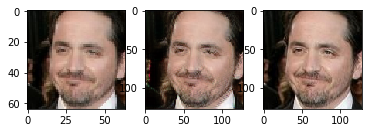

Step 2100:
    [D losses: Total=-0.041229, Wass_fake=-0.159793, Wass_real=0.116284, Wass_grad=0.002280]
    [G losses: Total=0.175589, Wass=0.168455, MSE=0.007134]


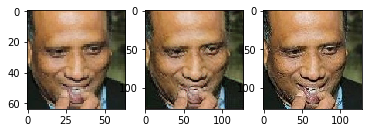

Step 2120:
    [D losses: Total=-0.035894, Wass_fake=-0.162703, Wass_real=0.125718, Wass_grad=0.001090]
    [G losses: Total=0.178696, Wass=0.171191, MSE=0.007505]


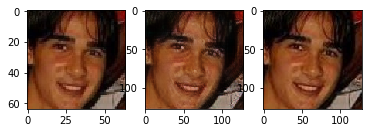

Step 2140:
    [D losses: Total=-0.052954, Wass_fake=-0.189033, Wass_real=0.130380, Wass_grad=0.005699]
    [G losses: Total=0.157658, Wass=0.152414, MSE=0.005244]


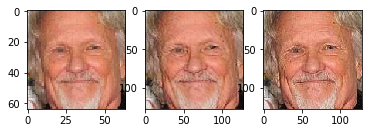

Step 2160:
    [D losses: Total=-0.044031, Wass_fake=-0.175819, Wass_real=0.122578, Wass_grad=0.009209]
    [G losses: Total=0.178140, Wass=0.171444, MSE=0.006697]


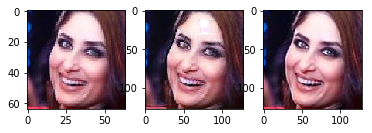

Step 2180:
    [D losses: Total=-0.043343, Wass_fake=-0.153436, Wass_real=0.108853, Wass_grad=0.001239]
    [G losses: Total=0.150888, Wass=0.143948, MSE=0.006940]


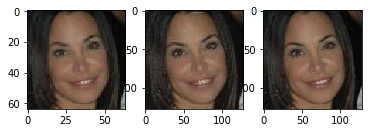

Step 2200:
    [D losses: Total=-0.034146, Wass_fake=-0.159369, Wass_real=0.123759, Wass_grad=0.001464]
    [G losses: Total=0.203964, Wass=0.195105, MSE=0.008859]


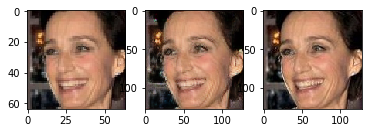

Step 2220:
    [D losses: Total=-0.048562, Wass_fake=-0.172823, Wass_real=0.121158, Wass_grad=0.003103]
    [G losses: Total=0.168512, Wass=0.162998, MSE=0.005514]


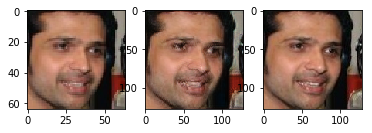

Step 2240:
    [D losses: Total=-0.039692, Wass_fake=-0.161508, Wass_real=0.118695, Wass_grad=0.003121]
    [G losses: Total=0.196333, Wass=0.189376, MSE=0.006957]


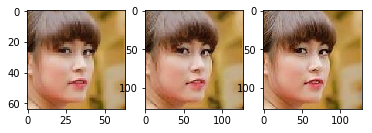

Step 2260:
    [D losses: Total=-0.030544, Wass_fake=-0.155084, Wass_real=0.121017, Wass_grad=0.003522]
    [G losses: Total=0.186310, Wass=0.179115, MSE=0.007195]


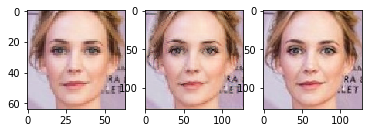

Step 2280:
    [D losses: Total=-0.043951, Wass_fake=-0.171113, Wass_real=0.124326, Wass_grad=0.002836]
    [G losses: Total=0.185404, Wass=0.178566, MSE=0.006838]


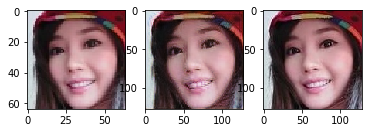

Step 2300:
    [D losses: Total=-0.067278, Wass_fake=-0.183465, Wass_real=0.114351, Wass_grad=0.001836]
    [G losses: Total=0.177947, Wass=0.170538, MSE=0.007409]


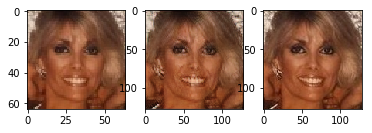

Step 2320:
    [D losses: Total=-0.038898, Wass_fake=-0.174676, Wass_real=0.122528, Wass_grad=0.013249]
    [G losses: Total=0.181231, Wass=0.172718, MSE=0.008513]


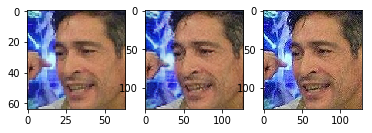

Step 2340:
    [D losses: Total=-0.052999, Wass_fake=-0.184843, Wass_real=0.127605, Wass_grad=0.004238]
    [G losses: Total=0.182339, Wass=0.174279, MSE=0.008061]


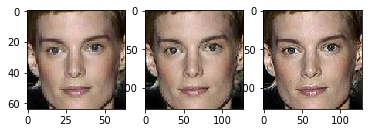

Step 2360:
    [D losses: Total=-0.039125, Wass_fake=-0.169957, Wass_real=0.129759, Wass_grad=0.001074]
    [G losses: Total=0.166694, Wass=0.159830, MSE=0.006864]


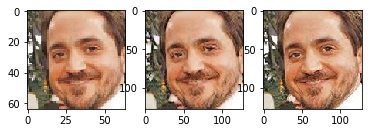

Step 2380:
    [D losses: Total=-0.045614, Wass_fake=-0.174355, Wass_real=0.127026, Wass_grad=0.001714]
    [G losses: Total=0.192561, Wass=0.186188, MSE=0.006372]


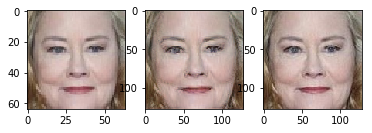

Step 2400:
    [D losses: Total=-0.040726, Wass_fake=-0.172698, Wass_real=0.124633, Wass_grad=0.007339]
    [G losses: Total=0.180871, Wass=0.173689, MSE=0.007182]


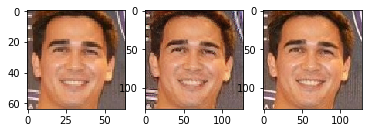

Step 2420:
    [D losses: Total=-0.046691, Wass_fake=-0.177666, Wass_real=0.130425, Wass_grad=0.000549]
    [G losses: Total=0.180227, Wass=0.173991, MSE=0.006236]


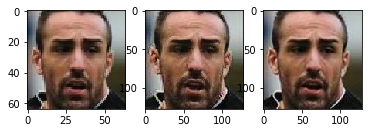

Step 2440:
    [D losses: Total=-0.036644, Wass_fake=-0.164524, Wass_real=0.125031, Wass_grad=0.002849]
    [G losses: Total=0.167291, Wass=0.160091, MSE=0.007200]


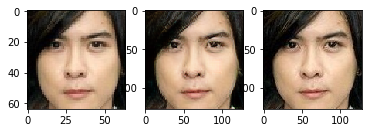

Step 2460:
    [D losses: Total=-0.044719, Wass_fake=-0.166669, Wass_real=0.120728, Wass_grad=0.001222]
    [G losses: Total=0.163655, Wass=0.156153, MSE=0.007502]


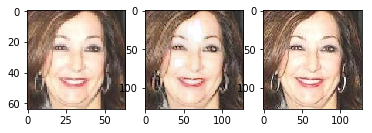

Step 2480:
    [D losses: Total=-0.044859, Wass_fake=-0.179377, Wass_real=0.130674, Wass_grad=0.003845]
    [G losses: Total=0.211820, Wass=0.204250, MSE=0.007571]


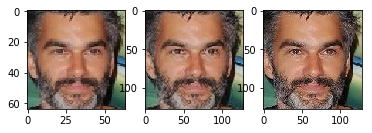

Step 2500:
    [D losses: Total=-0.034398, Wass_fake=-0.182215, Wass_real=0.143198, Wass_grad=0.004620]
    [G losses: Total=0.188811, Wass=0.180964, MSE=0.007847]


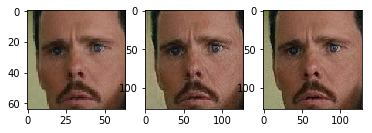

Step 2520:
    [D losses: Total=-0.055804, Wass_fake=-0.175618, Wass_real=0.118203, Wass_grad=0.001611]
    [G losses: Total=0.160839, Wass=0.153483, MSE=0.007356]


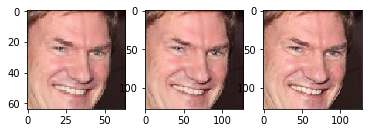

Step 2540:
    [D losses: Total=-0.071446, Wass_fake=-0.200019, Wass_real=0.126251, Wass_grad=0.002322]
    [G losses: Total=0.185324, Wass=0.178200, MSE=0.007124]


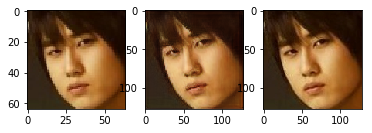

Step 2560:
    [D losses: Total=-0.048431, Wass_fake=-0.184505, Wass_real=0.128086, Wass_grad=0.007987]
    [G losses: Total=0.184347, Wass=0.179436, MSE=0.004910]


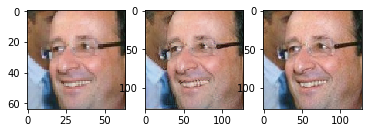

Step 2580:
    [D losses: Total=-0.047830, Wass_fake=-0.173272, Wass_real=0.121895, Wass_grad=0.003548]
    [G losses: Total=0.162688, Wass=0.156060, MSE=0.006628]


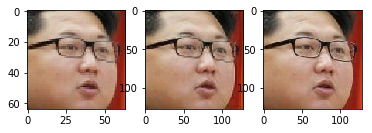

Step 2600:
    [D losses: Total=-0.038849, Wass_fake=-0.178330, Wass_real=0.136535, Wass_grad=0.002947]
    [G losses: Total=0.176475, Wass=0.171468, MSE=0.005007]


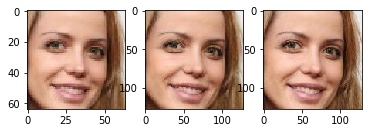

Step 2620:
    [D losses: Total=-0.040076, Wass_fake=-0.172421, Wass_real=0.128578, Wass_grad=0.003767]
    [G losses: Total=0.170956, Wass=0.163158, MSE=0.007798]


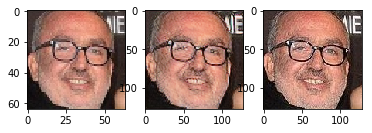

Step 2640:
    [D losses: Total=-0.044951, Wass_fake=-0.172640, Wass_real=0.126509, Wass_grad=0.001179]
    [G losses: Total=0.165566, Wass=0.160085, MSE=0.005481]


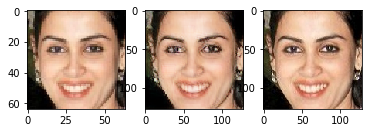

Step 2660:
    [D losses: Total=-0.049358, Wass_fake=-0.169399, Wass_real=0.117805, Wass_grad=0.002236]
    [G losses: Total=0.195216, Wass=0.187634, MSE=0.007582]


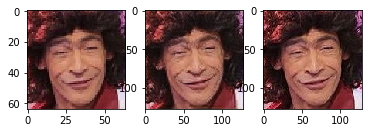

Step 2680:
    [D losses: Total=-0.045320, Wass_fake=-0.167338, Wass_real=0.119370, Wass_grad=0.002647]
    [G losses: Total=0.166044, Wass=0.158547, MSE=0.007497]


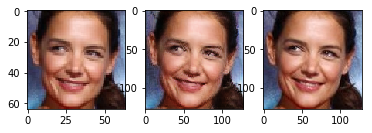

Step 2700:
    [D losses: Total=-0.030193, Wass_fake=-0.170151, Wass_real=0.137788, Wass_grad=0.002170]
    [G losses: Total=0.170654, Wass=0.163807, MSE=0.006848]


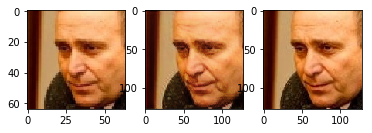

Step 2720:
    [D losses: Total=-0.058460, Wass_fake=-0.175615, Wass_real=0.114444, Wass_grad=0.002711]
    [G losses: Total=0.161019, Wass=0.154862, MSE=0.006157]


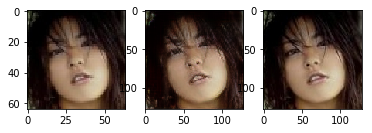

Step 2740:
    [D losses: Total=-0.038962, Wass_fake=-0.166188, Wass_real=0.122828, Wass_grad=0.004399]
    [G losses: Total=0.181104, Wass=0.174524, MSE=0.006580]


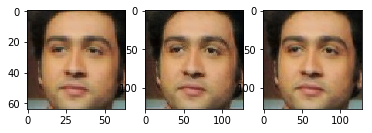

Step 2760:
    [D losses: Total=-0.033947, Wass_fake=-0.164955, Wass_real=0.128810, Wass_grad=0.002198]
    [G losses: Total=0.177206, Wass=0.169268, MSE=0.007938]


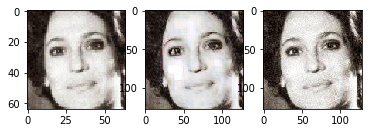

Step 2780:
    [D losses: Total=-0.030659, Wass_fake=-0.160560, Wass_real=0.120167, Wass_grad=0.009734]
    [G losses: Total=0.171845, Wass=0.164893, MSE=0.006953]


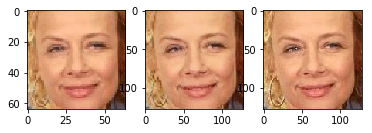

Step 2800:
    [D losses: Total=-0.043389, Wass_fake=-0.169053, Wass_real=0.121646, Wass_grad=0.004018]
    [G losses: Total=0.168888, Wass=0.162453, MSE=0.006435]


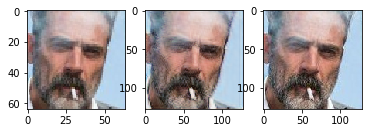

Step 2820:
    [D losses: Total=-0.045583, Wass_fake=-0.173905, Wass_real=0.125606, Wass_grad=0.002715]
    [G losses: Total=0.172351, Wass=0.164056, MSE=0.008295]


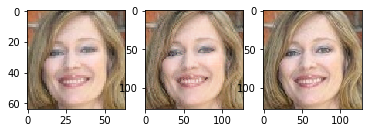

Step 2840:
    [D losses: Total=-0.040365, Wass_fake=-0.160295, Wass_real=0.118162, Wass_grad=0.001768]
    [G losses: Total=0.167510, Wass=0.161208, MSE=0.006302]


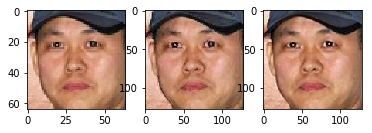

Step 2860:
    [D losses: Total=-0.039163, Wass_fake=-0.168414, Wass_real=0.128036, Wass_grad=0.001215]
    [G losses: Total=0.172021, Wass=0.165153, MSE=0.006868]


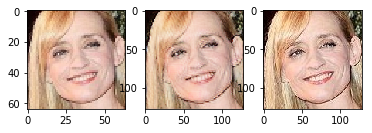

Step 2880:
    [D losses: Total=-0.058824, Wass_fake=-0.187177, Wass_real=0.126698, Wass_grad=0.001655]
    [G losses: Total=0.176002, Wass=0.168479, MSE=0.007523]


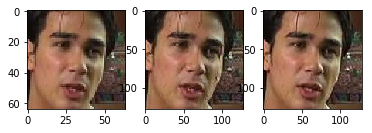

Step 2900:
    [D losses: Total=-0.042315, Wass_fake=-0.172976, Wass_real=0.129961, Wass_grad=0.000700]
    [G losses: Total=0.173068, Wass=0.164823, MSE=0.008245]


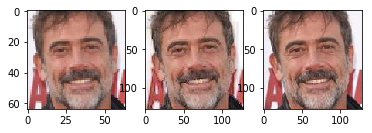

Step 2920:
    [D losses: Total=-0.035337, Wass_fake=-0.154853, Wass_real=0.117619, Wass_grad=0.001896]
    [G losses: Total=0.178624, Wass=0.170539, MSE=0.008085]


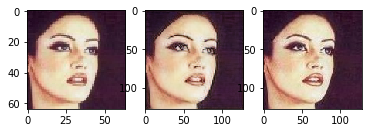

Step 2940:
    [D losses: Total=-0.040483, Wass_fake=-0.174501, Wass_real=0.132665, Wass_grad=0.001352]
    [G losses: Total=0.187417, Wass=0.181016, MSE=0.006401]


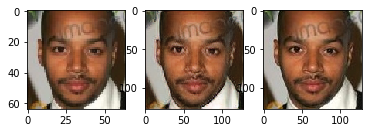

Step 2960:
    [D losses: Total=-0.033561, Wass_fake=-0.163637, Wass_real=0.129079, Wass_grad=0.000997]
    [G losses: Total=0.183495, Wass=0.174757, MSE=0.008738]


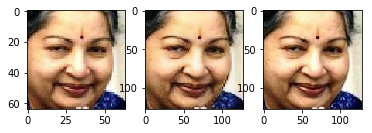

Step 2980:
    [D losses: Total=-0.048080, Wass_fake=-0.186198, Wass_real=0.136547, Wass_grad=0.001571]
    [G losses: Total=0.184451, Wass=0.176637, MSE=0.007814]


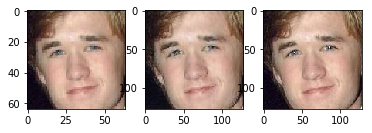

Step 3000:
    [D losses: Total=-0.035490, Wass_fake=-0.176830, Wass_real=0.134012, Wass_grad=0.007328]
    [G losses: Total=0.182391, Wass=0.175469, MSE=0.006922]


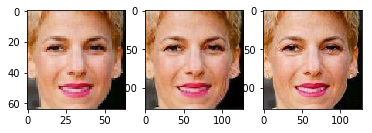

Step 3020:
    [D losses: Total=-0.040512, Wass_fake=-0.166083, Wass_real=0.122152, Wass_grad=0.003418]
    [G losses: Total=0.179338, Wass=0.171834, MSE=0.007503]


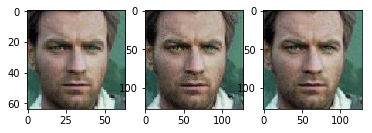

Step 3040:
    [D losses: Total=-0.046003, Wass_fake=-0.170791, Wass_real=0.121872, Wass_grad=0.002917]
    [G losses: Total=0.168273, Wass=0.161323, MSE=0.006950]


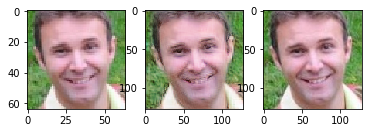

Step 3060:
    [D losses: Total=-0.032769, Wass_fake=-0.153253, Wass_real=0.116059, Wass_grad=0.004424]
    [G losses: Total=0.170210, Wass=0.164241, MSE=0.005970]


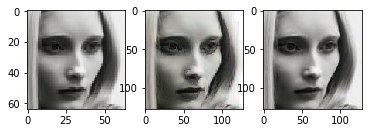

Step 3080:
    [D losses: Total=-0.039982, Wass_fake=-0.165275, Wass_real=0.122479, Wass_grad=0.002813]
    [G losses: Total=0.177530, Wass=0.169584, MSE=0.007946]


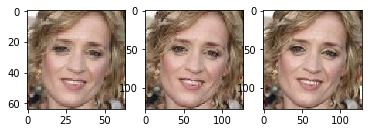

Step 3100:
    [D losses: Total=-0.043301, Wass_fake=-0.166230, Wass_real=0.121802, Wass_grad=0.001127]
    [G losses: Total=0.176983, Wass=0.170298, MSE=0.006685]


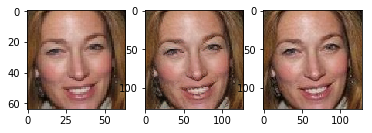

Step 3120:
    [D losses: Total=-0.040444, Wass_fake=-0.166348, Wass_real=0.124951, Wass_grad=0.000953]
    [G losses: Total=0.186074, Wass=0.178520, MSE=0.007554]


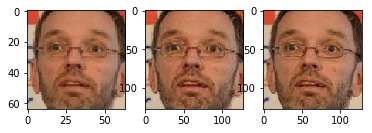

Step 3140:
    [D losses: Total=-0.051323, Wass_fake=-0.152873, Wass_real=0.100747, Wass_grad=0.000803]
    [G losses: Total=0.157732, Wass=0.151927, MSE=0.005806]


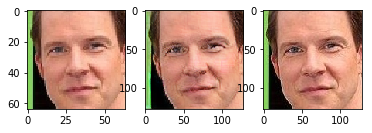

Step 3160:
    [D losses: Total=-0.048138, Wass_fake=-0.167508, Wass_real=0.115980, Wass_grad=0.003390]
    [G losses: Total=0.183110, Wass=0.176546, MSE=0.006564]


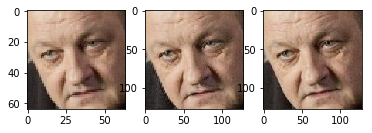

Step 3180:
    [D losses: Total=-0.040420, Wass_fake=-0.182914, Wass_real=0.130340, Wass_grad=0.012154]
    [G losses: Total=0.158322, Wass=0.151800, MSE=0.006522]


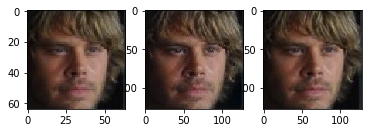

Step 3200:
    [D losses: Total=-0.036876, Wass_fake=-0.146506, Wass_real=0.108558, Wass_grad=0.001072]
    [G losses: Total=0.156591, Wass=0.147665, MSE=0.008926]


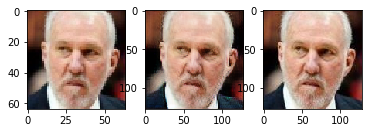

Step 3220:
    [D losses: Total=-0.054345, Wass_fake=-0.179015, Wass_real=0.123193, Wass_grad=0.001477]
    [G losses: Total=0.178243, Wass=0.170922, MSE=0.007322]


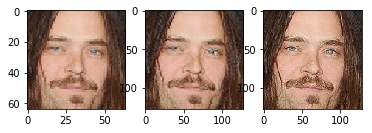

Step 3240:
    [D losses: Total=-0.061751, Wass_fake=-0.190659, Wass_real=0.127750, Wass_grad=0.001158]
    [G losses: Total=0.184990, Wass=0.178197, MSE=0.006793]


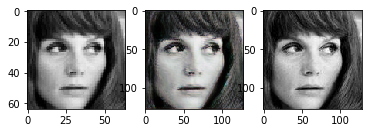

Step 3260:
    [D losses: Total=-0.051970, Wass_fake=-0.175257, Wass_real=0.118579, Wass_grad=0.004708]
    [G losses: Total=0.174229, Wass=0.168216, MSE=0.006013]


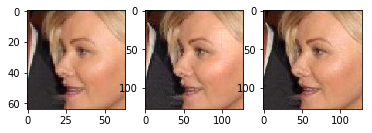

Step 3280:
    [D losses: Total=-0.044178, Wass_fake=-0.171741, Wass_real=0.124329, Wass_grad=0.003234]
    [G losses: Total=0.169501, Wass=0.162070, MSE=0.007432]


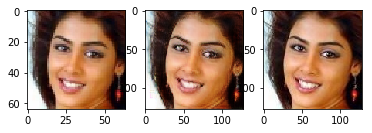

Step 3300:
    [D losses: Total=-0.054869, Wass_fake=-0.189947, Wass_real=0.133486, Wass_grad=0.001593]
    [G losses: Total=0.181992, Wass=0.175148, MSE=0.006844]


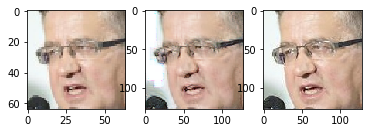

Step 3320:
    [D losses: Total=-0.049172, Wass_fake=-0.168017, Wass_real=0.114248, Wass_grad=0.004597]
    [G losses: Total=0.163802, Wass=0.157322, MSE=0.006480]


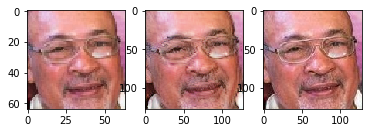

Step 3340:
    [D losses: Total=-0.051787, Wass_fake=-0.171935, Wass_real=0.117020, Wass_grad=0.003129]
    [G losses: Total=0.172389, Wass=0.165716, MSE=0.006672]


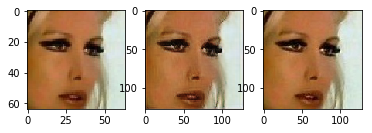

Step 3360:
    [D losses: Total=-0.039458, Wass_fake=-0.171325, Wass_real=0.129748, Wass_grad=0.002119]
    [G losses: Total=0.174272, Wass=0.167520, MSE=0.006752]


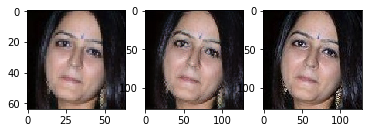

Step 3380:
    [D losses: Total=-0.033898, Wass_fake=-0.159689, Wass_real=0.122082, Wass_grad=0.003709]
    [G losses: Total=0.173224, Wass=0.164907, MSE=0.008317]


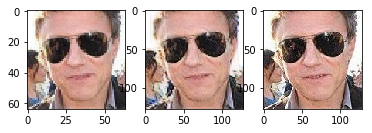

Step 3400:
    [D losses: Total=-0.029932, Wass_fake=-0.172382, Wass_real=0.131003, Wass_grad=0.011446]
    [G losses: Total=0.172685, Wass=0.166578, MSE=0.006107]


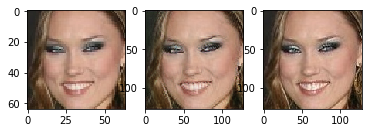

Step 3420:
    [D losses: Total=-0.047275, Wass_fake=-0.166291, Wass_real=0.116727, Wass_grad=0.002290]
    [G losses: Total=0.173309, Wass=0.165130, MSE=0.008179]


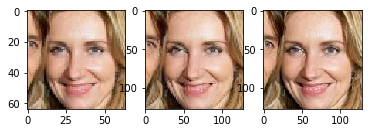

Step 3440:
    [D losses: Total=-0.036921, Wass_fake=-0.164144, Wass_real=0.125581, Wass_grad=0.001642]
    [G losses: Total=0.169974, Wass=0.164168, MSE=0.005806]


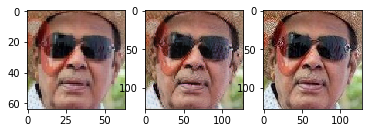

Step 3460:
    [D losses: Total=-0.033897, Wass_fake=-0.161516, Wass_real=0.123671, Wass_grad=0.003949]
    [G losses: Total=0.172348, Wass=0.164922, MSE=0.007426]


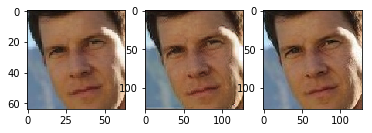

Step 3480:
    [D losses: Total=-0.055140, Wass_fake=-0.182947, Wass_real=0.126245, Wass_grad=0.001562]
    [G losses: Total=0.184082, Wass=0.177462, MSE=0.006620]


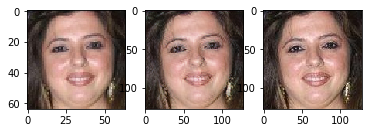

Step 3500:
    [D losses: Total=-0.040642, Wass_fake=-0.169270, Wass_real=0.124593, Wass_grad=0.004035]
    [G losses: Total=0.162065, Wass=0.156148, MSE=0.005917]


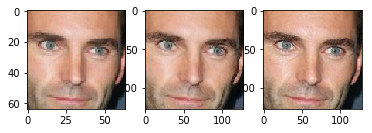

Step 3520:
    [D losses: Total=-0.027841, Wass_fake=-0.146949, Wass_real=0.117126, Wass_grad=0.001982]
    [G losses: Total=0.159067, Wass=0.153419, MSE=0.005648]


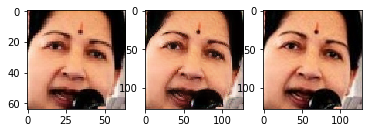

Step 3540:
    [D losses: Total=-0.047732, Wass_fake=-0.158630, Wass_real=0.108890, Wass_grad=0.002008]
    [G losses: Total=0.164675, Wass=0.158141, MSE=0.006534]


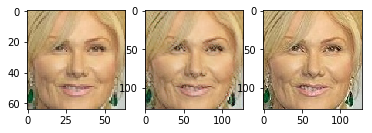

Step 3560:
    [D losses: Total=-0.036949, Wass_fake=-0.163655, Wass_real=0.122684, Wass_grad=0.004022]
    [G losses: Total=0.158849, Wass=0.153293, MSE=0.005556]


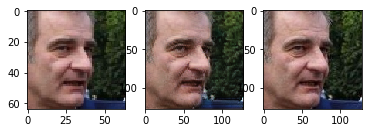

Step 3580:
    [D losses: Total=-0.038960, Wass_fake=-0.164069, Wass_real=0.122345, Wass_grad=0.002764]
    [G losses: Total=0.156960, Wass=0.151178, MSE=0.005782]


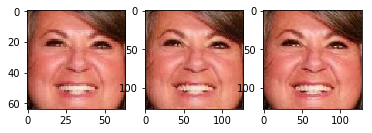

Step 3600:
    [D losses: Total=-0.024300, Wass_fake=-0.154936, Wass_real=0.114074, Wass_grad=0.016563]
    [G losses: Total=0.154779, Wass=0.148537, MSE=0.006241]


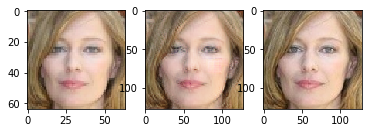

Step 3620:
    [D losses: Total=-0.024459, Wass_fake=-0.169774, Wass_real=0.129483, Wass_grad=0.015833]
    [G losses: Total=0.185882, Wass=0.179046, MSE=0.006836]


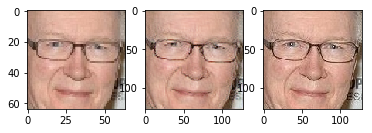

Step 3640:
    [D losses: Total=-0.056248, Wass_fake=-0.175481, Wass_real=0.117705, Wass_grad=0.001528]
    [G losses: Total=0.164435, Wass=0.158575, MSE=0.005860]


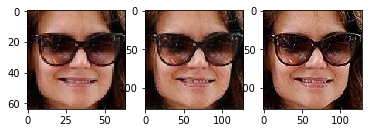

Step 3660:
    [D losses: Total=-0.031388, Wass_fake=-0.156299, Wass_real=0.124144, Wass_grad=0.000767]
    [G losses: Total=0.184632, Wass=0.177256, MSE=0.007375]


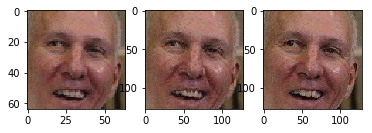

Step 3680:
    [D losses: Total=-0.036010, Wass_fake=-0.160223, Wass_real=0.122741, Wass_grad=0.001472]
    [G losses: Total=0.158723, Wass=0.153459, MSE=0.005264]


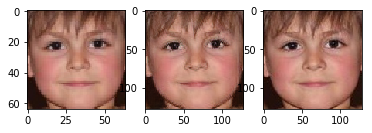

Step 3700:
    [D losses: Total=-0.034790, Wass_fake=-0.152695, Wass_real=0.116435, Wass_grad=0.001470]
    [G losses: Total=0.159214, Wass=0.153099, MSE=0.006115]


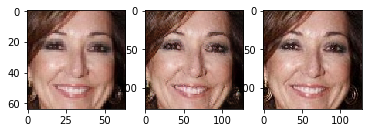

Step 3720:
    [D losses: Total=-0.045604, Wass_fake=-0.186606, Wass_real=0.138735, Wass_grad=0.002267]
    [G losses: Total=0.190887, Wass=0.183213, MSE=0.007674]


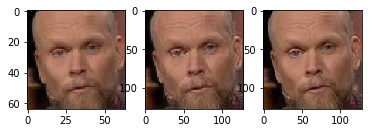

Step 3740:
    [D losses: Total=-0.043060, Wass_fake=-0.166729, Wass_real=0.122154, Wass_grad=0.001515]
    [G losses: Total=0.178727, Wass=0.172861, MSE=0.005865]


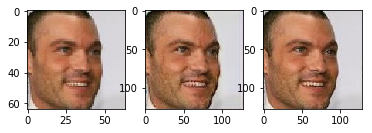

Step 3760:
    [D losses: Total=-0.047771, Wass_fake=-0.169952, Wass_real=0.120149, Wass_grad=0.002031]
    [G losses: Total=0.177029, Wass=0.171160, MSE=0.005868]


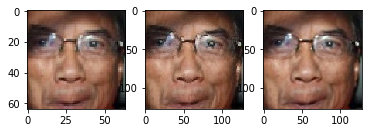

Step 3780:
    [D losses: Total=-0.051737, Wass_fake=-0.176305, Wass_real=0.120018, Wass_grad=0.004549]
    [G losses: Total=0.205839, Wass=0.195489, MSE=0.010350]


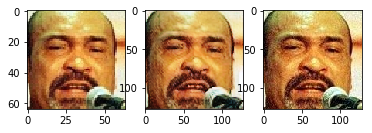

Step 3800:
    [D losses: Total=-0.037795, Wass_fake=-0.165317, Wass_real=0.126036, Wass_grad=0.001487]
    [G losses: Total=0.184072, Wass=0.175346, MSE=0.008727]


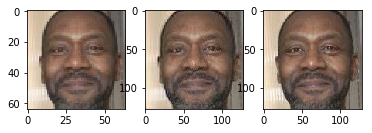

Step 3820:
    [D losses: Total=-0.035355, Wass_fake=-0.153895, Wass_real=0.117653, Wass_grad=0.000887]
    [G losses: Total=0.163619, Wass=0.158125, MSE=0.005494]


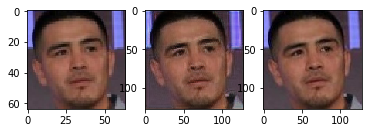

Step 3840:
    [D losses: Total=-0.061230, Wass_fake=-0.181269, Wass_real=0.119094, Wass_grad=0.000945]
    [G losses: Total=0.172257, Wass=0.164775, MSE=0.007482]


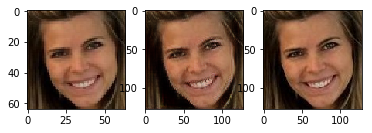

Step 3860:
    [D losses: Total=-0.046719, Wass_fake=-0.172647, Wass_real=0.122392, Wass_grad=0.003537]
    [G losses: Total=0.178560, Wass=0.170009, MSE=0.008551]


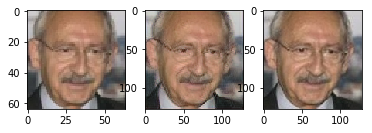

Step 3880:
    [D losses: Total=-0.027926, Wass_fake=-0.161528, Wass_real=0.126109, Wass_grad=0.007493]
    [G losses: Total=0.183514, Wass=0.176339, MSE=0.007175]


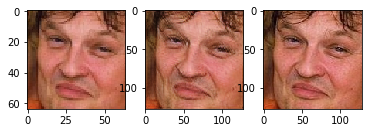

Step 3900:
    [D losses: Total=-0.048465, Wass_fake=-0.187558, Wass_real=0.134645, Wass_grad=0.004448]
    [G losses: Total=0.203735, Wass=0.197182, MSE=0.006553]


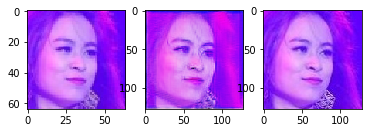

Step 3920:
    [D losses: Total=-0.035818, Wass_fake=-0.162453, Wass_real=0.126196, Wass_grad=0.000439]
    [G losses: Total=0.183576, Wass=0.175698, MSE=0.007878]


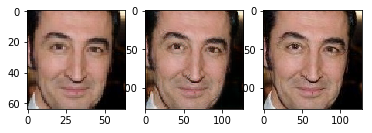

Step 3940:
    [D losses: Total=-0.035195, Wass_fake=-0.176421, Wass_real=0.137171, Wass_grad=0.004056]
    [G losses: Total=0.185079, Wass=0.176612, MSE=0.008467]


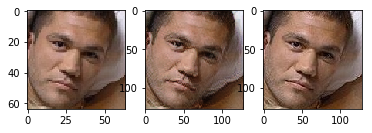

Step 3960:
    [D losses: Total=-0.032132, Wass_fake=-0.161524, Wass_real=0.125784, Wass_grad=0.003608]
    [G losses: Total=0.174005, Wass=0.165572, MSE=0.008433]


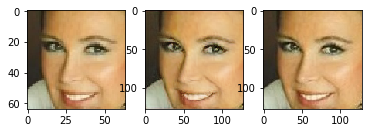

Step 3980:
    [D losses: Total=-0.046844, Wass_fake=-0.170666, Wass_real=0.122458, Wass_grad=0.001364]
    [G losses: Total=0.175311, Wass=0.169495, MSE=0.005816]


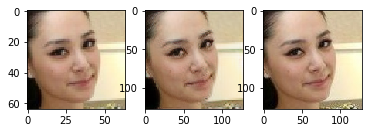

Step 4000:
    [D losses: Total=-0.030468, Wass_fake=-0.165509, Wass_real=0.131599, Wass_grad=0.003442]
    [G losses: Total=0.174336, Wass=0.166350, MSE=0.007986]


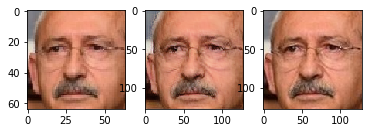

Step 4020:
    [D losses: Total=-0.059612, Wass_fake=-0.180299, Wass_real=0.118558, Wass_grad=0.002128]
    [G losses: Total=0.164734, Wass=0.159393, MSE=0.005341]


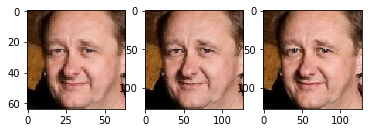

Step 4040:
    [D losses: Total=-0.032072, Wass_fake=-0.158903, Wass_real=0.125107, Wass_grad=0.001723]
    [G losses: Total=0.170332, Wass=0.164736, MSE=0.005596]


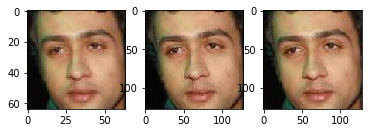

Step 4060:
    [D losses: Total=-0.049346, Wass_fake=-0.172459, Wass_real=0.121676, Wass_grad=0.001437]
    [G losses: Total=0.188601, Wass=0.181122, MSE=0.007479]


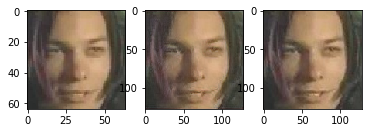

Step 4080:
    [D losses: Total=-0.056484, Wass_fake=-0.184210, Wass_real=0.126238, Wass_grad=0.001488]
    [G losses: Total=0.178290, Wass=0.170046, MSE=0.008245]


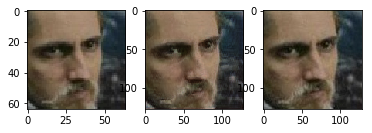

Step 4100:
    [D losses: Total=-0.057478, Wass_fake=-0.185663, Wass_real=0.126371, Wass_grad=0.001814]
    [G losses: Total=0.196299, Wass=0.189139, MSE=0.007160]


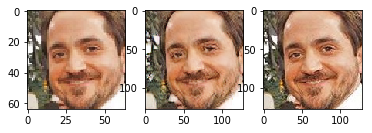

Step 4120:
    [D losses: Total=-0.058191, Wass_fake=-0.190540, Wass_real=0.130587, Wass_grad=0.001762]
    [G losses: Total=0.177368, Wass=0.170052, MSE=0.007317]


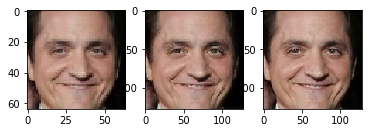

Step 4140:
    [D losses: Total=-0.042312, Wass_fake=-0.179944, Wass_real=0.131778, Wass_grad=0.005854]
    [G losses: Total=0.159776, Wass=0.154530, MSE=0.005246]


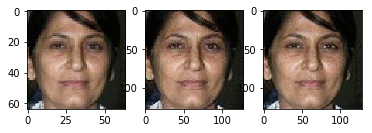

Step 4160:
    [D losses: Total=-0.032049, Wass_fake=-0.173742, Wass_real=0.126617, Wass_grad=0.015075]
    [G losses: Total=0.151105, Wass=0.144448, MSE=0.006657]


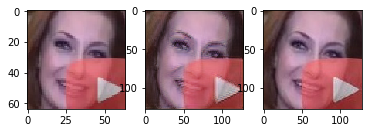

Step 4180:
    [D losses: Total=-0.037961, Wass_fake=-0.155329, Wass_real=0.113941, Wass_grad=0.003427]
    [G losses: Total=0.171113, Wass=0.165346, MSE=0.005767]


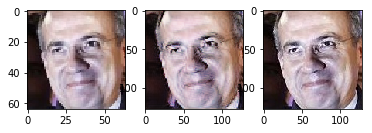

Step 4200:
    [D losses: Total=-0.050026, Wass_fake=-0.188534, Wass_real=0.133329, Wass_grad=0.005179]
    [G losses: Total=0.172308, Wass=0.164714, MSE=0.007594]


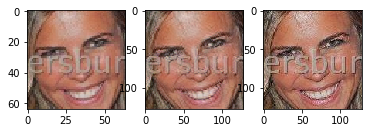

Step 4220:
    [D losses: Total=-0.049343, Wass_fake=-0.164886, Wass_real=0.112873, Wass_grad=0.002670]
    [G losses: Total=0.222080, Wass=0.208403, MSE=0.013677]


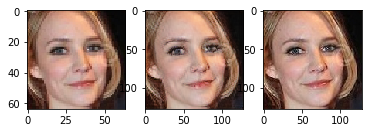

Step 4240:
    [D losses: Total=-0.073434, Wass_fake=-0.201737, Wass_real=0.126158, Wass_grad=0.002145]
    [G losses: Total=0.185731, Wass=0.178841, MSE=0.006890]


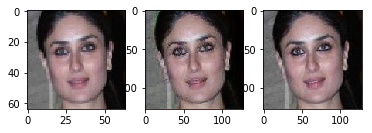

Step 4260:
    [D losses: Total=-0.037519, Wass_fake=-0.171372, Wass_real=0.131903, Wass_grad=0.001949]
    [G losses: Total=0.174619, Wass=0.168520, MSE=0.006099]


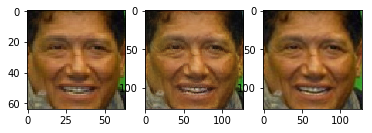

Step 4280:
    [D losses: Total=-0.044956, Wass_fake=-0.163705, Wass_real=0.116805, Wass_grad=0.001944]
    [G losses: Total=0.190529, Wass=0.183298, MSE=0.007231]


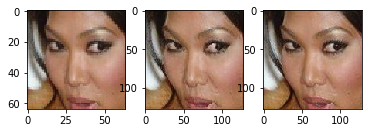

Step 4300:
    [D losses: Total=-0.051800, Wass_fake=-0.176005, Wass_real=0.121843, Wass_grad=0.002362]
    [G losses: Total=0.174254, Wass=0.167697, MSE=0.006556]


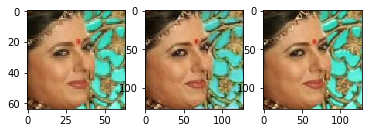

Step 4320:
    [D losses: Total=-0.027497, Wass_fake=-0.178822, Wass_real=0.145104, Wass_grad=0.006221]
    [G losses: Total=0.172126, Wass=0.165397, MSE=0.006729]


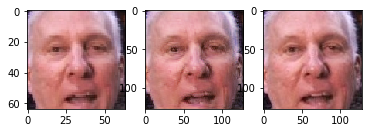

Step 4340:
    [D losses: Total=-0.045014, Wass_fake=-0.168126, Wass_real=0.117808, Wass_grad=0.005304]
    [G losses: Total=0.155287, Wass=0.149608, MSE=0.005680]


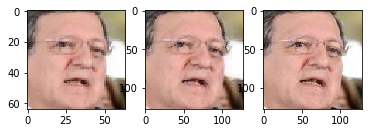

Step 4360:
    [D losses: Total=-0.042126, Wass_fake=-0.168009, Wass_real=0.125109, Wass_grad=0.000774]
    [G losses: Total=0.166579, Wass=0.161095, MSE=0.005484]


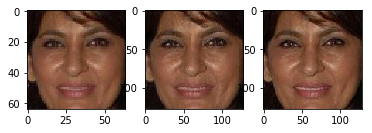

Step 4380:
    [D losses: Total=-0.029487, Wass_fake=-0.159442, Wass_real=0.128735, Wass_grad=0.001220]
    [G losses: Total=0.176556, Wass=0.167187, MSE=0.009369]


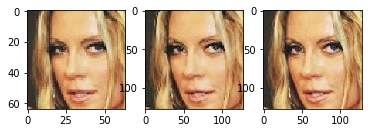

Step 4400:
    [D losses: Total=-0.039319, Wass_fake=-0.191622, Wass_real=0.136531, Wass_grad=0.015772]
    [G losses: Total=0.196003, Wass=0.184280, MSE=0.011723]


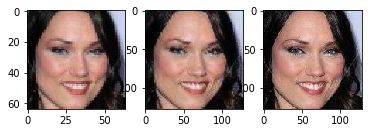

Step 4420:
    [D losses: Total=-0.047225, Wass_fake=-0.166856, Wass_real=0.117735, Wass_grad=0.001896]
    [G losses: Total=0.168225, Wass=0.160495, MSE=0.007729]


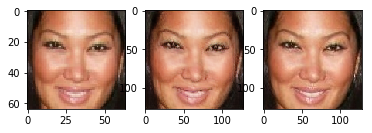

Step 4440:
    [D losses: Total=-0.033727, Wass_fake=-0.168460, Wass_real=0.132086, Wass_grad=0.002647]
    [G losses: Total=0.196600, Wass=0.189254, MSE=0.007346]


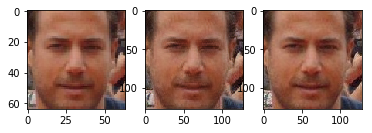

Step 4460:
    [D losses: Total=-0.038798, Wass_fake=-0.166449, Wass_real=0.124943, Wass_grad=0.002708]
    [G losses: Total=0.189018, Wass=0.181679, MSE=0.007339]


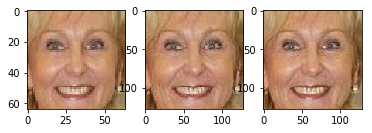

Step 4480:
    [D losses: Total=-0.046273, Wass_fake=-0.163181, Wass_real=0.113878, Wass_grad=0.003029]
    [G losses: Total=0.166069, Wass=0.160420, MSE=0.005649]


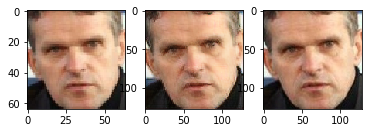

Step 4500:
    [D losses: Total=-0.034984, Wass_fake=-0.153469, Wass_real=0.117416, Wass_grad=0.001069]
    [G losses: Total=0.186118, Wass=0.178694, MSE=0.007424]


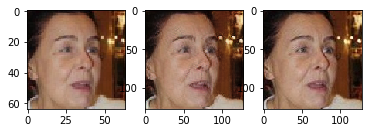

Step 4520:
    [D losses: Total=-0.046198, Wass_fake=-0.174698, Wass_real=0.126733, Wass_grad=0.001766]
    [G losses: Total=0.173513, Wass=0.165480, MSE=0.008033]


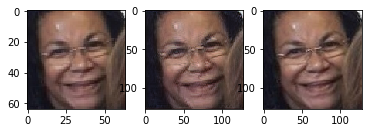

Step 4540:
    [D losses: Total=-0.036631, Wass_fake=-0.166565, Wass_real=0.126694, Wass_grad=0.003241]
    [G losses: Total=0.173050, Wass=0.167376, MSE=0.005674]


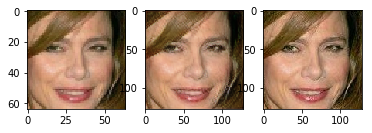

Step 4560:
    [D losses: Total=-0.036867, Wass_fake=-0.167843, Wass_real=0.124396, Wass_grad=0.006581]
    [G losses: Total=0.181843, Wass=0.175702, MSE=0.006141]


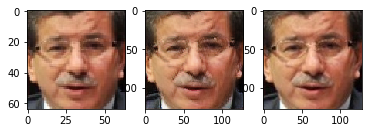

Step 4580:
    [D losses: Total=-0.054093, Wass_fake=-0.187244, Wass_real=0.131743, Wass_grad=0.001408]
    [G losses: Total=0.186510, Wass=0.178932, MSE=0.007578]


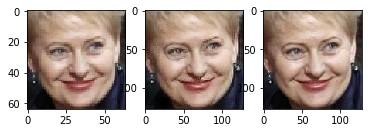

Step 4600:
    [D losses: Total=-0.083533, Wass_fake=-0.216764, Wass_real=0.131876, Wass_grad=0.001355]
    [G losses: Total=0.178380, Wass=0.170646, MSE=0.007734]


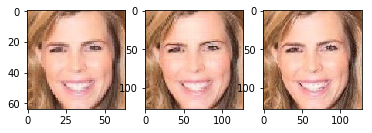

Step 4620:
    [D losses: Total=-0.035259, Wass_fake=-0.168144, Wass_real=0.130654, Wass_grad=0.002231]
    [G losses: Total=0.185153, Wass=0.178042, MSE=0.007111]


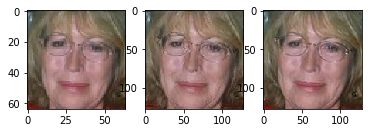

Step 4640:
    [D losses: Total=-0.038814, Wass_fake=-0.162074, Wass_real=0.121516, Wass_grad=0.001744]
    [G losses: Total=0.173435, Wass=0.167231, MSE=0.006204]


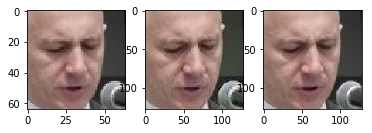

Step 4660:
    [D losses: Total=-0.036829, Wass_fake=-0.167224, Wass_real=0.128868, Wass_grad=0.001526]
    [G losses: Total=0.172319, Wass=0.164941, MSE=0.007379]


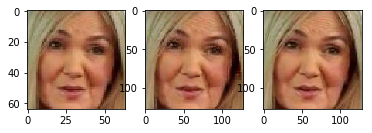

Step 4680:
    [D losses: Total=-0.034307, Wass_fake=-0.170092, Wass_real=0.134322, Wass_grad=0.001463]
    [G losses: Total=0.184519, Wass=0.177791, MSE=0.006729]


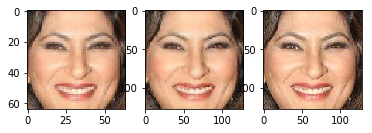

Step 4700:
    [D losses: Total=-0.042955, Wass_fake=-0.161091, Wass_real=0.113073, Wass_grad=0.005062]
    [G losses: Total=0.165919, Wass=0.159501, MSE=0.006418]


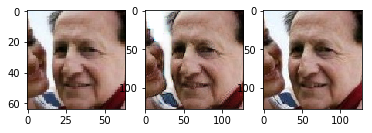

Step 4720:
    [D losses: Total=-0.024707, Wass_fake=-0.151334, Wass_real=0.119038, Wass_grad=0.007589]
    [G losses: Total=0.195898, Wass=0.187471, MSE=0.008428]


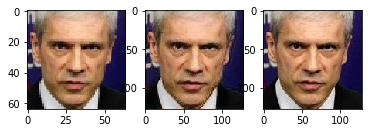

Step 4740:
    [D losses: Total=-0.044493, Wass_fake=-0.186283, Wass_real=0.140539, Wass_grad=0.001252]
    [G losses: Total=0.192907, Wass=0.183430, MSE=0.009477]


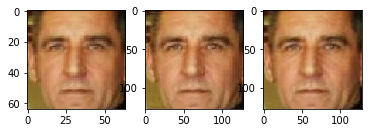

Step 4760:
    [D losses: Total=-0.047882, Wass_fake=-0.197976, Wass_real=0.143192, Wass_grad=0.006901]
    [G losses: Total=0.180517, Wass=0.174497, MSE=0.006020]


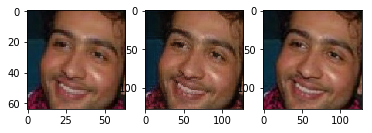

Step 4780:
    [D losses: Total=-0.035747, Wass_fake=-0.163835, Wass_real=0.126378, Wass_grad=0.001710]
    [G losses: Total=0.171139, Wass=0.165010, MSE=0.006129]


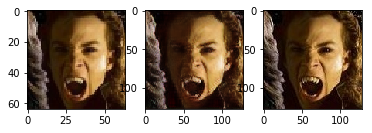

Step 4800:
    [D losses: Total=-0.039744, Wass_fake=-0.183753, Wass_real=0.127658, Wass_grad=0.016351]
    [G losses: Total=0.211798, Wass=0.204504, MSE=0.007293]


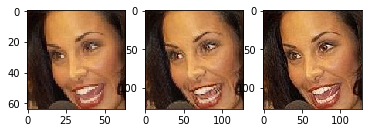

Step 4820:
    [D losses: Total=-0.040845, Wass_fake=-0.173128, Wass_real=0.130136, Wass_grad=0.002148]
    [G losses: Total=0.188728, Wass=0.181681, MSE=0.007047]


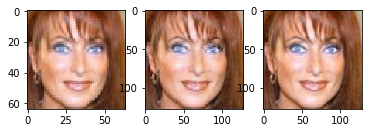

Step 4840:
    [D losses: Total=-0.064672, Wass_fake=-0.195615, Wass_real=0.129496, Wass_grad=0.001447]
    [G losses: Total=0.184678, Wass=0.178677, MSE=0.006001]


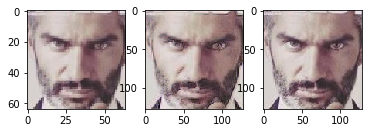

Step 4860:
    [D losses: Total=-0.056144, Wass_fake=-0.195089, Wass_real=0.136552, Wass_grad=0.002394]
    [G losses: Total=0.171290, Wass=0.165320, MSE=0.005969]


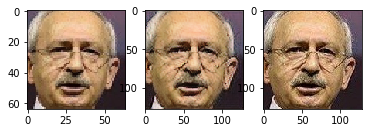

Step 4880:
    [D losses: Total=-0.052291, Wass_fake=-0.190971, Wass_real=0.137125, Wass_grad=0.001555]
    [G losses: Total=0.179083, Wass=0.170907, MSE=0.008177]


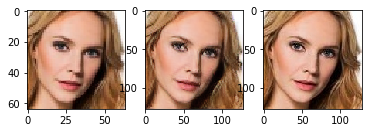

Step 4900:
    [D losses: Total=-0.046307, Wass_fake=-0.174124, Wass_real=0.120621, Wass_grad=0.007196]
    [G losses: Total=0.199835, Wass=0.192622, MSE=0.007214]


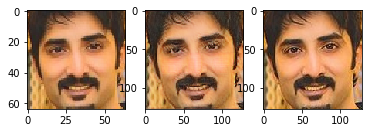

Step 4920:
    [D losses: Total=-0.044622, Wass_fake=-0.183901, Wass_real=0.136673, Wass_grad=0.002605]
    [G losses: Total=0.178959, Wass=0.172433, MSE=0.006525]


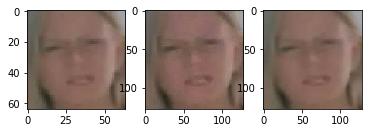

Step 4940:
    [D losses: Total=-0.031927, Wass_fake=-0.158699, Wass_real=0.120162, Wass_grad=0.006610]
    [G losses: Total=0.184417, Wass=0.175636, MSE=0.008781]


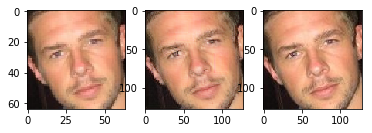

Step 4960:
    [D losses: Total=-0.039432, Wass_fake=-0.173667, Wass_real=0.133004, Wass_grad=0.001231]
    [G losses: Total=0.177627, Wass=0.170988, MSE=0.006639]


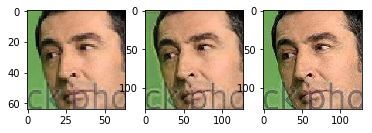

Step 4980:
    [D losses: Total=-0.032369, Wass_fake=-0.150625, Wass_real=0.114290, Wass_grad=0.003967]
    [G losses: Total=0.161028, Wass=0.154238, MSE=0.006790]


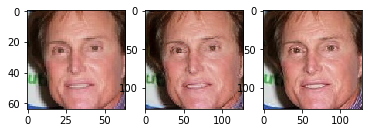

Step 5000:
    [D losses: Total=-0.048233, Wass_fake=-0.178424, Wass_real=0.126537, Wass_grad=0.003654]
    [G losses: Total=0.161295, Wass=0.155398, MSE=0.005896]


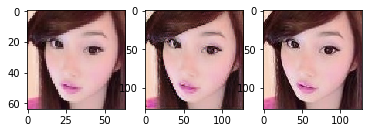

Step 5020:
    [D losses: Total=-0.041729, Wass_fake=-0.163118, Wass_real=0.119824, Wass_grad=0.001565]
    [G losses: Total=0.167622, Wass=0.159336, MSE=0.008286]


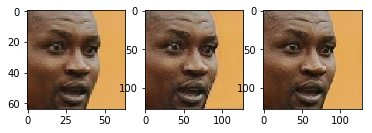

Step 5040:
    [D losses: Total=-0.053105, Wass_fake=-0.192271, Wass_real=0.137224, Wass_grad=0.001942]
    [G losses: Total=0.191574, Wass=0.182285, MSE=0.009289]


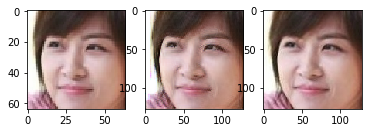

Step 5060:
    [D losses: Total=-0.037301, Wass_fake=-0.149785, Wass_real=0.110094, Wass_grad=0.002391]
    [G losses: Total=0.182399, Wass=0.174738, MSE=0.007661]


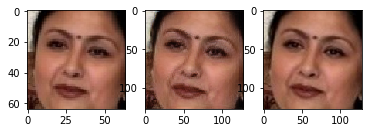

Step 5080:
    [D losses: Total=-0.061559, Wass_fake=-0.193168, Wass_real=0.129076, Wass_grad=0.002533]
    [G losses: Total=0.178247, Wass=0.172397, MSE=0.005850]


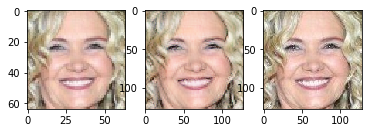

Step 5100:
    [D losses: Total=-0.039815, Wass_fake=-0.167849, Wass_real=0.127004, Wass_grad=0.001031]
    [G losses: Total=0.168580, Wass=0.161957, MSE=0.006622]


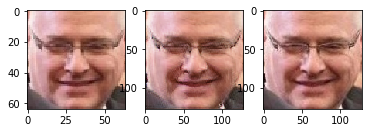

Step 5120:
    [D losses: Total=-0.043317, Wass_fake=-0.163515, Wass_real=0.115918, Wass_grad=0.004281]
    [G losses: Total=0.164139, Wass=0.156705, MSE=0.007434]


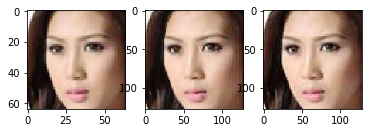

Step 5140:
    [D losses: Total=-0.057218, Wass_fake=-0.189482, Wass_real=0.127730, Wass_grad=0.004534]
    [G losses: Total=0.199764, Wass=0.191070, MSE=0.008694]


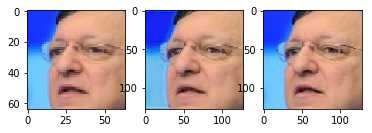

Step 5160:
    [D losses: Total=-0.046513, Wass_fake=-0.182311, Wass_real=0.128861, Wass_grad=0.006937]
    [G losses: Total=0.177347, Wass=0.169371, MSE=0.007977]


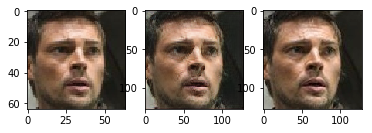

Step 5180:
    [D losses: Total=-0.027634, Wass_fake=-0.163858, Wass_real=0.131278, Wass_grad=0.004947]
    [G losses: Total=0.214336, Wass=0.205764, MSE=0.008571]


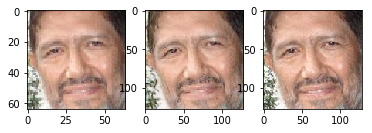

Step 5200:
    [D losses: Total=-0.045158, Wass_fake=-0.162929, Wass_real=0.116479, Wass_grad=0.001291]
    [G losses: Total=0.173152, Wass=0.164702, MSE=0.008449]


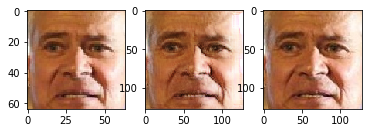

Step 5220:
    [D losses: Total=-0.027332, Wass_fake=-0.163155, Wass_real=0.134002, Wass_grad=0.001821]
    [G losses: Total=0.184088, Wass=0.177766, MSE=0.006322]


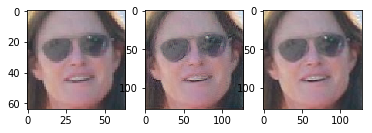

Step 5240:
    [D losses: Total=-0.034760, Wass_fake=-0.160471, Wass_real=0.123475, Wass_grad=0.002236]
    [G losses: Total=0.158379, Wass=0.151159, MSE=0.007220]


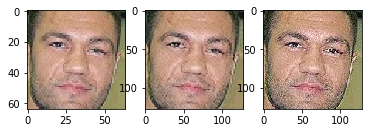

Step 5260:
    [D losses: Total=-0.040402, Wass_fake=-0.160120, Wass_real=0.115101, Wass_grad=0.004617]
    [G losses: Total=0.171337, Wass=0.165369, MSE=0.005968]


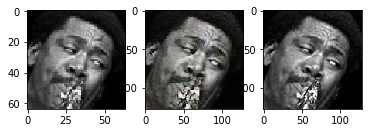

Step 5280:
    [D losses: Total=-0.037282, Wass_fake=-0.160851, Wass_real=0.121321, Wass_grad=0.002248]
    [G losses: Total=0.166083, Wass=0.159052, MSE=0.007031]


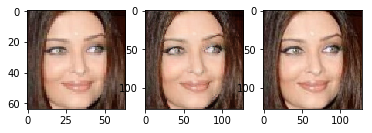

Step 5300:
    [D losses: Total=-0.045526, Wass_fake=-0.177054, Wass_real=0.127179, Wass_grad=0.004349]
    [G losses: Total=0.178480, Wass=0.170984, MSE=0.007496]


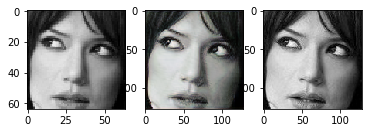

Step 5320:
    [D losses: Total=-0.034144, Wass_fake=-0.155933, Wass_real=0.120913, Wass_grad=0.000876]
    [G losses: Total=0.187073, Wass=0.179675, MSE=0.007399]


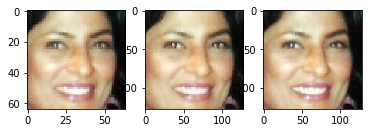

Step 5340:
    [D losses: Total=-0.037250, Wass_fake=-0.166047, Wass_real=0.125704, Wass_grad=0.003093]
    [G losses: Total=0.170847, Wass=0.164457, MSE=0.006390]


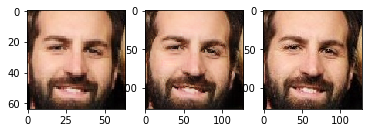

Step 5360:
    [D losses: Total=-0.032732, Wass_fake=-0.150851, Wass_real=0.115198, Wass_grad=0.002921]
    [G losses: Total=0.168033, Wass=0.160852, MSE=0.007181]


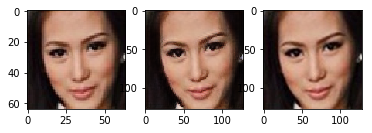

Step 5380:
    [D losses: Total=-0.050013, Wass_fake=-0.186879, Wass_real=0.133808, Wass_grad=0.003058]
    [G losses: Total=0.172302, Wass=0.166621, MSE=0.005682]


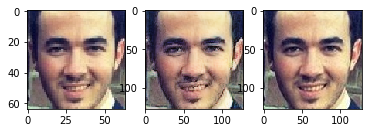

Step 5400:
    [D losses: Total=-0.039129, Wass_fake=-0.177420, Wass_real=0.136277, Wass_grad=0.002014]
    [G losses: Total=0.177480, Wass=0.172292, MSE=0.005188]


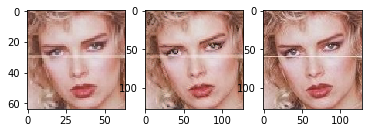

Step 5420:
    [D losses: Total=-0.044811, Wass_fake=-0.162682, Wass_real=0.114135, Wass_grad=0.003736]
    [G losses: Total=0.164588, Wass=0.156883, MSE=0.007705]


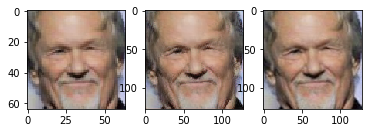

Step 5440:
    [D losses: Total=-0.037750, Wass_fake=-0.163102, Wass_real=0.122000, Wass_grad=0.003353]
    [G losses: Total=0.179798, Wass=0.171633, MSE=0.008166]


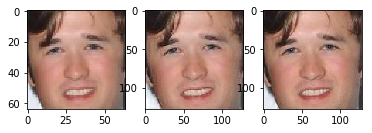

Step 5460:
    [D losses: Total=-0.035607, Wass_fake=-0.156769, Wass_real=0.118579, Wass_grad=0.002584]
    [G losses: Total=0.171016, Wass=0.164257, MSE=0.006760]


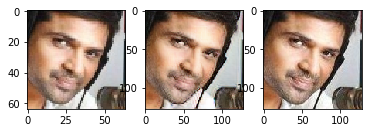

Step 5480:
    [D losses: Total=-0.034795, Wass_fake=-0.156763, Wass_real=0.120565, Wass_grad=0.001403]
    [G losses: Total=0.169902, Wass=0.165200, MSE=0.004703]


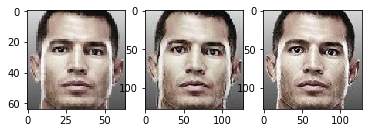

Step 5500:
    [D losses: Total=-0.069179, Wass_fake=-0.191621, Wass_real=0.120349, Wass_grad=0.002093]
    [G losses: Total=0.192834, Wass=0.183631, MSE=0.009203]


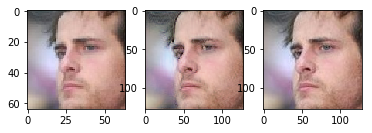

Step 5520:
    [D losses: Total=-0.032840, Wass_fake=-0.155120, Wass_real=0.119235, Wass_grad=0.003044]
    [G losses: Total=0.169957, Wass=0.163236, MSE=0.006721]


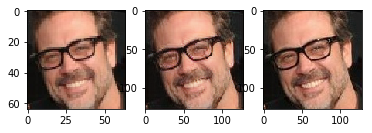

Step 5540:
    [D losses: Total=-0.043314, Wass_fake=-0.164032, Wass_real=0.116733, Wass_grad=0.003985]
    [G losses: Total=0.179682, Wass=0.170463, MSE=0.009219]


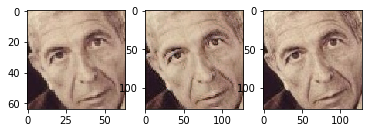

Step 5560:
    [D losses: Total=-0.035467, Wass_fake=-0.170307, Wass_real=0.131916, Wass_grad=0.002925]
    [G losses: Total=0.175361, Wass=0.168549, MSE=0.006812]


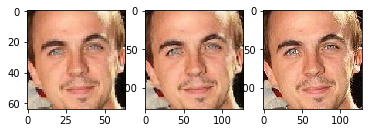

Step 5580:
    [D losses: Total=-0.034459, Wass_fake=-0.160167, Wass_real=0.124217, Wass_grad=0.001491]
    [G losses: Total=0.157932, Wass=0.153124, MSE=0.004807]


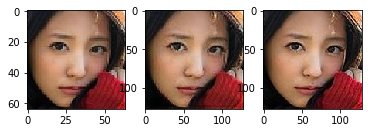

Step 5600:
    [D losses: Total=-0.032438, Wass_fake=-0.159313, Wass_real=0.125467, Wass_grad=0.001409]
    [G losses: Total=0.168306, Wass=0.162317, MSE=0.005989]


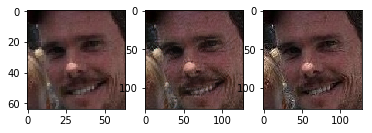

Step 5620:
    [D losses: Total=-0.041011, Wass_fake=-0.165709, Wass_real=0.121652, Wass_grad=0.003046]
    [G losses: Total=0.171203, Wass=0.165229, MSE=0.005974]


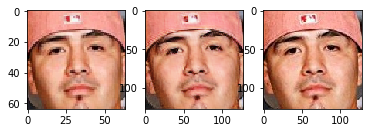

Step 5640:
    [D losses: Total=-0.031253, Wass_fake=-0.158520, Wass_real=0.122974, Wass_grad=0.004294]
    [G losses: Total=0.192730, Wass=0.183004, MSE=0.009726]


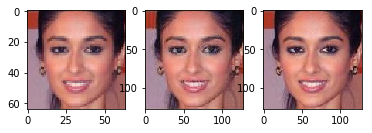

Step 5660:
    [D losses: Total=-0.050656, Wass_fake=-0.188827, Wass_real=0.123556, Wass_grad=0.014615]
    [G losses: Total=0.183340, Wass=0.176644, MSE=0.006697]


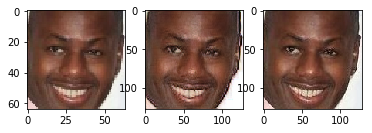

Step 5680:
    [D losses: Total=-0.027780, Wass_fake=-0.168965, Wass_real=0.131150, Wass_grad=0.010034]
    [G losses: Total=0.160102, Wass=0.153055, MSE=0.007047]


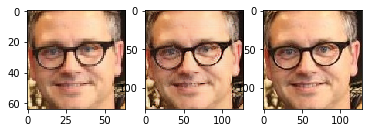

Step 5700:
    [D losses: Total=-0.061657, Wass_fake=-0.181315, Wass_real=0.118856, Wass_grad=0.000802]
    [G losses: Total=0.175945, Wass=0.170130, MSE=0.005816]


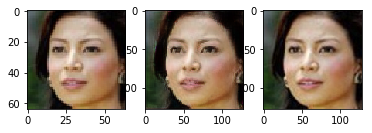

Step 5720:
    [D losses: Total=-0.031315, Wass_fake=-0.165800, Wass_real=0.122655, Wass_grad=0.011830]
    [G losses: Total=0.170904, Wass=0.164731, MSE=0.006173]


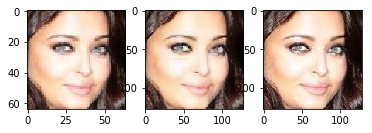

Step 5740:
    [D losses: Total=-0.048620, Wass_fake=-0.172694, Wass_real=0.122820, Wass_grad=0.001254]
    [G losses: Total=0.177875, Wass=0.170314, MSE=0.007561]


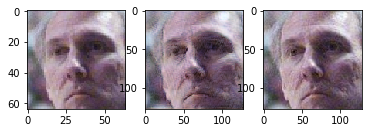

Step 5760:
    [D losses: Total=-0.030168, Wass_fake=-0.153592, Wass_real=0.120794, Wass_grad=0.002630]
    [G losses: Total=0.176866, Wass=0.171621, MSE=0.005245]


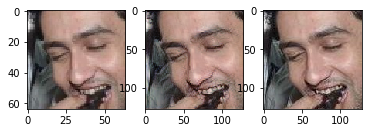

Step 5780:
    [D losses: Total=-0.032709, Wass_fake=-0.151903, Wass_real=0.116423, Wass_grad=0.002771]
    [G losses: Total=0.165941, Wass=0.159181, MSE=0.006760]


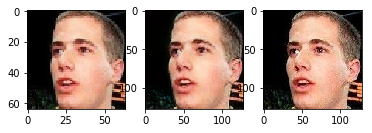

Step 5800:
    [D losses: Total=-0.038942, Wass_fake=-0.169055, Wass_real=0.127815, Wass_grad=0.002299]
    [G losses: Total=0.199046, Wass=0.189112, MSE=0.009934]


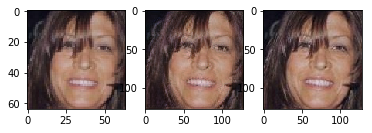

Step 5820:
    [D losses: Total=-0.032868, Wass_fake=-0.155919, Wass_real=0.121288, Wass_grad=0.001764]
    [G losses: Total=0.201049, Wass=0.193018, MSE=0.008031]


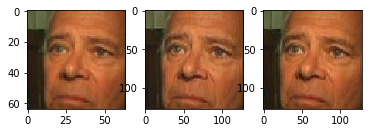

Step 5840:
    [D losses: Total=-0.035733, Wass_fake=-0.148617, Wass_real=0.108374, Wass_grad=0.004509]
    [G losses: Total=0.165155, Wass=0.158004, MSE=0.007152]


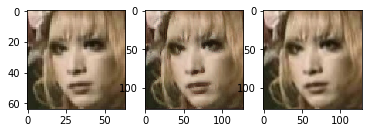

Step 5860:
    [D losses: Total=-0.056361, Wass_fake=-0.191397, Wass_real=0.134276, Wass_grad=0.000760]
    [G losses: Total=0.181217, Wass=0.175936, MSE=0.005281]


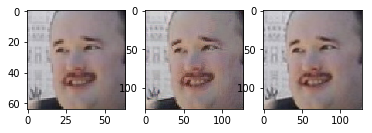

Step 5880:
    [D losses: Total=-0.046865, Wass_fake=-0.177303, Wass_real=0.128695, Wass_grad=0.001743]
    [G losses: Total=0.179307, Wass=0.173054, MSE=0.006253]


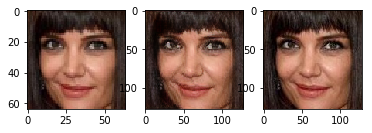

Step 5900:
    [D losses: Total=-0.042924, Wass_fake=-0.170119, Wass_real=0.124486, Wass_grad=0.002709]
    [G losses: Total=0.171521, Wass=0.165918, MSE=0.005604]


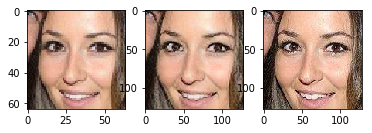

Step 5920:
    [D losses: Total=-0.038975, Wass_fake=-0.179465, Wass_real=0.134960, Wass_grad=0.005530]
    [G losses: Total=0.179091, Wass=0.172559, MSE=0.006532]


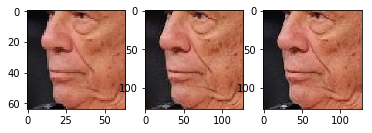

Step 5940:
    [D losses: Total=-0.040318, Wass_fake=-0.168165, Wass_real=0.126237, Wass_grad=0.001610]
    [G losses: Total=0.178190, Wass=0.171330, MSE=0.006860]


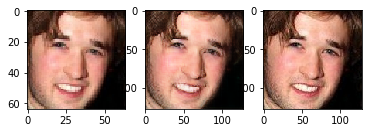

Step 5960:
    [D losses: Total=-0.033867, Wass_fake=-0.158900, Wass_real=0.122284, Wass_grad=0.002749]
    [G losses: Total=0.160135, Wass=0.155480, MSE=0.004655]


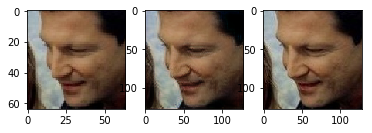

Step 5980:
    [D losses: Total=-0.029127, Wass_fake=-0.154477, Wass_real=0.123092, Wass_grad=0.002257]
    [G losses: Total=0.171754, Wass=0.163781, MSE=0.007974]


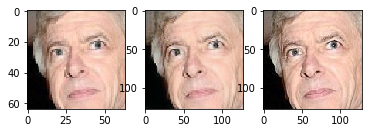

Step 6000:
    [D losses: Total=-0.041141, Wass_fake=-0.167762, Wass_real=0.122854, Wass_grad=0.003766]
    [G losses: Total=0.186974, Wass=0.180622, MSE=0.006352]


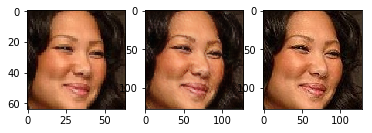

Step 6020:
    [D losses: Total=-0.039666, Wass_fake=-0.154861, Wass_real=0.113300, Wass_grad=0.001895]
    [G losses: Total=0.164355, Wass=0.156937, MSE=0.007418]


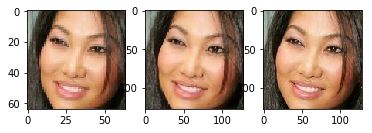

Step 6040:
    [D losses: Total=-0.038550, Wass_fake=-0.173016, Wass_real=0.133205, Wass_grad=0.001260]
    [G losses: Total=0.193561, Wass=0.185972, MSE=0.007589]


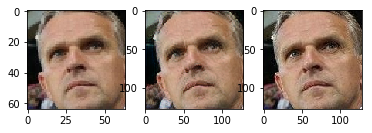

Step 6060:
    [D losses: Total=-0.020156, Wass_fake=-0.149774, Wass_real=0.121343, Wass_grad=0.008275]
    [G losses: Total=0.170518, Wass=0.164813, MSE=0.005705]


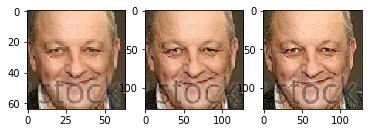

Step 6080:
    [D losses: Total=-0.026570, Wass_fake=-0.164236, Wass_real=0.130549, Wass_grad=0.007117]
    [G losses: Total=0.167184, Wass=0.162300, MSE=0.004884]


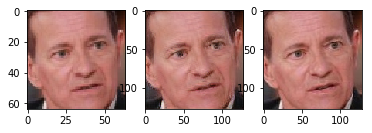

Step 6100:
    [D losses: Total=-0.046388, Wass_fake=-0.181200, Wass_real=0.125672, Wass_grad=0.009139]
    [G losses: Total=0.188871, Wass=0.180161, MSE=0.008710]


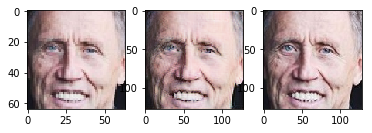

Step 6120:
    [D losses: Total=-0.009962, Wass_fake=-0.169719, Wass_real=0.142093, Wass_grad=0.017663]
    [G losses: Total=0.163680, Wass=0.157582, MSE=0.006098]


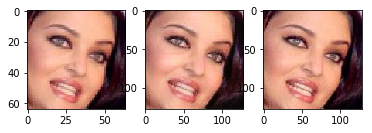

Step 6140:
    [D losses: Total=-0.041210, Wass_fake=-0.158757, Wass_real=0.115363, Wass_grad=0.002185]
    [G losses: Total=0.179643, Wass=0.174116, MSE=0.005527]


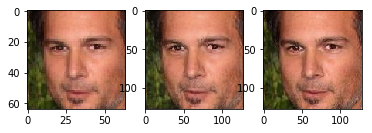

Step 6160:
    [D losses: Total=-0.055047, Wass_fake=-0.170069, Wass_real=0.113712, Wass_grad=0.001309]
    [G losses: Total=0.156193, Wass=0.149202, MSE=0.006991]


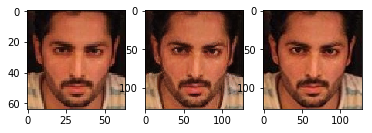

Step 6180:
    [D losses: Total=-0.044578, Wass_fake=-0.165864, Wass_real=0.117684, Wass_grad=0.003601]
    [G losses: Total=0.175236, Wass=0.168622, MSE=0.006614]


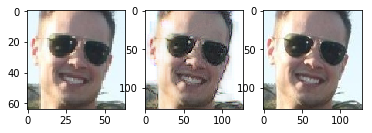

Step 6200:
    [D losses: Total=-0.025733, Wass_fake=-0.160006, Wass_real=0.122816, Wass_grad=0.011456]
    [G losses: Total=0.186623, Wass=0.178808, MSE=0.007815]


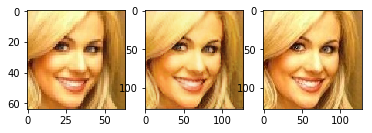

Step 6220:
    [D losses: Total=-0.034516, Wass_fake=-0.163291, Wass_real=0.127072, Wass_grad=0.001703]
    [G losses: Total=0.180915, Wass=0.174507, MSE=0.006408]


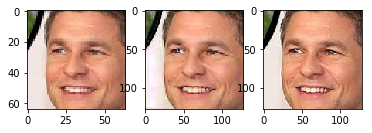

Step 6240:
    [D losses: Total=-0.033213, Wass_fake=-0.149184, Wass_real=0.113358, Wass_grad=0.002613]
    [G losses: Total=0.165815, Wass=0.159811, MSE=0.006004]


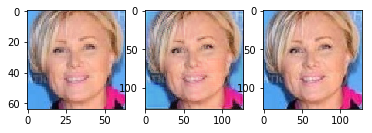

Step 6260:
    [D losses: Total=-0.043375, Wass_fake=-0.175333, Wass_real=0.126267, Wass_grad=0.005691]
    [G losses: Total=0.186610, Wass=0.178794, MSE=0.007817]


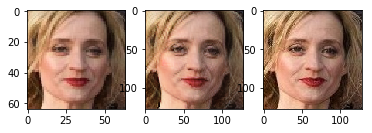

Step 6280:
    [D losses: Total=-0.037163, Wass_fake=-0.163533, Wass_real=0.124185, Wass_grad=0.002185]
    [G losses: Total=0.173040, Wass=0.166014, MSE=0.007027]


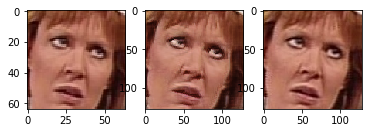

Step 6300:
    [D losses: Total=-0.068744, Wass_fake=-0.184619, Wass_real=0.114764, Wass_grad=0.001111]
    [G losses: Total=0.164303, Wass=0.156977, MSE=0.007326]


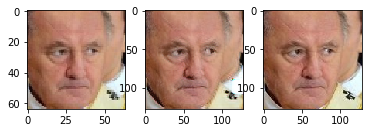

Step 6320:
    [D losses: Total=-0.050051, Wass_fake=-0.183333, Wass_real=0.129496, Wass_grad=0.003786]
    [G losses: Total=0.187216, Wass=0.180357, MSE=0.006859]


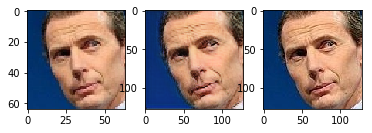

Step 6340:
    [D losses: Total=-0.031722, Wass_fake=-0.155049, Wass_real=0.120314, Wass_grad=0.003014]
    [G losses: Total=0.159894, Wass=0.153180, MSE=0.006714]


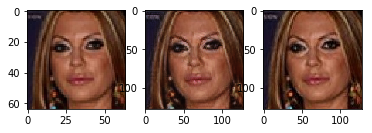

Step 6360:
    [D losses: Total=-0.029690, Wass_fake=-0.167006, Wass_real=0.134535, Wass_grad=0.002780]
    [G losses: Total=0.192029, Wass=0.185912, MSE=0.006117]


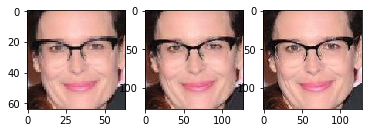

Step 6380:
    [D losses: Total=-0.038045, Wass_fake=-0.168666, Wass_real=0.126933, Wass_grad=0.003688]
    [G losses: Total=0.170637, Wass=0.164517, MSE=0.006120]


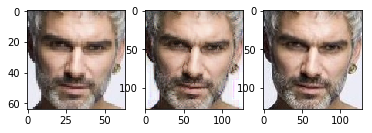

Step 6400:
    [D losses: Total=-0.046299, Wass_fake=-0.170654, Wass_real=0.122535, Wass_grad=0.001819]
    [G losses: Total=0.182958, Wass=0.176623, MSE=0.006335]


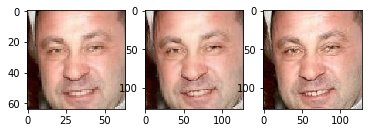

Step 6420:
    [D losses: Total=-0.029550, Wass_fake=-0.165295, Wass_real=0.129760, Wass_grad=0.005985]
    [G losses: Total=0.186408, Wass=0.179229, MSE=0.007179]


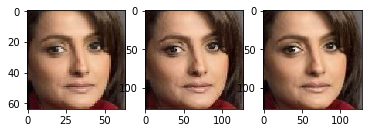

Step 6440:
    [D losses: Total=-0.031662, Wass_fake=-0.146054, Wass_real=0.113851, Wass_grad=0.000541]
    [G losses: Total=0.161431, Wass=0.156138, MSE=0.005293]


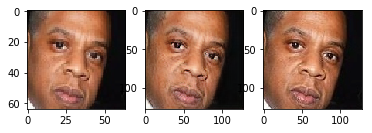

Step 6460:
    [D losses: Total=-0.033043, Wass_fake=-0.171637, Wass_real=0.135645, Wass_grad=0.002949]
    [G losses: Total=0.177492, Wass=0.171497, MSE=0.005996]


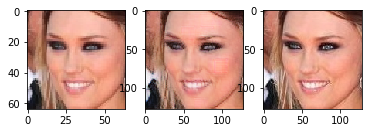

Step 6480:
    [D losses: Total=-0.043099, Wass_fake=-0.179772, Wass_real=0.133180, Wass_grad=0.003493]
    [G losses: Total=0.169905, Wass=0.163269, MSE=0.006637]


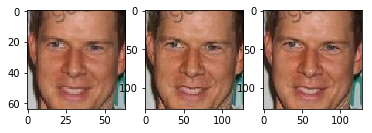

Step 6500:
    [D losses: Total=-0.046822, Wass_fake=-0.176086, Wass_real=0.124672, Wass_grad=0.004592]
    [G losses: Total=0.189700, Wass=0.181813, MSE=0.007887]


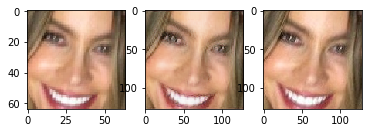

Step 6520:
    [D losses: Total=-0.037222, Wass_fake=-0.176505, Wass_real=0.134745, Wass_grad=0.004538]
    [G losses: Total=0.173969, Wass=0.166803, MSE=0.007167]


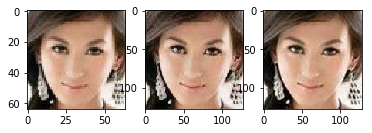

Step 6540:
    [D losses: Total=-0.040202, Wass_fake=-0.157006, Wass_real=0.109225, Wass_grad=0.007579]
    [G losses: Total=0.162434, Wass=0.155039, MSE=0.007396]


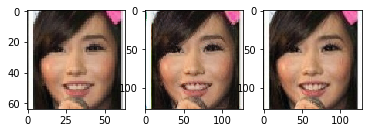

Step 6560:
    [D losses: Total=-0.033826, Wass_fake=-0.149254, Wass_real=0.114403, Wass_grad=0.001024]
    [G losses: Total=0.162186, Wass=0.155516, MSE=0.006669]


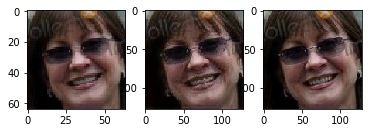

Step 6580:
    [D losses: Total=-0.047560, Wass_fake=-0.182524, Wass_real=0.133037, Wass_grad=0.001927]
    [G losses: Total=0.184026, Wass=0.175555, MSE=0.008471]


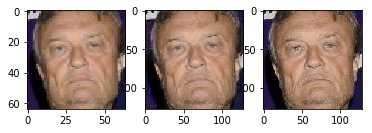

Step 6600:
    [D losses: Total=-0.038139, Wass_fake=-0.173845, Wass_real=0.134806, Wass_grad=0.000900]
    [G losses: Total=0.184860, Wass=0.178544, MSE=0.006316]


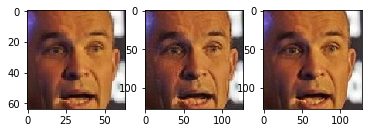

Step 6620:
    [D losses: Total=-0.058300, Wass_fake=-0.183913, Wass_real=0.124337, Wass_grad=0.001276]
    [G losses: Total=0.194050, Wass=0.186975, MSE=0.007075]


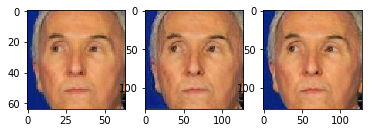

Step 6640:
    [D losses: Total=-0.026731, Wass_fake=-0.158920, Wass_real=0.129288, Wass_grad=0.002901]
    [G losses: Total=0.184402, Wass=0.177716, MSE=0.006686]


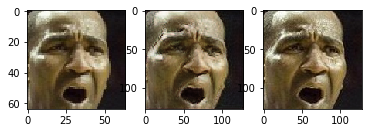

Step 6660:
    [D losses: Total=-0.031520, Wass_fake=-0.151956, Wass_real=0.119057, Wass_grad=0.001378]
    [G losses: Total=0.159811, Wass=0.153456, MSE=0.006355]


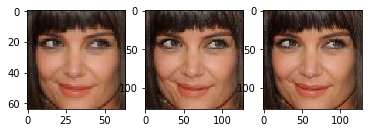

Step 6680:
    [D losses: Total=-0.032014, Wass_fake=-0.153063, Wass_real=0.114913, Wass_grad=0.006136]
    [G losses: Total=0.168301, Wass=0.162563, MSE=0.005738]


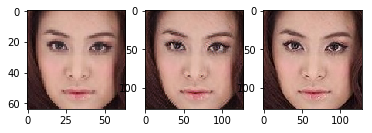

Step 6700:
    [D losses: Total=-0.050304, Wass_fake=-0.187225, Wass_real=0.135192, Wass_grad=0.001729]
    [G losses: Total=0.193357, Wass=0.186308, MSE=0.007050]


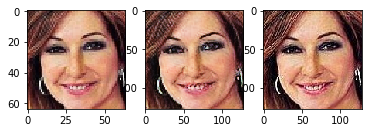

Step 6720:
    [D losses: Total=-0.021739, Wass_fake=-0.158602, Wass_real=0.129502, Wass_grad=0.007361]
    [G losses: Total=0.187494, Wass=0.181177, MSE=0.006317]


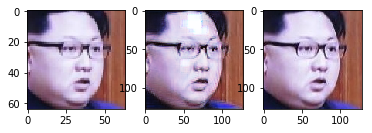

Step 6740:
    [D losses: Total=-0.052028, Wass_fake=-0.170714, Wass_real=0.116683, Wass_grad=0.002004]
    [G losses: Total=0.153396, Wass=0.147698, MSE=0.005698]


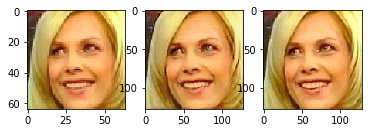

Step 6760:
    [D losses: Total=-0.044554, Wass_fake=-0.176403, Wass_real=0.127984, Wass_grad=0.003865]
    [G losses: Total=0.169155, Wass=0.163228, MSE=0.005927]


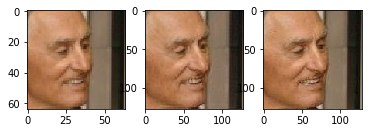

Step 6780:
    [D losses: Total=-0.030349, Wass_fake=-0.164454, Wass_real=0.130912, Wass_grad=0.003193]
    [G losses: Total=0.196741, Wass=0.188963, MSE=0.007778]


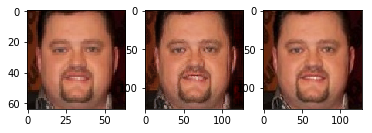

Step 6800:
    [D losses: Total=-0.041610, Wass_fake=-0.168853, Wass_real=0.124578, Wass_grad=0.002665]
    [G losses: Total=0.159114, Wass=0.151730, MSE=0.007384]


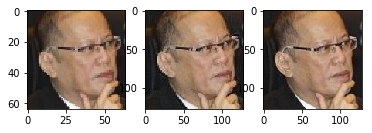

Step 6820:
    [D losses: Total=-0.039024, Wass_fake=-0.157955, Wass_real=0.117800, Wass_grad=0.001131]
    [G losses: Total=0.172767, Wass=0.166354, MSE=0.006413]


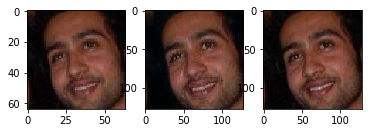

Step 6840:
    [D losses: Total=-0.050710, Wass_fake=-0.178254, Wass_real=0.121272, Wass_grad=0.006272]
    [G losses: Total=0.169998, Wass=0.163054, MSE=0.006944]


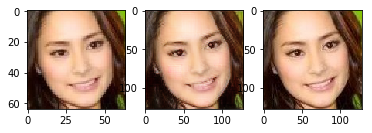

Step 6860:
    [D losses: Total=-0.037418, Wass_fake=-0.160523, Wass_real=0.122044, Wass_grad=0.001061]
    [G losses: Total=0.193302, Wass=0.186684, MSE=0.006618]


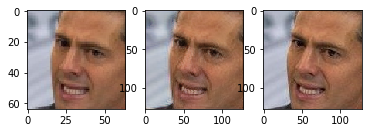

Step 6880:
    [D losses: Total=-0.042115, Wass_fake=-0.170255, Wass_real=0.126972, Wass_grad=0.001168]
    [G losses: Total=0.178253, Wass=0.171023, MSE=0.007231]


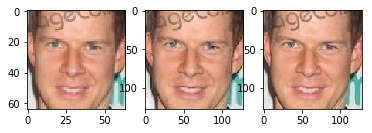

Step 6900:
    [D losses: Total=-0.031999, Wass_fake=-0.167530, Wass_real=0.132607, Wass_grad=0.002924]
    [G losses: Total=0.189486, Wass=0.180958, MSE=0.008528]


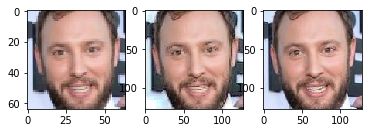

Step 6920:
    [D losses: Total=-0.019457, Wass_fake=-0.139450, Wass_real=0.107485, Wass_grad=0.012507]
    [G losses: Total=0.165365, Wass=0.159182, MSE=0.006182]


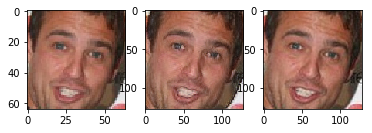

Step 6940:
    [D losses: Total=-0.028973, Wass_fake=-0.169367, Wass_real=0.126529, Wass_grad=0.013866]
    [G losses: Total=0.186775, Wass=0.179945, MSE=0.006830]


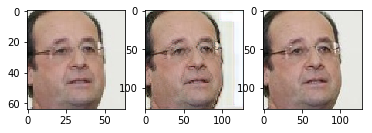

Step 6960:
    [D losses: Total=-0.040018, Wass_fake=-0.174069, Wass_real=0.131590, Wass_grad=0.002461]
    [G losses: Total=0.161741, Wass=0.156042, MSE=0.005699]


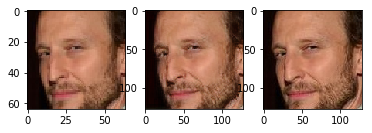

Step 6980:
    [D losses: Total=-0.032391, Wass_fake=-0.158171, Wass_real=0.123751, Wass_grad=0.002029]
    [G losses: Total=0.180572, Wass=0.173656, MSE=0.006916]


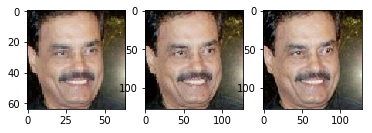

Step 7000:
    [D losses: Total=-0.045092, Wass_fake=-0.170894, Wass_real=0.121859, Wass_grad=0.003943]
    [G losses: Total=0.172973, Wass=0.166244, MSE=0.006729]


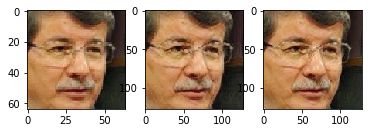

Step 7020:
    [D losses: Total=-0.047712, Wass_fake=-0.178494, Wass_real=0.130110, Wass_grad=0.000672]
    [G losses: Total=0.174258, Wass=0.168496, MSE=0.005762]


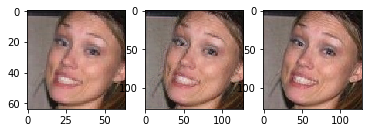

Step 7040:
    [D losses: Total=-0.049357, Wass_fake=-0.179321, Wass_real=0.128918, Wass_grad=0.001046]
    [G losses: Total=0.164309, Wass=0.156837, MSE=0.007471]


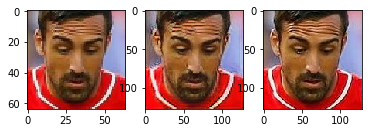

Step 7060:
    [D losses: Total=-0.040084, Wass_fake=-0.165704, Wass_real=0.122407, Wass_grad=0.003212]
    [G losses: Total=0.176521, Wass=0.168867, MSE=0.007654]


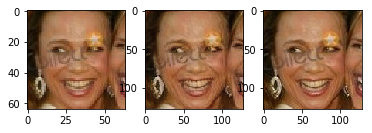

Step 7080:
    [D losses: Total=-0.070349, Wass_fake=-0.187887, Wass_real=0.115398, Wass_grad=0.002140]
    [G losses: Total=0.170083, Wass=0.163318, MSE=0.006765]


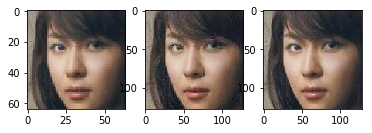

Step 7100:
    [D losses: Total=-0.028407, Wass_fake=-0.158727, Wass_real=0.129082, Wass_grad=0.001238]
    [G losses: Total=0.177834, Wass=0.172102, MSE=0.005732]


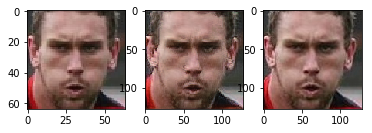

Step 7120:
    [D losses: Total=-0.041600, Wass_fake=-0.165816, Wass_real=0.120543, Wass_grad=0.003672]
    [G losses: Total=0.169701, Wass=0.164209, MSE=0.005492]


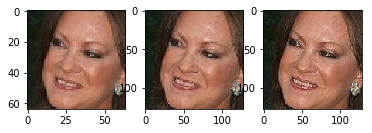

Step 7140:
    [D losses: Total=-0.058208, Wass_fake=-0.195576, Wass_real=0.133145, Wass_grad=0.004223]
    [G losses: Total=0.188514, Wass=0.181746, MSE=0.006768]


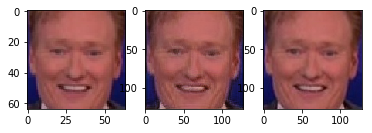

Step 7160:
    [D losses: Total=-0.027911, Wass_fake=-0.156554, Wass_real=0.122917, Wass_grad=0.005727]
    [G losses: Total=0.169944, Wass=0.163787, MSE=0.006157]


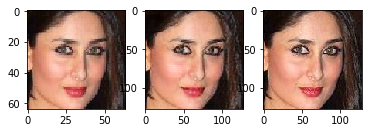

Step 7180:
    [D losses: Total=-0.054728, Wass_fake=-0.188485, Wass_real=0.130706, Wass_grad=0.003051]
    [G losses: Total=0.185928, Wass=0.179238, MSE=0.006690]


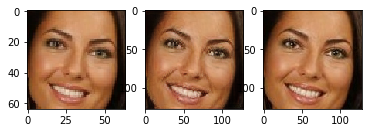

Step 7200:
    [D losses: Total=-0.033888, Wass_fake=-0.160812, Wass_real=0.121977, Wass_grad=0.004947]
    [G losses: Total=0.182856, Wass=0.177132, MSE=0.005724]


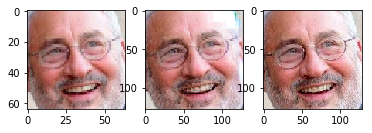

Step 7220:
    [D losses: Total=-0.056357, Wass_fake=-0.187020, Wass_real=0.128939, Wass_grad=0.001724]
    [G losses: Total=0.160774, Wass=0.156545, MSE=0.004229]


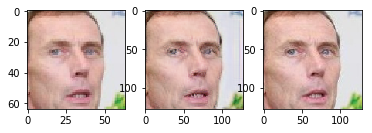

Step 7240:
    [D losses: Total=-0.045647, Wass_fake=-0.177358, Wass_real=0.130897, Wass_grad=0.000815]
    [G losses: Total=0.169386, Wass=0.164595, MSE=0.004791]


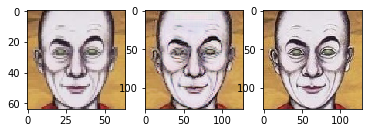

Step 7260:
    [D losses: Total=-0.051937, Wass_fake=-0.179355, Wass_real=0.126337, Wass_grad=0.001081]
    [G losses: Total=0.160808, Wass=0.153889, MSE=0.006919]


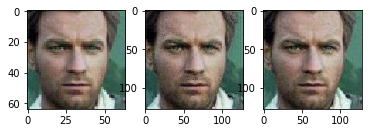

Step 7280:
    [D losses: Total=-0.034134, Wass_fake=-0.164018, Wass_real=0.127559, Wass_grad=0.002325]
    [G losses: Total=0.177747, Wass=0.170479, MSE=0.007268]


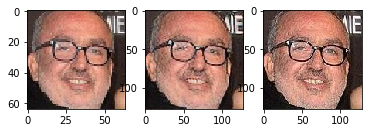

Step 7300:
    [D losses: Total=-0.027002, Wass_fake=-0.164305, Wass_real=0.135442, Wass_grad=0.001861]
    [G losses: Total=0.190047, Wass=0.182326, MSE=0.007721]


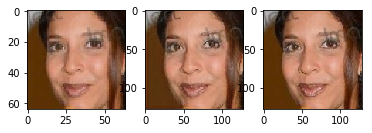

Step 7320:
    [D losses: Total=-0.029323, Wass_fake=-0.164982, Wass_real=0.129375, Wass_grad=0.006284]
    [G losses: Total=0.177724, Wass=0.171092, MSE=0.006632]


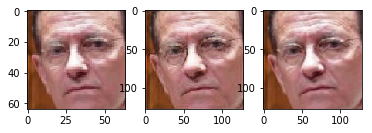

Step 7340:
    [D losses: Total=-0.034753, Wass_fake=-0.179371, Wass_real=0.138917, Wass_grad=0.005701]
    [G losses: Total=0.172255, Wass=0.166566, MSE=0.005689]


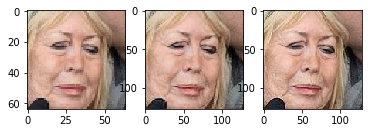

Step 7360:
    [D losses: Total=-0.048859, Wass_fake=-0.188881, Wass_real=0.137830, Wass_grad=0.002192]
    [G losses: Total=0.199034, Wass=0.191421, MSE=0.007613]


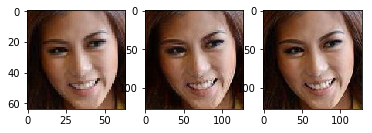

Step 7380:
    [D losses: Total=-0.039494, Wass_fake=-0.172661, Wass_real=0.131068, Wass_grad=0.002098]
    [G losses: Total=0.186328, Wass=0.180544, MSE=0.005783]


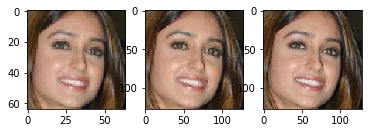

Step 7400:
    [D losses: Total=-0.043093, Wass_fake=-0.182924, Wass_real=0.133219, Wass_grad=0.006612]
    [G losses: Total=0.185627, Wass=0.178516, MSE=0.007110]


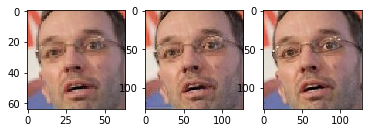

Step 7420:
    [D losses: Total=-0.047595, Wass_fake=-0.191238, Wass_real=0.131056, Wass_grad=0.012588]
    [G losses: Total=0.182773, Wass=0.175327, MSE=0.007446]


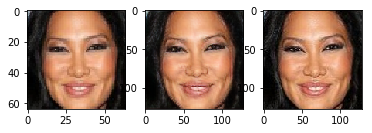

Step 7440:
    [D losses: Total=-0.042895, Wass_fake=-0.164713, Wass_real=0.120361, Wass_grad=0.001456]
    [G losses: Total=0.196296, Wass=0.187590, MSE=0.008706]


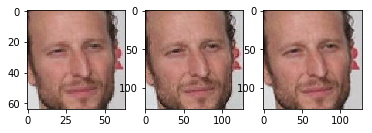

Step 7460:
    [D losses: Total=-0.047512, Wass_fake=-0.157782, Wass_real=0.107039, Wass_grad=0.003230]
    [G losses: Total=0.158739, Wass=0.152935, MSE=0.005804]


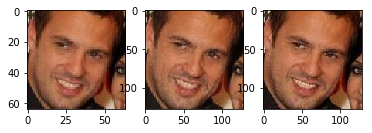

Step 7480:
    [D losses: Total=-0.057050, Wass_fake=-0.178809, Wass_real=0.117215, Wass_grad=0.004544]
    [G losses: Total=0.149139, Wass=0.142918, MSE=0.006221]


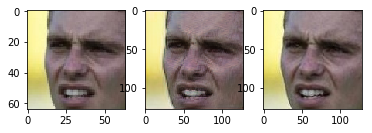

Step 7500:
    [D losses: Total=-0.042699, Wass_fake=-0.173751, Wass_real=0.125637, Wass_grad=0.005415]
    [G losses: Total=0.189620, Wass=0.182605, MSE=0.007015]


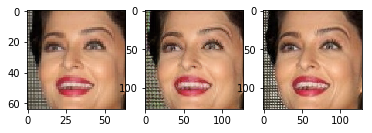

Step 7520:
    [D losses: Total=-0.036968, Wass_fake=-0.163978, Wass_real=0.120531, Wass_grad=0.006479]
    [G losses: Total=0.168579, Wass=0.162241, MSE=0.006338]


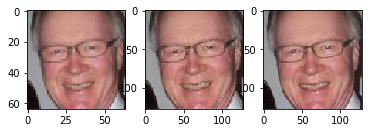

Step 7540:
    [D losses: Total=-0.033803, Wass_fake=-0.152940, Wass_real=0.115193, Wass_grad=0.003944]
    [G losses: Total=0.172424, Wass=0.164804, MSE=0.007620]


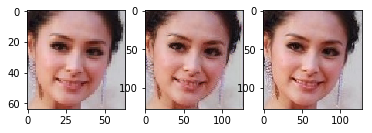

Step 7560:
    [D losses: Total=-0.037816, Wass_fake=-0.182913, Wass_real=0.141207, Wass_grad=0.003890]
    [G losses: Total=0.167855, Wass=0.161228, MSE=0.006628]


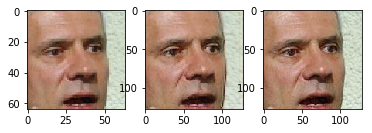

Step 7580:
    [D losses: Total=-0.027631, Wass_fake=-0.165611, Wass_real=0.130559, Wass_grad=0.007422]
    [G losses: Total=0.180986, Wass=0.173671, MSE=0.007316]


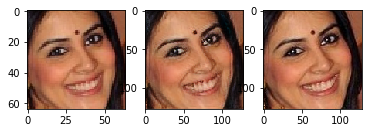

Step 7600:
    [D losses: Total=-0.049213, Wass_fake=-0.189883, Wass_real=0.134421, Wass_grad=0.006249]
    [G losses: Total=0.188620, Wass=0.181476, MSE=0.007144]


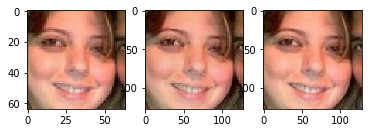

Step 7620:
    [D losses: Total=-0.037040, Wass_fake=-0.166275, Wass_real=0.124986, Wass_grad=0.004249]
    [G losses: Total=0.179921, Wass=0.174062, MSE=0.005859]


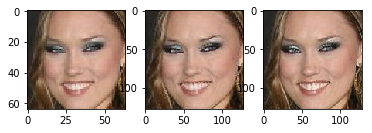

Step 7640:
    [D losses: Total=-0.050082, Wass_fake=-0.177064, Wass_real=0.126192, Wass_grad=0.000790]
    [G losses: Total=0.169613, Wass=0.163564, MSE=0.006049]


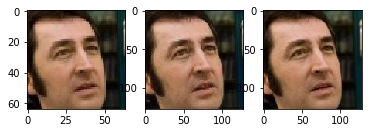

Step 7660:
    [D losses: Total=-0.030514, Wass_fake=-0.156613, Wass_real=0.123614, Wass_grad=0.002485]
    [G losses: Total=0.188855, Wass=0.182497, MSE=0.006358]


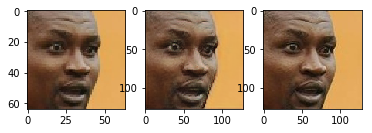

Step 7680:
    [D losses: Total=-0.032266, Wass_fake=-0.153736, Wass_real=0.117360, Wass_grad=0.004110]
    [G losses: Total=0.174997, Wass=0.168741, MSE=0.006257]


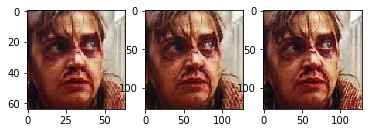

Step 7700:
    [D losses: Total=-0.039904, Wass_fake=-0.173360, Wass_real=0.129591, Wass_grad=0.003865]
    [G losses: Total=0.192390, Wass=0.184882, MSE=0.007508]


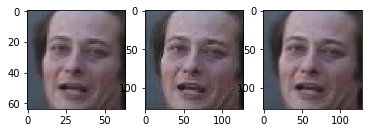

Step 7720:
    [D losses: Total=-0.044763, Wass_fake=-0.176286, Wass_real=0.128213, Wass_grad=0.003310]
    [G losses: Total=0.177394, Wass=0.170758, MSE=0.006636]


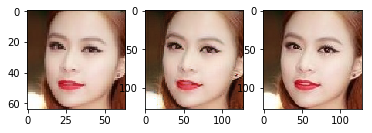

Step 7740:
    [D losses: Total=-0.029311, Wass_fake=-0.159295, Wass_real=0.121324, Wass_grad=0.008660]
    [G losses: Total=0.175476, Wass=0.168702, MSE=0.006773]


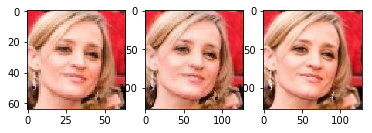

Step 7760:
    [D losses: Total=-0.031166, Wass_fake=-0.151657, Wass_real=0.119204, Wass_grad=0.001286]
    [G losses: Total=0.165817, Wass=0.158922, MSE=0.006894]


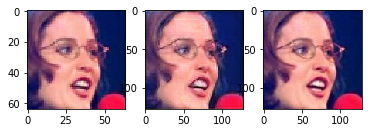

Step 7780:
    [D losses: Total=-0.045793, Wass_fake=-0.180523, Wass_real=0.133319, Wass_grad=0.001410]
    [G losses: Total=0.177989, Wass=0.170842, MSE=0.007147]


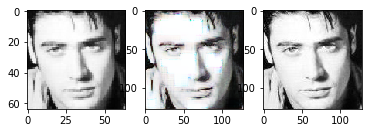

Step 7800:
    [D losses: Total=-0.043429, Wass_fake=-0.170757, Wass_real=0.126027, Wass_grad=0.001300]
    [G losses: Total=0.172285, Wass=0.164490, MSE=0.007795]


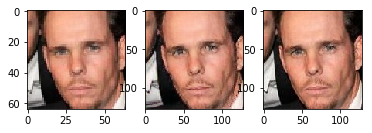

Step 7820:
    [D losses: Total=-0.036177, Wass_fake=-0.149806, Wass_real=0.110002, Wass_grad=0.003627]
    [G losses: Total=0.173177, Wass=0.168006, MSE=0.005171]


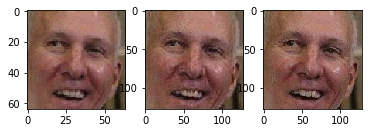

Step 7840:
    [D losses: Total=-0.029304, Wass_fake=-0.169950, Wass_real=0.132006, Wass_grad=0.008639]
    [G losses: Total=0.188343, Wass=0.181113, MSE=0.007230]


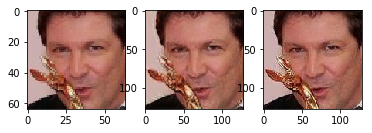

Step 7860:
    [D losses: Total=-0.044380, Wass_fake=-0.183457, Wass_real=0.136723, Wass_grad=0.002354]
    [G losses: Total=0.172498, Wass=0.163650, MSE=0.008848]


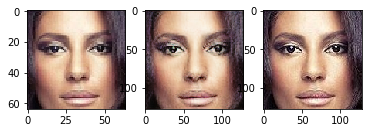

Step 7880:
    [D losses: Total=-0.029692, Wass_fake=-0.163187, Wass_real=0.131165, Wass_grad=0.002331]
    [G losses: Total=0.170591, Wass=0.161442, MSE=0.009150]


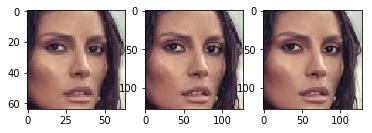

Step 7900:
    [D losses: Total=-0.053886, Wass_fake=-0.185872, Wass_real=0.128873, Wass_grad=0.003113]
    [G losses: Total=0.197369, Wass=0.190530, MSE=0.006839]


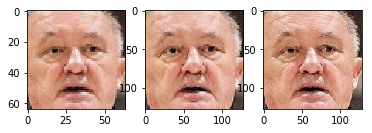

Step 7920:
    [D losses: Total=-0.046590, Wass_fake=-0.168810, Wass_real=0.118900, Wass_grad=0.003320]
    [G losses: Total=0.180673, Wass=0.174967, MSE=0.005707]


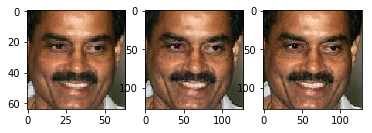

Step 7940:
    [D losses: Total=-0.047051, Wass_fake=-0.171034, Wass_real=0.122765, Wass_grad=0.001218]
    [G losses: Total=0.179961, Wass=0.171231, MSE=0.008730]


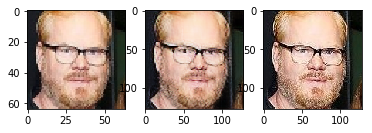

Step 7960:
    [D losses: Total=-0.039945, Wass_fake=-0.176155, Wass_real=0.130141, Wass_grad=0.006070]
    [G losses: Total=0.188789, Wass=0.182738, MSE=0.006051]


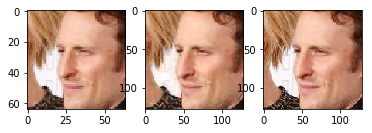

Step 7980:
    [D losses: Total=-0.032789, Wass_fake=-0.164614, Wass_real=0.130833, Wass_grad=0.000992]
    [G losses: Total=0.190987, Wass=0.183237, MSE=0.007750]


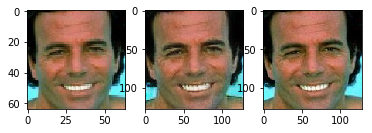

Step 8000:
    [D losses: Total=-0.034486, Wass_fake=-0.153938, Wass_real=0.116924, Wass_grad=0.002528]
    [G losses: Total=0.164965, Wass=0.157754, MSE=0.007211]


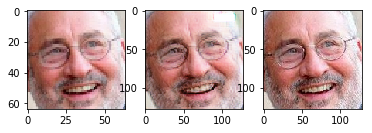

Step 8020:
    [D losses: Total=-0.046446, Wass_fake=-0.175546, Wass_real=0.126581, Wass_grad=0.002520]
    [G losses: Total=0.171135, Wass=0.163326, MSE=0.007810]


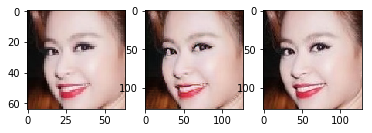

Step 8040:
    [D losses: Total=-0.035220, Wass_fake=-0.158473, Wass_real=0.115754, Wass_grad=0.007499]
    [G losses: Total=0.157434, Wass=0.151784, MSE=0.005650]


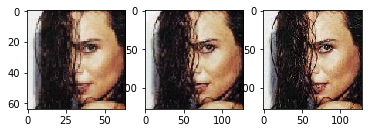

Step 8060:
    [D losses: Total=-0.038696, Wass_fake=-0.158908, Wass_real=0.118783, Wass_grad=0.001429]
    [G losses: Total=0.148153, Wass=0.142559, MSE=0.005594]


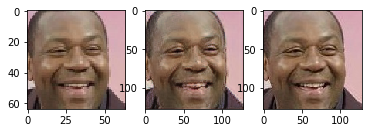

Step 8080:
    [D losses: Total=-0.035335, Wass_fake=-0.183095, Wass_real=0.139482, Wass_grad=0.008279]
    [G losses: Total=0.173328, Wass=0.167954, MSE=0.005374]


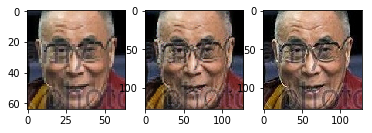

Step 8100:
    [D losses: Total=-0.042726, Wass_fake=-0.166018, Wass_real=0.122335, Wass_grad=0.000957]
    [G losses: Total=0.164409, Wass=0.158172, MSE=0.006237]


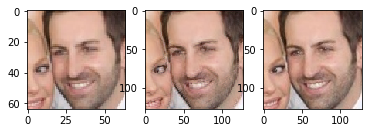

Step 8120:
    [D losses: Total=-0.040834, Wass_fake=-0.176260, Wass_real=0.130438, Wass_grad=0.004988]
    [G losses: Total=0.168760, Wass=0.163448, MSE=0.005312]


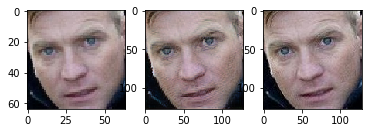

Step 8140:
    [D losses: Total=-0.057540, Wass_fake=-0.181775, Wass_real=0.123248, Wass_grad=0.000987]
    [G losses: Total=0.174433, Wass=0.169019, MSE=0.005414]


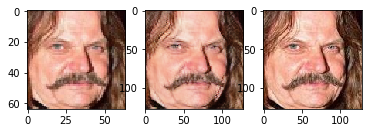

Step 8160:
    [D losses: Total=-0.033060, Wass_fake=-0.148185, Wass_real=0.110031, Wass_grad=0.005094]
    [G losses: Total=0.172097, Wass=0.163894, MSE=0.008204]


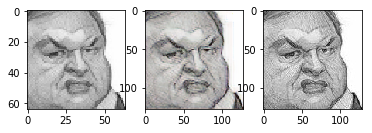

Step 8180:
    [D losses: Total=-0.058985, Wass_fake=-0.184507, Wass_real=0.124573, Wass_grad=0.000949]
    [G losses: Total=0.161947, Wass=0.155849, MSE=0.006098]


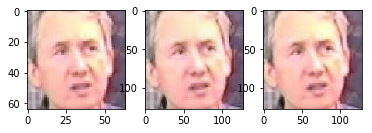

Step 8200:
    [D losses: Total=-0.027859, Wass_fake=-0.161103, Wass_real=0.131763, Wass_grad=0.001481]
    [G losses: Total=0.170043, Wass=0.163433, MSE=0.006609]


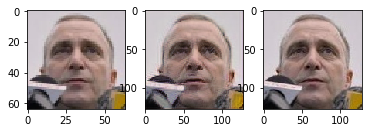

Step 8220:
    [D losses: Total=-0.031615, Wass_fake=-0.159331, Wass_real=0.119754, Wass_grad=0.007963]
    [G losses: Total=0.181747, Wass=0.174862, MSE=0.006885]


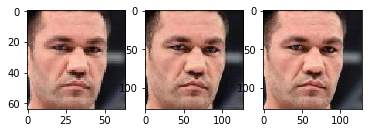

Step 8240:
    [D losses: Total=-0.028472, Wass_fake=-0.152419, Wass_real=0.120350, Wass_grad=0.003598]
    [G losses: Total=0.177424, Wass=0.170660, MSE=0.006764]


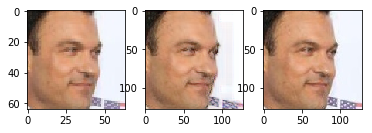

Step 8260:
    [D losses: Total=-0.029030, Wass_fake=-0.157840, Wass_real=0.119475, Wass_grad=0.009335]
    [G losses: Total=0.178947, Wass=0.172619, MSE=0.006328]


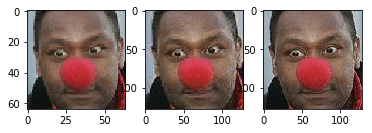

Step 8280:
    [D losses: Total=-0.046104, Wass_fake=-0.175824, Wass_real=0.126651, Wass_grad=0.003069]
    [G losses: Total=0.176855, Wass=0.170845, MSE=0.006010]


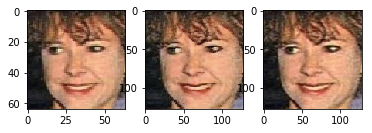

Step 8300:
    [D losses: Total=-0.041551, Wass_fake=-0.160881, Wass_real=0.118699, Wass_grad=0.000630]
    [G losses: Total=0.160009, Wass=0.154510, MSE=0.005499]


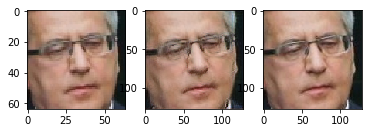

Step 8320:
    [D losses: Total=-0.049686, Wass_fake=-0.167017, Wass_real=0.115449, Wass_grad=0.001882]
    [G losses: Total=0.162033, Wass=0.155897, MSE=0.006137]


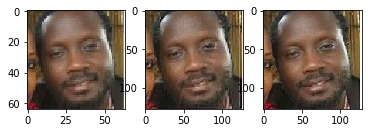

Step 8340:
    [D losses: Total=-0.036362, Wass_fake=-0.175621, Wass_real=0.137107, Wass_grad=0.002153]
    [G losses: Total=0.183648, Wass=0.176884, MSE=0.006764]


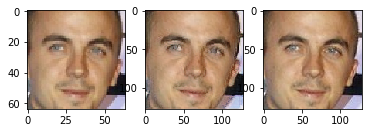

Step 8360:
    [D losses: Total=-0.039082, Wass_fake=-0.163104, Wass_real=0.122240, Wass_grad=0.001782]
    [G losses: Total=0.180268, Wass=0.173530, MSE=0.006738]


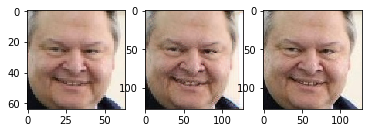

Step 8380:
    [D losses: Total=-0.044075, Wass_fake=-0.180131, Wass_real=0.127255, Wass_grad=0.008801]
    [G losses: Total=0.191465, Wass=0.185010, MSE=0.006455]


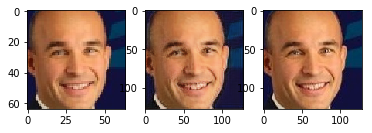

Step 8400:
    [D losses: Total=-0.058482, Wass_fake=-0.184985, Wass_real=0.124777, Wass_grad=0.001726]
    [G losses: Total=0.173024, Wass=0.165123, MSE=0.007901]


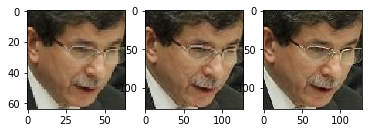

Step 8420:
    [D losses: Total=-0.041670, Wass_fake=-0.171400, Wass_real=0.128055, Wass_grad=0.001675]
    [G losses: Total=0.180521, Wass=0.173777, MSE=0.006744]


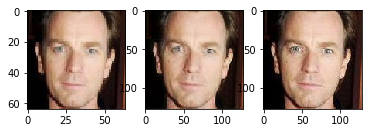

Step 8440:
    [D losses: Total=-0.031253, Wass_fake=-0.161104, Wass_real=0.128384, Wass_grad=0.001467]
    [G losses: Total=0.174961, Wass=0.169205, MSE=0.005756]


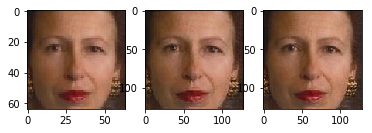

Step 8460:
    [D losses: Total=-0.034523, Wass_fake=-0.158267, Wass_real=0.122548, Wass_grad=0.001195]
    [G losses: Total=0.167497, Wass=0.160190, MSE=0.007307]


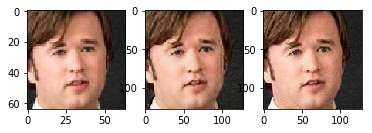

Step 8480:
    [D losses: Total=-0.031950, Wass_fake=-0.155803, Wass_real=0.121736, Wass_grad=0.002117]
    [G losses: Total=0.164244, Wass=0.158231, MSE=0.006013]


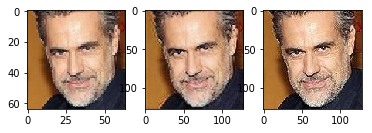

Step 8500:
    [D losses: Total=-0.028810, Wass_fake=-0.152078, Wass_real=0.121016, Wass_grad=0.002252]
    [G losses: Total=0.163456, Wass=0.158167, MSE=0.005289]


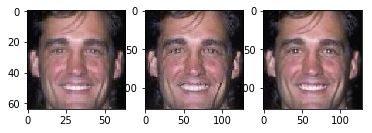

Step 8520:
    [D losses: Total=-0.059141, Wass_fake=-0.198215, Wass_real=0.133197, Wass_grad=0.005877]
    [G losses: Total=0.169945, Wass=0.162601, MSE=0.007345]


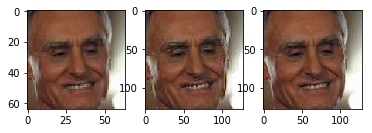

Step 8540:
    [D losses: Total=-0.033208, Wass_fake=-0.154768, Wass_real=0.120190, Wass_grad=0.001370]
    [G losses: Total=0.157469, Wass=0.151943, MSE=0.005527]


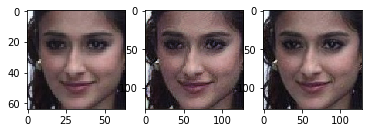

Step 8560:
    [D losses: Total=-0.016438, Wass_fake=-0.154475, Wass_real=0.122146, Wass_grad=0.015892]
    [G losses: Total=0.197685, Wass=0.190956, MSE=0.006729]


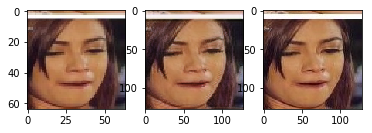

Step 8580:
    [D losses: Total=-0.050056, Wass_fake=-0.182079, Wass_real=0.131248, Wass_grad=0.000775]
    [G losses: Total=0.197591, Wass=0.188892, MSE=0.008699]


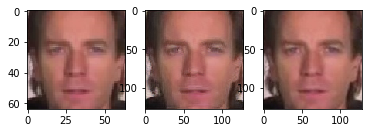

Step 8600:
    [D losses: Total=-0.027348, Wass_fake=-0.156167, Wass_real=0.127465, Wass_grad=0.001353]
    [G losses: Total=0.175695, Wass=0.168106, MSE=0.007589]


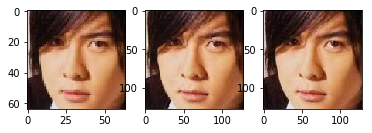

Step 8620:
    [D losses: Total=-0.031439, Wass_fake=-0.165146, Wass_real=0.132240, Wass_grad=0.001467]
    [G losses: Total=0.176071, Wass=0.169408, MSE=0.006664]


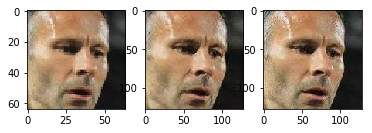

Step 8640:
    [D losses: Total=-0.034587, Wass_fake=-0.166534, Wass_real=0.130073, Wass_grad=0.001874]
    [G losses: Total=0.189973, Wass=0.182884, MSE=0.007089]


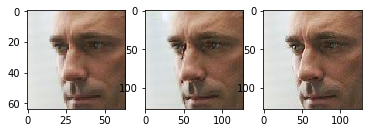

Step 8660:
    [D losses: Total=-0.047857, Wass_fake=-0.184312, Wass_real=0.135411, Wass_grad=0.001044]
    [G losses: Total=0.190662, Wass=0.184861, MSE=0.005801]


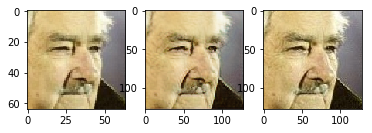

Step 8680:
    [D losses: Total=-0.036350, Wass_fake=-0.164619, Wass_real=0.126543, Wass_grad=0.001725]
    [G losses: Total=0.169315, Wass=0.164071, MSE=0.005244]


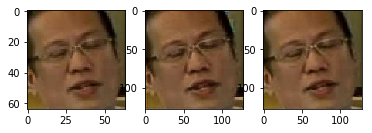

Step 8700:
    [D losses: Total=-0.042768, Wass_fake=-0.190592, Wass_real=0.140705, Wass_grad=0.007118]
    [G losses: Total=0.204437, Wass=0.196856, MSE=0.007581]


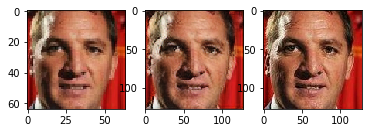

Step 8720:
    [D losses: Total=-0.037537, Wass_fake=-0.176813, Wass_real=0.132190, Wass_grad=0.007086]
    [G losses: Total=0.166712, Wass=0.160140, MSE=0.006572]


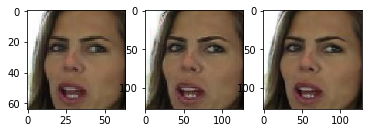

Step 8740:
    [D losses: Total=-0.035597, Wass_fake=-0.160173, Wass_real=0.122619, Wass_grad=0.001956]
    [G losses: Total=0.180311, Wass=0.172371, MSE=0.007939]


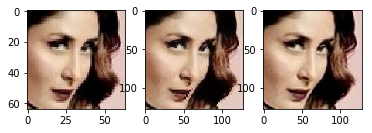

Step 8760:
    [D losses: Total=-0.035032, Wass_fake=-0.167962, Wass_real=0.128775, Wass_grad=0.004156]
    [G losses: Total=0.169855, Wass=0.164257, MSE=0.005597]


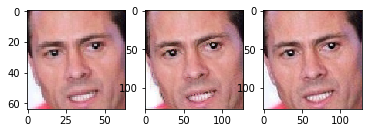

Step 8780:
    [D losses: Total=-0.036257, Wass_fake=-0.170686, Wass_real=0.133089, Wass_grad=0.001340]
    [G losses: Total=0.199264, Wass=0.191598, MSE=0.007666]


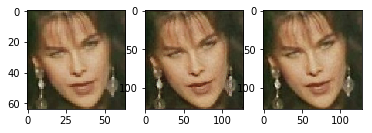

Step 8800:
    [D losses: Total=-0.041333, Wass_fake=-0.170150, Wass_real=0.127143, Wass_grad=0.001674]
    [G losses: Total=0.175869, Wass=0.169844, MSE=0.006026]


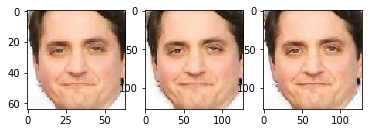

Step 8820:
    [D losses: Total=-0.048650, Wass_fake=-0.172621, Wass_real=0.122989, Wass_grad=0.000982]
    [G losses: Total=0.182910, Wass=0.177292, MSE=0.005617]


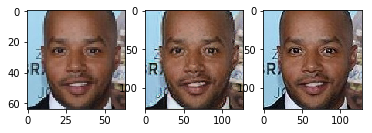

Step 8840:
    [D losses: Total=-0.034953, Wass_fake=-0.165587, Wass_real=0.119995, Wass_grad=0.010640]
    [G losses: Total=0.153581, Wass=0.146964, MSE=0.006617]


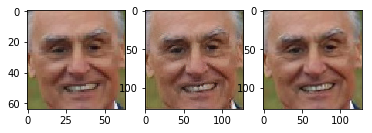

Step 8860:
    [D losses: Total=-0.046613, Wass_fake=-0.177381, Wass_real=0.121244, Wass_grad=0.009523]
    [G losses: Total=0.166425, Wass=0.160589, MSE=0.005836]


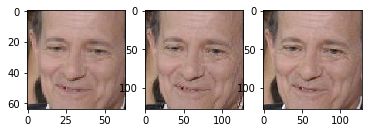

Step 8880:
    [D losses: Total=-0.046786, Wass_fake=-0.170141, Wass_real=0.119294, Wass_grad=0.004061]
    [G losses: Total=0.169646, Wass=0.161732, MSE=0.007913]


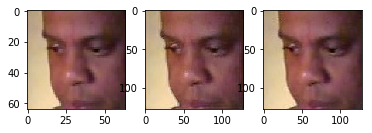

Step 8900:
    [D losses: Total=-0.038800, Wass_fake=-0.168530, Wass_real=0.127793, Wass_grad=0.001937]
    [G losses: Total=0.196577, Wass=0.187296, MSE=0.009281]


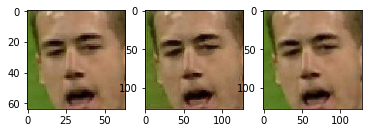

Step 8920:
    [D losses: Total=-0.034075, Wass_fake=-0.163945, Wass_real=0.128115, Wass_grad=0.001755]
    [G losses: Total=0.185872, Wass=0.179727, MSE=0.006145]


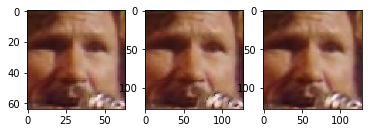

Step 8940:
    [D losses: Total=-0.037038, Wass_fake=-0.149287, Wass_real=0.109437, Wass_grad=0.002812]
    [G losses: Total=0.185976, Wass=0.177889, MSE=0.008087]


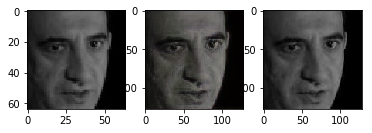

Step 8960:
    [D losses: Total=-0.032678, Wass_fake=-0.169091, Wass_real=0.129718, Wass_grad=0.006695]
    [G losses: Total=0.166598, Wass=0.160047, MSE=0.006551]


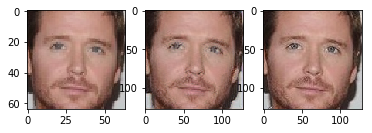

Step 8980:
    [D losses: Total=-0.039773, Wass_fake=-0.179045, Wass_real=0.136953, Wass_grad=0.002320]
    [G losses: Total=0.201011, Wass=0.193622, MSE=0.007389]


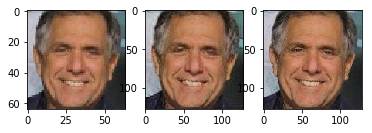

Step 9000:
    [D losses: Total=-0.030422, Wass_fake=-0.167792, Wass_real=0.132199, Wass_grad=0.005171]
    [G losses: Total=0.195069, Wass=0.187649, MSE=0.007420]


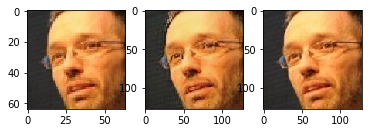

Step 9020:
    [D losses: Total=-0.037134, Wass_fake=-0.174275, Wass_real=0.134491, Wass_grad=0.002650]
    [G losses: Total=0.181473, Wass=0.173498, MSE=0.007975]


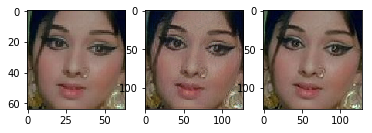

Step 9040:
    [D losses: Total=-0.040573, Wass_fake=-0.165683, Wass_real=0.123606, Wass_grad=0.001504]
    [G losses: Total=0.187739, Wass=0.180926, MSE=0.006813]


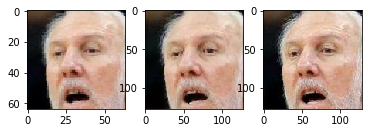

Step 9060:
    [D losses: Total=-0.036707, Wass_fake=-0.170812, Wass_real=0.124774, Wass_grad=0.009331]
    [G losses: Total=0.182149, Wass=0.175920, MSE=0.006229]


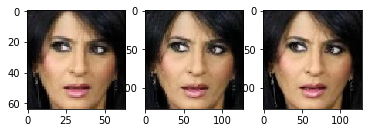

Step 9080:
    [D losses: Total=-0.044396, Wass_fake=-0.179894, Wass_real=0.130228, Wass_grad=0.005270]
    [G losses: Total=0.207759, Wass=0.198348, MSE=0.009410]


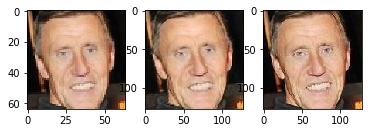

Step 9100:
    [D losses: Total=-0.038293, Wass_fake=-0.172059, Wass_real=0.126189, Wass_grad=0.007577]
    [G losses: Total=0.194245, Wass=0.186096, MSE=0.008149]


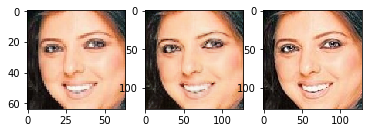

Step 9120:
    [D losses: Total=-0.032571, Wass_fake=-0.164135, Wass_real=0.124709, Wass_grad=0.006855]
    [G losses: Total=0.192263, Wass=0.185451, MSE=0.006812]


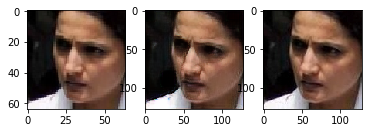

Step 9140:
    [D losses: Total=-0.046804, Wass_fake=-0.180644, Wass_real=0.132971, Wass_grad=0.000868]
    [G losses: Total=0.179411, Wass=0.172675, MSE=0.006736]


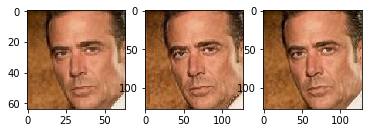

Step 9160:
    [D losses: Total=-0.022010, Wass_fake=-0.160456, Wass_real=0.125271, Wass_grad=0.013175]
    [G losses: Total=0.174286, Wass=0.168426, MSE=0.005860]


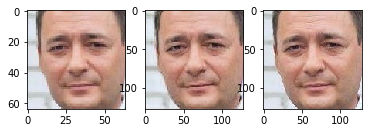

Step 9180:
    [D losses: Total=-0.032114, Wass_fake=-0.160323, Wass_real=0.126156, Wass_grad=0.002053]
    [G losses: Total=0.184314, Wass=0.174546, MSE=0.009768]


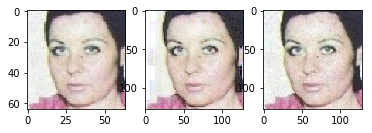

Step 9200:
    [D losses: Total=-0.031015, Wass_fake=-0.156626, Wass_real=0.124514, Wass_grad=0.001097]
    [G losses: Total=0.173528, Wass=0.167969, MSE=0.005559]


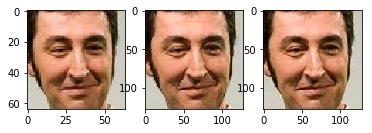

Step 9220:
    [D losses: Total=-0.037783, Wass_fake=-0.155676, Wass_real=0.114629, Wass_grad=0.003264]
    [G losses: Total=0.157105, Wass=0.150300, MSE=0.006806]


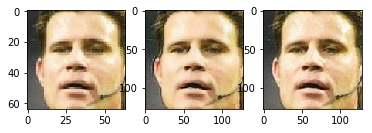

Step 9240:
    [D losses: Total=-0.028167, Wass_fake=-0.141618, Wass_real=0.110717, Wass_grad=0.002735]
    [G losses: Total=0.163527, Wass=0.155593, MSE=0.007934]


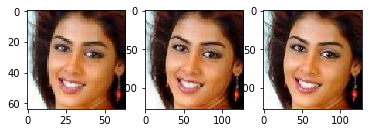

Step 9260:
    [D losses: Total=-0.035566, Wass_fake=-0.164221, Wass_real=0.127241, Wass_grad=0.001414]
    [G losses: Total=0.175298, Wass=0.169502, MSE=0.005797]


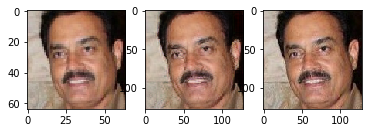

Step 9280:
    [D losses: Total=-0.062143, Wass_fake=-0.197670, Wass_real=0.133536, Wass_grad=0.001991]
    [G losses: Total=0.169727, Wass=0.163764, MSE=0.005963]


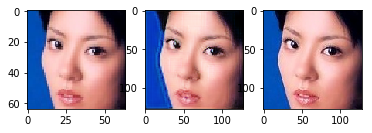

Step 9300:
    [D losses: Total=-0.034881, Wass_fake=-0.159727, Wass_real=0.121011, Wass_grad=0.003834]
    [G losses: Total=0.173466, Wass=0.168331, MSE=0.005135]


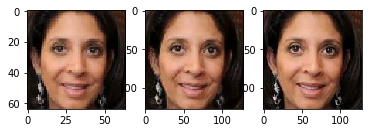

Step 9320:
    [D losses: Total=-0.061688, Wass_fake=-0.189523, Wass_real=0.123920, Wass_grad=0.003915]
    [G losses: Total=0.180563, Wass=0.174993, MSE=0.005570]


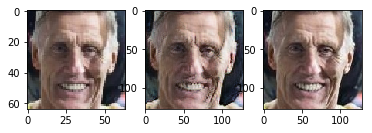

Step 9340:
    [D losses: Total=-0.030739, Wass_fake=-0.171450, Wass_real=0.128582, Wass_grad=0.012129]
    [G losses: Total=0.157937, Wass=0.152062, MSE=0.005876]


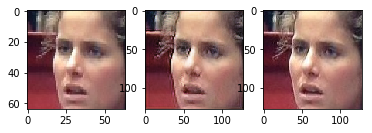

Step 9360:
    [D losses: Total=-0.025207, Wass_fake=-0.150620, Wass_real=0.120457, Wass_grad=0.004956]
    [G losses: Total=0.170218, Wass=0.164351, MSE=0.005867]


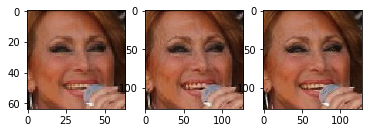

Step 9380:
    [D losses: Total=-0.044030, Wass_fake=-0.175697, Wass_real=0.130238, Wass_grad=0.001429]
    [G losses: Total=0.187288, Wass=0.180240, MSE=0.007048]


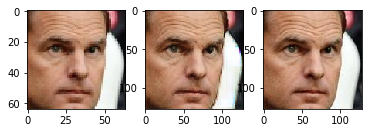

Step 9400:
    [D losses: Total=-0.031909, Wass_fake=-0.154689, Wass_real=0.120906, Wass_grad=0.001874]
    [G losses: Total=0.169153, Wass=0.161031, MSE=0.008122]


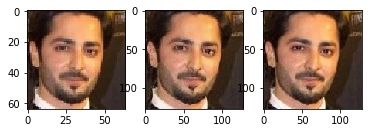

Step 9420:
    [D losses: Total=-0.071304, Wass_fake=-0.189974, Wass_real=0.115232, Wass_grad=0.003438]
    [G losses: Total=0.179242, Wass=0.172713, MSE=0.006530]


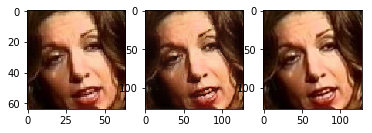

Step 9440:
    [D losses: Total=-0.037207, Wass_fake=-0.161154, Wass_real=0.122424, Wass_grad=0.001524]
    [G losses: Total=0.171997, Wass=0.165953, MSE=0.006044]


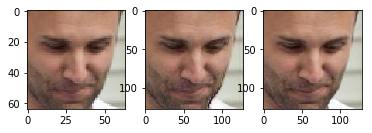

Step 9460:
    [D losses: Total=-0.030818, Wass_fake=-0.146511, Wass_real=0.113683, Wass_grad=0.002010]
    [G losses: Total=0.150138, Wass=0.143554, MSE=0.006583]


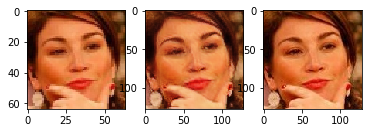

Step 9480:
    [D losses: Total=-0.032015, Wass_fake=-0.152104, Wass_real=0.118499, Wass_grad=0.001590]
    [G losses: Total=0.159825, Wass=0.152990, MSE=0.006835]


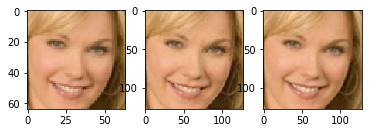

Step 9500:
    [D losses: Total=-0.033837, Wass_fake=-0.161415, Wass_real=0.125528, Wass_grad=0.002050]
    [G losses: Total=0.169235, Wass=0.164802, MSE=0.004433]


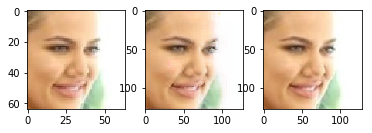

Step 9520:
    [D losses: Total=-0.039667, Wass_fake=-0.171299, Wass_real=0.130101, Wass_grad=0.001530]
    [G losses: Total=0.177804, Wass=0.171758, MSE=0.006046]


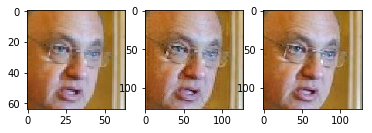

Step 9540:
    [D losses: Total=-0.068195, Wass_fake=-0.183952, Wass_real=0.109936, Wass_grad=0.005820]
    [G losses: Total=0.161668, Wass=0.156048, MSE=0.005621]


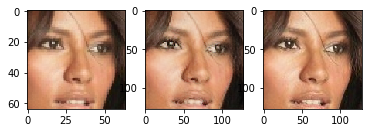

Step 9560:
    [D losses: Total=-0.027429, Wass_fake=-0.169266, Wass_real=0.135555, Wass_grad=0.006282]
    [G losses: Total=0.165111, Wass=0.158618, MSE=0.006492]


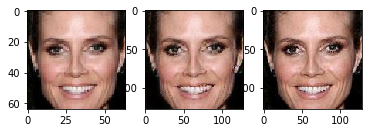

Step 9580:
    [D losses: Total=-0.057903, Wass_fake=-0.186635, Wass_real=0.127695, Wass_grad=0.001037]
    [G losses: Total=0.191389, Wass=0.182791, MSE=0.008598]


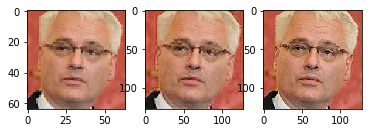

Step 9600:
    [D losses: Total=-0.046337, Wass_fake=-0.172962, Wass_real=0.124642, Wass_grad=0.001982]
    [G losses: Total=0.186523, Wass=0.180013, MSE=0.006510]


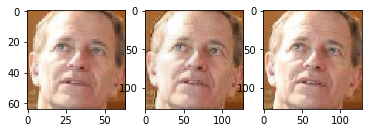

Step 9620:
    [D losses: Total=-0.028447, Wass_fake=-0.160555, Wass_real=0.129704, Wass_grad=0.002404]
    [G losses: Total=0.194292, Wass=0.187992, MSE=0.006300]


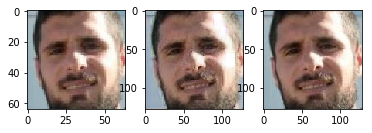

Step 9640:
    [D losses: Total=-0.031804, Wass_fake=-0.163588, Wass_real=0.125797, Wass_grad=0.005988]
    [G losses: Total=0.167745, Wass=0.161735, MSE=0.006010]


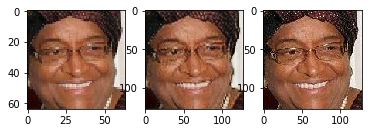

Step 9660:
    [D losses: Total=-0.045498, Wass_fake=-0.172350, Wass_real=0.125682, Wass_grad=0.001170]
    [G losses: Total=0.173824, Wass=0.167236, MSE=0.006588]


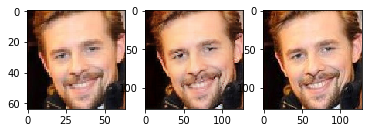

Step 9680:
    [D losses: Total=-0.023961, Wass_fake=-0.157862, Wass_real=0.127878, Wass_grad=0.006023]
    [G losses: Total=0.192324, Wass=0.184832, MSE=0.007493]


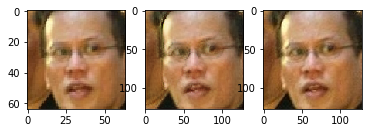

Step 9700:
    [D losses: Total=-0.034025, Wass_fake=-0.156791, Wass_real=0.121868, Wass_grad=0.000898]
    [G losses: Total=0.169933, Wass=0.162638, MSE=0.007295]


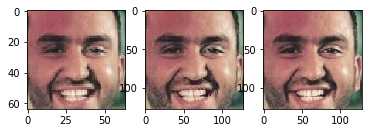

Step 9720:
    [D losses: Total=-0.027057, Wass_fake=-0.158604, Wass_real=0.127918, Wass_grad=0.003629]
    [G losses: Total=0.187860, Wass=0.181276, MSE=0.006584]


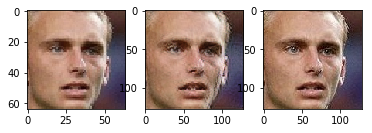

Step 9740:
    [D losses: Total=-0.038434, Wass_fake=-0.157453, Wass_real=0.117533, Wass_grad=0.001486]
    [G losses: Total=0.165449, Wass=0.159315, MSE=0.006135]


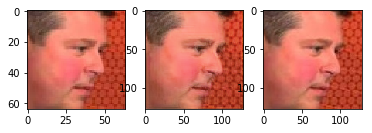

Step 9760:
    [D losses: Total=-0.025985, Wass_fake=-0.167067, Wass_real=0.132845, Wass_grad=0.008237]
    [G losses: Total=0.158642, Wass=0.153306, MSE=0.005336]


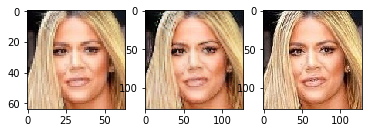

Step 9780:
    [D losses: Total=-0.032657, Wass_fake=-0.167040, Wass_real=0.130199, Wass_grad=0.004184]
    [G losses: Total=0.178769, Wass=0.173009, MSE=0.005760]


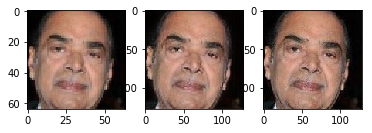

Step 9800:
    [D losses: Total=-0.041875, Wass_fake=-0.168345, Wass_real=0.123224, Wass_grad=0.003245]
    [G losses: Total=0.187223, Wass=0.180044, MSE=0.007179]


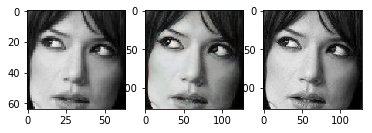

Step 9820:
    [D losses: Total=-0.031335, Wass_fake=-0.168523, Wass_real=0.125392, Wass_grad=0.011796]
    [G losses: Total=0.164109, Wass=0.158182, MSE=0.005928]


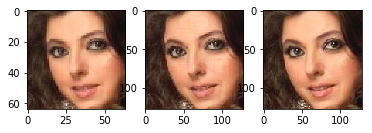

Step 9840:
    [D losses: Total=-0.037210, Wass_fake=-0.163392, Wass_real=0.123626, Wass_grad=0.002556]
    [G losses: Total=0.174057, Wass=0.167504, MSE=0.006554]


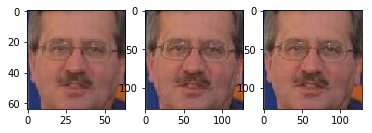

Step 9860:
    [D losses: Total=-0.030622, Wass_fake=-0.156224, Wass_real=0.122337, Wass_grad=0.003265]
    [G losses: Total=0.164920, Wass=0.159609, MSE=0.005311]


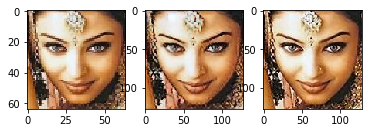

Step 9880:
    [D losses: Total=-0.048943, Wass_fake=-0.185001, Wass_real=0.135378, Wass_grad=0.000680]
    [G losses: Total=0.171811, Wass=0.164528, MSE=0.007283]


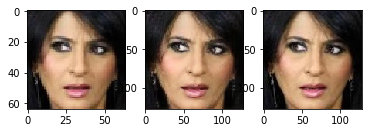

Step 9900:
    [D losses: Total=-0.029691, Wass_fake=-0.157125, Wass_real=0.126374, Wass_grad=0.001060]
    [G losses: Total=0.175086, Wass=0.168489, MSE=0.006597]


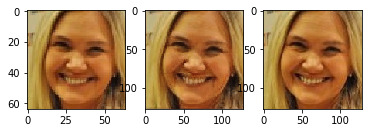

Step 9920:
    [D losses: Total=-0.037249, Wass_fake=-0.159661, Wass_real=0.121611, Wass_grad=0.000802]
    [G losses: Total=0.169563, Wass=0.163902, MSE=0.005661]


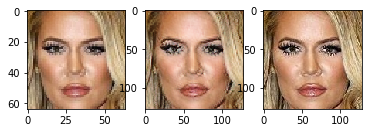

Step 9940:
    [D losses: Total=-0.038455, Wass_fake=-0.174455, Wass_real=0.134316, Wass_grad=0.001684]
    [G losses: Total=0.192368, Wass=0.182005, MSE=0.010363]


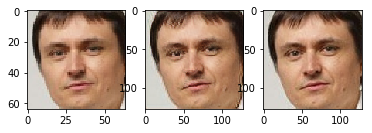

Step 9960:
    [D losses: Total=-0.044143, Wass_fake=-0.170312, Wass_real=0.124746, Wass_grad=0.001423]
    [G losses: Total=0.163243, Wass=0.155128, MSE=0.008115]


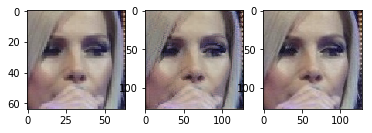

Step 9980:
    [D losses: Total=-0.034413, Wass_fake=-0.170833, Wass_real=0.133831, Wass_grad=0.002589]
    [G losses: Total=0.188535, Wass=0.180421, MSE=0.008114]


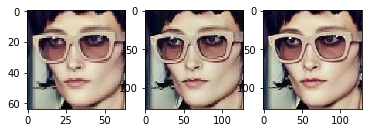

Step 10000:
    [D losses: Total=-0.027254, Wass_fake=-0.155415, Wass_real=0.121613, Wass_grad=0.006548]
    [G losses: Total=0.183260, Wass=0.177343, MSE=0.005916]


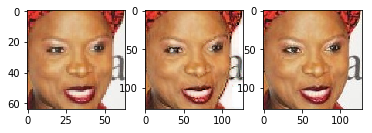

In [11]:
for step in range(1, train_steps + 1):
    ind = 1
    d = im_names[ind]
    path1 = path + dirs[ind] + "/"

    num_images = len(d)
    image_size = image_sizes[ind]
    # ---------------------
    #  Train Discriminator
    # ---------------------
    wass_weight = 100
    sample_weight_disc = [wass_weight*np.ones(batch_size)*1/(image_size**2) for ii in range(2)] + [np.ones(batch_size)]
    sample_weight_gen = [wass_weight*np.ones(batch_size)*1/(image_size**2) for ii in range(1)] + [np.ones(batch_size)]
    for train_discriminator in range(repeat_discriminator_training_n_times):

        random_idxs = np.random.randint(num_images, size=batch_size)
        imgs_to_pass_through_upscaler = load_batch(path1, d, random_idxs)
        low_res_imgs_to_pass_through_upscaler = reduce_resolution(imgs_to_pass_through_upscaler)

        random_idxs = np.random.randint(num_images, size=batch_size)
        real_imgs = load_batch(path1, d, random_idxs)
        low_res_imgs_to_pass_through_discriminator = reduce_resolution(real_imgs)

        # Train the discriminator
        d_loss = discriminator.train_on_batch( 
            x=[low_res_imgs_to_pass_through_upscaler, low_res_imgs_to_pass_through_discriminator, real_imgs], # Training data
            y=[negative_y, positive_y, dummy_y], 
            sample_weight=sample_weight_disc) # Labels
    # ---------------------
    #  Train upscaler
    # ---------------------

    random_idxs = np.random.randint(num_images, size=batch_size)
    original_imgs = load_batch(path1, d, random_idxs)
    new_low_res_imgs = reduce_resolution(original_imgs)
    
    # Train the upscaler
    g_loss = combined.train_on_batch(
        x=new_low_res_imgs, 
        y=[positive_y, original_imgs], 
        sample_weight=sample_weight_gen)
    
    if step % print_every_n_steps == 0:
        # Store metrics over time
        training_metrics['step'].append(step)
        training_metrics['d_total_loss'].append(d_loss[0])
        training_metrics['d_w_fake_loss'].append(d_loss[1])
        training_metrics['d_w_real_loss'].append(d_loss[2])
        training_metrics['d_grad_loss'].append(d_loss[3])
        training_metrics['g_total_loss'].append(g_loss[0])
        training_metrics['g_w_loss'].append(g_loss[1])
        training_metrics['g_MSE_loss'].append(g_loss[2])
        
        # Print current metrics
        if print_results:
            print("Step {}:".format(step))
            print("    [D losses: Total={:0.6f}, Wass_fake={:0.6f}, Wass_real={:0.6f}, Wass_grad={:0.6f}]".format(
                training_metrics['d_total_loss'][-1],
                training_metrics['d_w_fake_loss'][-1],
                training_metrics['d_w_real_loss'][-1],
                training_metrics['d_grad_loss'][-1]))
            print("    [G losses: Total={:0.6f}, Wass={:0.6f}, MSE={:0.6f}]".format(
                training_metrics['g_total_loss'][-1],
                training_metrics['g_w_loss'][-1],
                training_metrics['g_MSE_loss'][-1]))
        
        # Plot example low_res vs upsampling vs original
        if plot_results:
            gen_imgs = upscaler.predict(low_res_imgs_to_pass_through_discriminator)
            fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
            ax1.imshow(np.array((low_res_imgs_to_pass_through_discriminator[0, :, :, ::-1] + 1.0)*255/2, dtype=np.uint8))
            ax2.imshow(np.array((gen_imgs[0, :, :, ::-1] + 1.0)*255/2, dtype=np.uint8))
            ax3.imshow(np.array((real_imgs[0, :, :, ::-1] + 1.0)*255/2, dtype=np.uint8))
            plt.show()

In [42]:
generator.save('./models/generator_faces60000.h5')
discriminator.save('./models/discriminator_faces60000.h5')
combined.save('./models/combined_faces60000.h5')

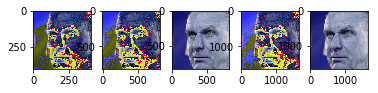

In [70]:
from PIL import Image
import PIL
n = 0
imgs3 = load_batch(path1, d, idx)
imx = Image.fromarray(np.array((imgs3[n]+1.)*255/2, dtype='uint8'))
imx2 = imx.resize((410*2, 410*2), resample=PIL.Image.BICUBIC)
imx4 = imx.resize((410*4, 410*4), resample=PIL.Image.BICUBIC)
HD = generator.predict(imgs3)
HD1 = generator.predict(np.expand_dims(HD[0], axis=0))
fig, ax = plt.subplots(1, 5)
ax[0].imshow(imgs3[n])
ax[1].imshow(HD[n])
ax[2].imshow(imx2)
ax[3].imshow(HD1[n])
ax[4].imshow(imx4)
plt.show()

In [43]:
import imageio
n=1
imageio.imwrite('./image_examples/gen_img60000.jpg', gen_imgs[n])
imageio.imwrite('./image_examples/input_img60000.jpg', noise1[n])
imageio.imwrite('./image_examples/original_img60000.jpg', imgs1[n])

C:\Users\Daniel\Anaconda3\lib\site-packages\imageio\core\util.py:104: UserWarning: Conversion from float32 to uint8, range [-0.9999971389770508, 0.9738192558288574]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
C:\Users\Daniel\Anaconda3\lib\site-packages\imageio\core\util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))


In [71]:
imageio.imwrite('./image_examples/gen_img60000x2.jpg', HD[n])
imageio.imwrite('./image_examples/input_img60000x1.jpg', imgs3[n])
imageio.imwrite('./image_examples/gen_img60000x4.jpg', HD1[n])


imageio.imwrite('./image_examples/interpolatedx2.jpg', np.array(imx2))
imageio.imwrite('./image_examples/interpolatedx4.jpg', np.array(imx4))

C:\Users\Daniel\Anaconda3\lib\site-packages\imageio\core\util.py:104: UserWarning: Conversion from float32 to uint8, range [-0.9998878240585327, 0.9832291603088379]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
C:\Users\Daniel\Anaconda3\lib\site-packages\imageio\core\util.py:104: UserWarning: Conversion from float64 to uint8, range [-1.0, 1.0]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
C:\Users\Daniel\Anaconda3\lib\site-packages\imageio\core\util.py:104: UserWarning: Conversion from float32 to uint8, range [-1.0, 0.9582899808883667]
  'range [{2}, {3}]'.format(dtype_str, out_type.__name__, mi, ma))
